# Use the v4.1 recalibrated SDSS Stripe82 catalog 
# and Gaia EDR3 catalog to produce v4.2 catalog

### 1) use Gaia's BP-RP color to generate Gaia's u-r, g-r, r-i and r-z colors and  compare them to SDSS colors

### 2) derive u-r, g-r, r-i, r-z corrections and store to ZP*dat files

### 3) read ZP*dat files and apply u-r, g-r, r-i, r-z corrections, produce v4.2 version 

In [1]:
%matplotlib inline
from astropy.table import Table
from astropy.coordinates import SkyCoord
from astropy import units as u
from astropy.table import hstack
import matplotlib.pyplot as plt 
import numpy as np
from astroML.plotting import hist
# for astroML installation see https://www.astroml.org/user_guide/installation.html

In [2]:
## automatically reload any modules read below that might have changed (e.g. plots)
%load_ext autoreload
%autoreload 2
# importing ZI tools: 
import ZItools as zit
# importing Karun's tools: 
import KTtools as ktt

<a id='dataTools'></a>

### Helper Tools

In [3]:
# both new and old files use identical data structure
colnamesSDSS = ['calib_fla', 'ra', 'dec', 'raRMS', 'decRMS', 'nEpochs', 'AR_val', 
                'u_Nobs', 'u_mMed', 'u_mMean', 'u_mErr', 'u_rms_scatt', 'u_chi2',
                'g_Nobs', 'g_mMed', 'g_mMean', 'g_mErr', 'g_rms_scatt', 'g_chi2',
                'r_Nobs', 'r_mMed', 'r_mMean', 'r_mErr', 'r_rms_scatt', 'r_chi2',
                'i_Nobs', 'i_mMed', 'i_mMean', 'i_mErr', 'i_rms_scatt', 'i_chi2',
                'z_Nobs', 'z_mMed', 'z_mMean', 'z_mErr', 'z_rms_scatt', 'z_chi2']

### code for generating new quantities, such as dra, ddec, colors, differences in mags, etc
def derivedColumns(matches):
    matches['dra'] = (matches['ra']-matches['raG'])*3600
    matches['ddec'] = (matches['dec']-matches['decG'])*3600
    ra = matches['ra'] 
    matches['raW'] = np.where(ra > 180, ra-360, ra) 
    matches['gr'] = matches['g_mMed_new'] - matches['r_mMed_new']
    matches['ri'] = matches['r_mMed_new'] - matches['i_mMed_new']
    matches['gi'] = matches['g_mMed_new'] - matches['i_mMed_new']
    matches['iz'] = matches['i_mMed_new'] - matches['z_mMed_new']
    matches['ur'] = matches['u_mMed_new'] - matches['r_mMed_new']    
    matches['rz'] = matches['r_mMed_new'] - matches['z_mMed_new']    
    # Gaia 
    matches['draGold'] = -3600*(matches['ra_old'] - matches['raG']) 
    matches['draGnew'] = -3600*(matches['ra_new'] - matches['raG']) 
    matches['ddecGold'] = -3600*(matches['dec_old'] - matches['decG']) 
    matches['ddecGnew'] = -3600*(matches['dec_new'] - matches['decG']) 
    # photometric
    matches['gGr_old'] = matches['r_mMed_old'] - matches['Gmag']
    matches['gGr_new'] = matches['r_mMed_new'] - matches['Gmag']
    return

In [4]:
def doOneColorGaiaBR(d, kw):
    print('=========== WORKING ON:', kw['Ystr'], '===================')
    xVec = d[kw['Xstr']]
    yVec = d[kw['Ystr']]
    # 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 52, 0)
    fig,ax = plt.subplots(1,1,figsize=(8,6))
    ax.scatter(xVec, yVec, s=0.01, c='blue')
    ax.scatter(xBin, medianBin, s=5.2, c='yellow')
    ax.set_xlim(0.4,3.2)
    ax.set_ylim(-0.5,4.5)
    ax.set_xlabel(kw['Xstr'])
    ax.set_ylabel(kw['Ystr'])
    d['colorfit'] = np.interp(xVec, xBin, medianBin)
    d['colorresid'] = d[kw['Ystr']] - d['colorfit'] 
    goodC = d[np.abs(d['colorresid'])<0.3]
    
    ### plots 
    # RA
    print(' stats for RA binning medians:')
    plotNameRoot = kw['plotNameRoot'] + kw['Ystr']
    plotName = plotNameRoot + '_RA.png'
    Ylabel =kw['Ystr'] + ' residuals'
    kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_RA_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)  
    print('made plot', plotName)

    # Dec
    print('-----------')
    print(' stats for Dec binning medians:')
    plotName = plotNameRoot + '_Dec.png'
    kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Dec_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)

    # r SDSS
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_rmag.png'    
    kwOC = {"Xstr":'r_mMed_new', "Xmin":14.3, "Xmax":22.2, "Xlabel":'SDSS r (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_rmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    
    # Gaia G
    print('-----------')
    print(' stats for SDSS r binning medians:')
    plotName = plotNameRoot + '_Gmag.png'    
    kwOC = {"Xstr":'Gmag', "Xmin":14.3, "Xmax":22.2, "Xlabel":'Gaia G (mag)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":14.5, "XmaxBin":21.5, "nBin":55, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":kw['symbSize']}
    zit.plotdelMag(goodC, kwOC)
    plotName = plotNameRoot + '_Gmag_Hess.png'    
    kwOC["plotName"] = plotName
    kwOC["nBinX"] = 55
    kwOC["nBinY"] = 25
    kwOC["cmap"] = 'plasma'
    ktt.plotdelMagBW_KT(goodC, kwOC)
    print('made plot', plotName)
    print('------------------------------------------------------------------')
    

<a id='dataReading'></a>

### Define paths and catalogs 

In [5]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
# the original SDSS catalog from 2007
sdssOldCat = ZIdataDir + "/" + "stripe82calibStars_v2.6.dat"
# new catalog from 2020, after Gmag-based gray corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.1_noheader_final.dat"
# Gaia EDR3 with BP and RP data
GaiaEDR3CatBR = ZIdataDir + "/" + "Stripe82_GaiaEDR3_BPRP.dat" 

In [6]:
%%time
# old
sdssOld = Table.read(sdssOldCat, format='ascii', names=colnamesSDSS) 
np.size(sdssOld)

CPU times: user 22.4 s, sys: 3.66 s, total: 26.1 s
Wall time: 25.3 s


1006849

In [7]:
%%time
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

CPU times: user 45.9 s, sys: 6.06 s, total: 52 s
Wall time: 51.1 s


991472

In [8]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [9]:
colnamesGaia = ['ra', 'dec', 'nObs', 'Gmag', 'flux', 'fluxErr', 'pmra', 'pmdec']
colnamesGaia = colnamesGaia + ['BPmag', 'BPeI', 'RPmag', 'RPeI', 'BRef']
gaia = Table.read(GaiaEDR3CatBR, format='ascii', names=colnamesGaia)
gaia['raG'] = gaia['ra']
gaia['decG'] = gaia['dec']    
gaia['BR'] = gaia['BPmag'] - gaia['RPmag'] 

In [10]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [11]:
derivedColumns(gaia_sdss)

In [12]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

In [13]:
matchesBlue = matches[(matches['gi']>0.4)&(matches['gi']<2.0)&(matches['Gmag']<20.0)]
print(np.size(matches), np.size(matchesBlue))

905428 397175


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.013284063339234597 std.dev: 0.01357354965535871
saved plot as: colorResidGaiaColors_ur_RA.png


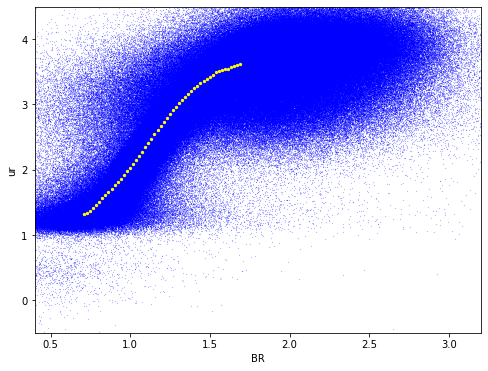

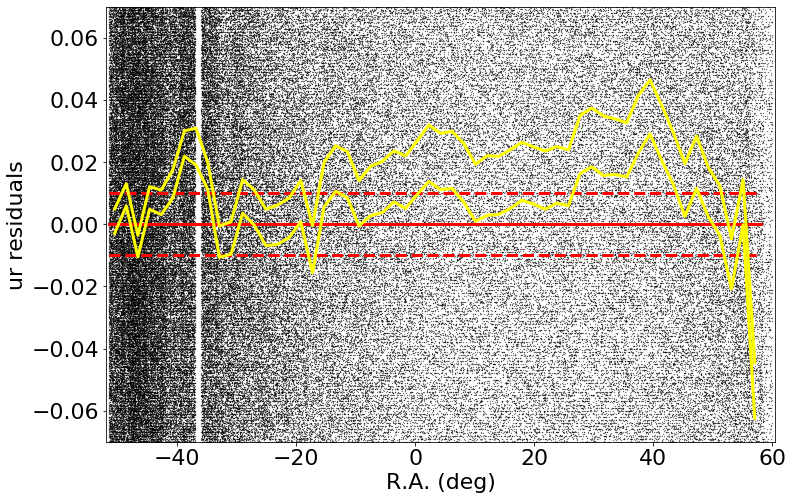

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.01429254608154329 std.dev: 0.013548827801766836
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


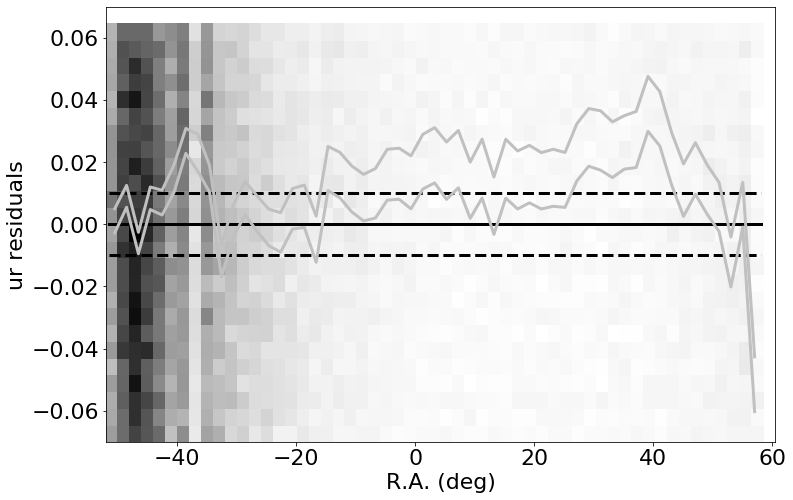

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.010800204467773078 std.dev: 0.01162182366807504
saved plot as: colorResidGaiaColors_ur_Dec.png


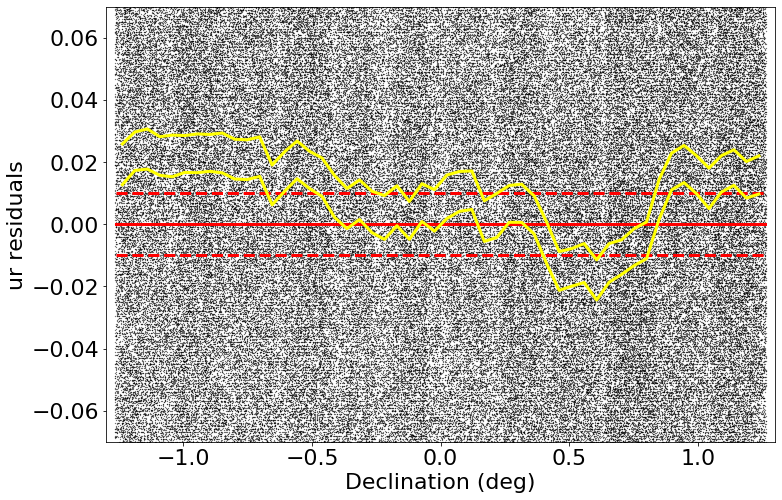

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009848024749757434 std.dev: 0.011915617990370483
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


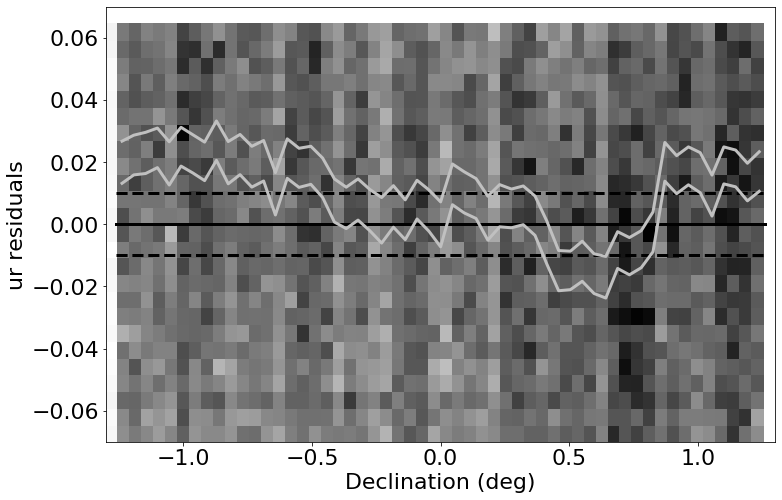

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0032144226074231064 std.dev: 0.053181324984204706
saved plot as: colorResidGaiaColors_ur_rmag.png


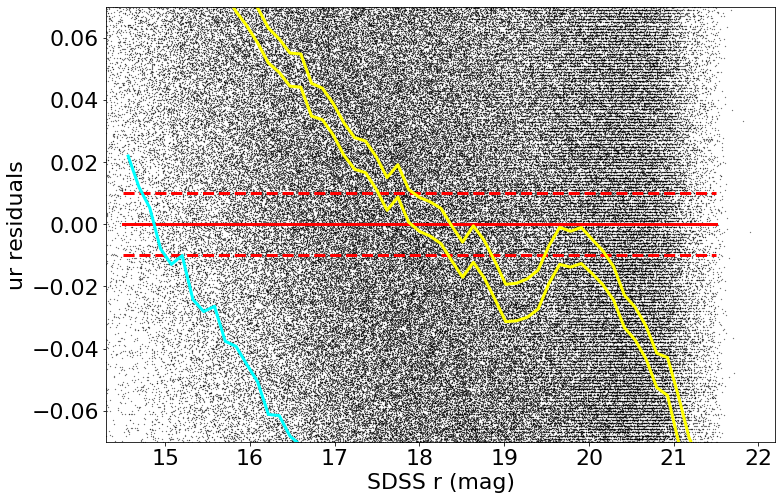

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0032144226074231064 std.dev: 0.053181324984204706
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


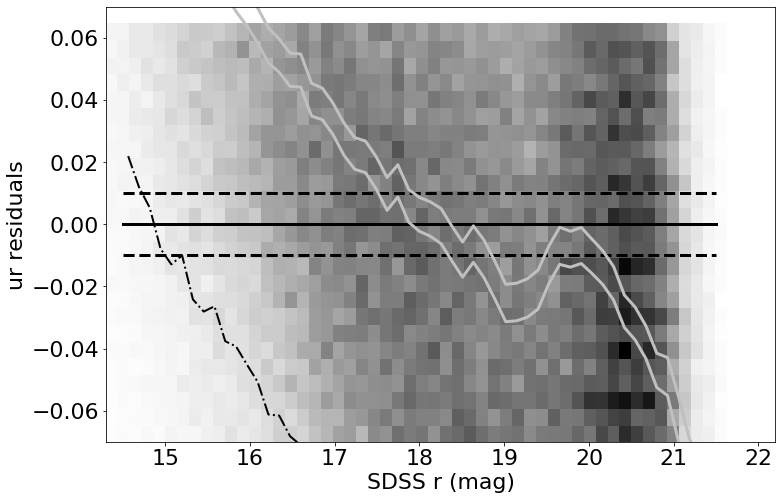

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009690533447263672 std.dev: 0.054437261441730944
saved plot as: colorResidGaiaColors_ur_Gmag.png


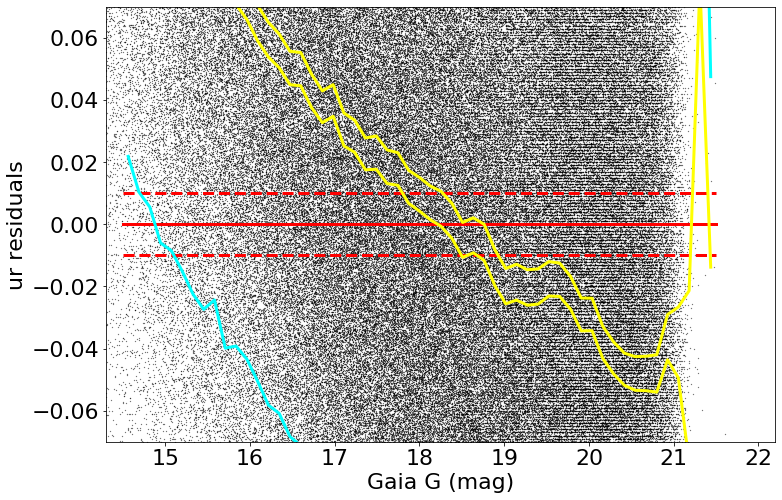

medianAll: 0.009114807128905333 std.dev.All: 0.170944141113283
N= 544525 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.009690533447263672 std.dev: 0.054437261441730944
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


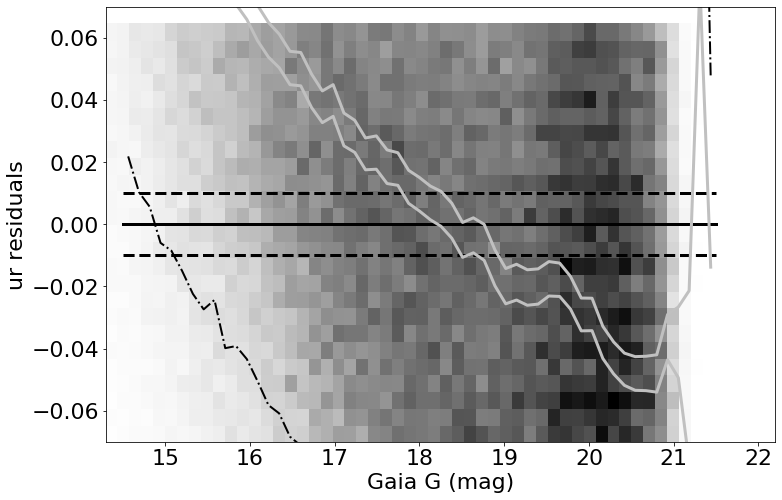

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.02297813262939416 std.dev: 0.009095451923870379
saved plot as: colorResidGaiaColors_gr_RA.png


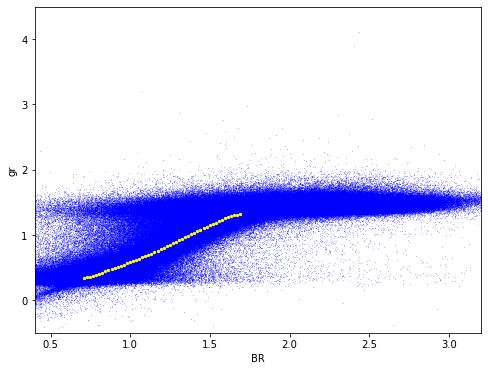

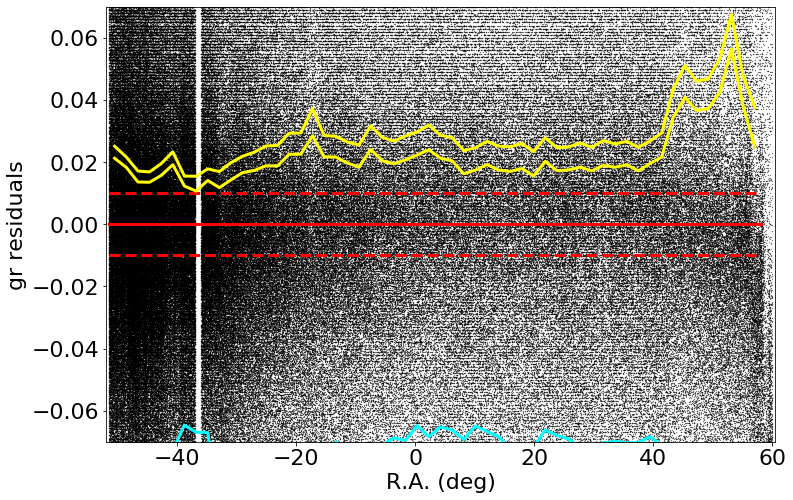

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.022633489990234013 std.dev: 0.009038793748459407
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


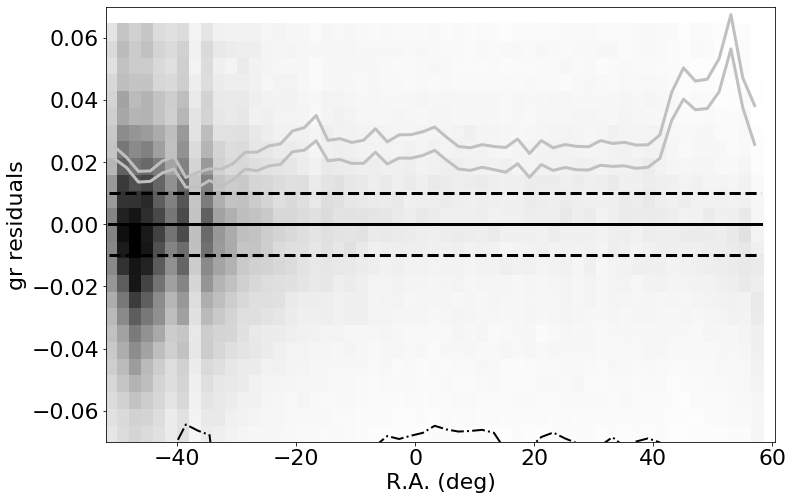

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.02087662200927448 std.dev: 0.003838492832428057
saved plot as: colorResidGaiaColors_gr_Dec.png


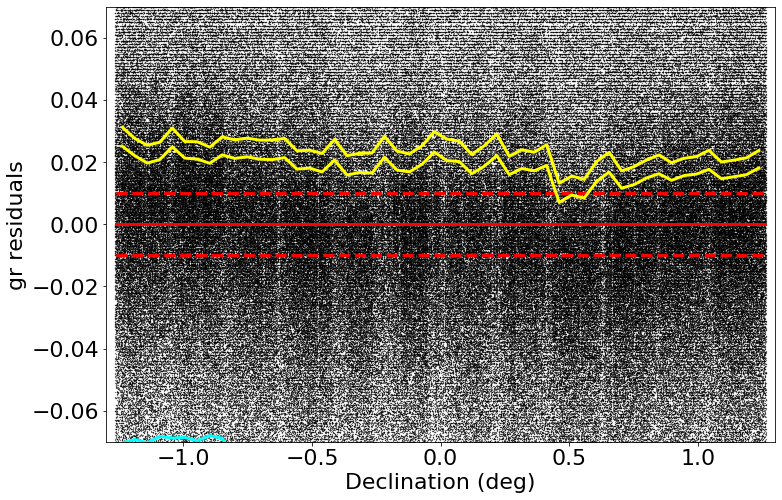

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.020999999999997243 std.dev: 0.0038981250127695633
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


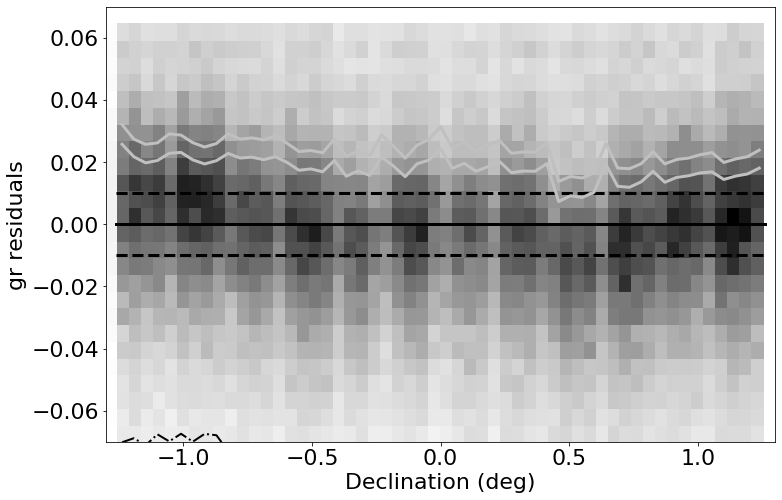

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.0025371398925785327 std.dev: 0.0435879884635516
saved plot as: colorResidGaiaColors_gr_rmag.png


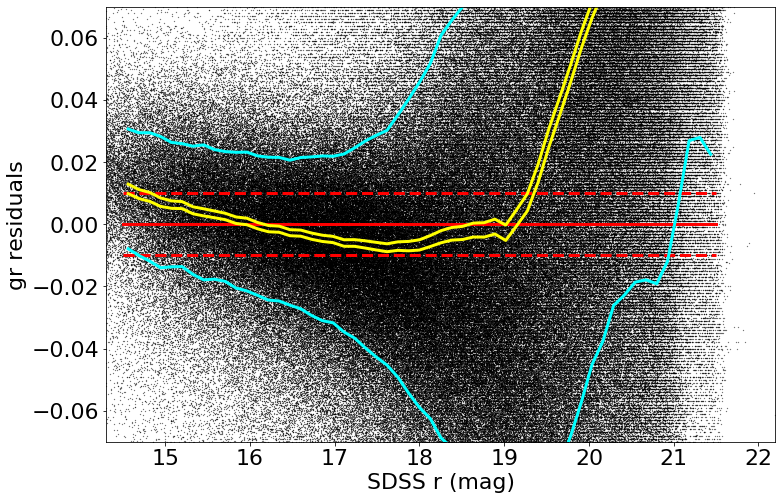

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.0025371398925785327 std.dev: 0.0435879884635516
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


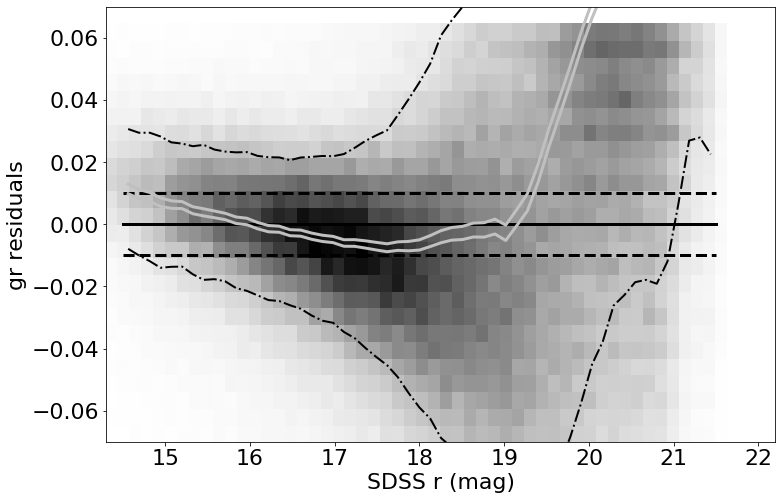

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.005265164184570903 std.dev: 0.03456813377661558
saved plot as: colorResidGaiaColors_gr_Gmag.png


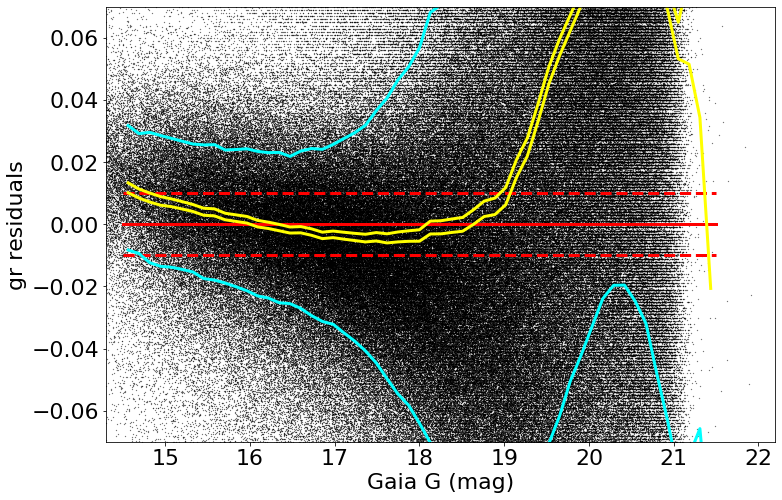

medianAll: 0.020999999999997243 std.dev.All: 0.10020981159667564
N= 821605 min= -0.2999593856811553 max= 0.29999999999999716
median: 0.005265164184570903 std.dev: 0.03456813377661558
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


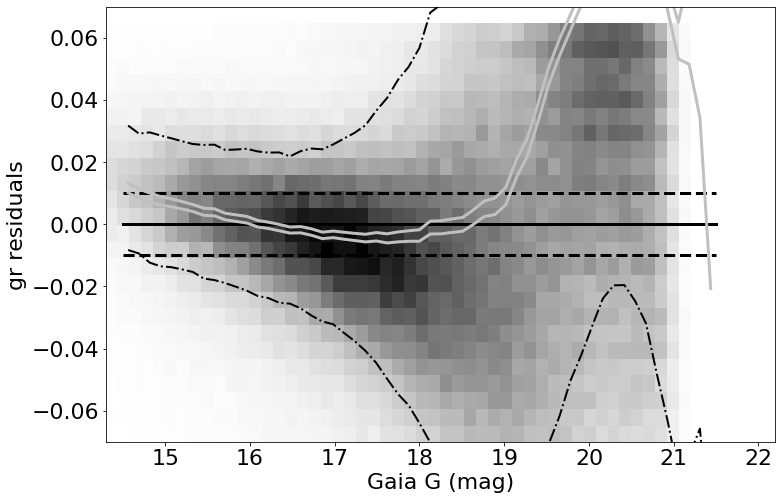

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0018645217895516472 std.dev: 0.00474672820113338
saved plot as: colorResidGaiaColors_ri_RA.png


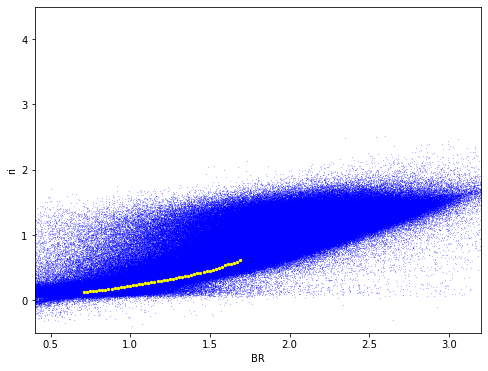

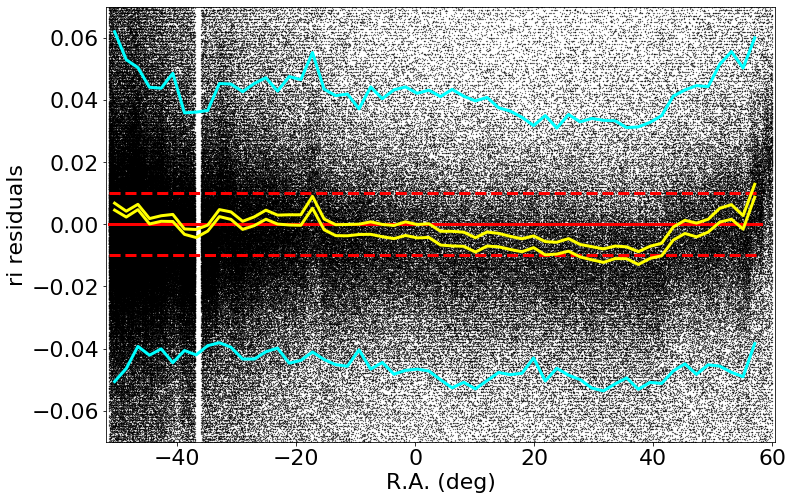

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0019999999999988916 std.dev: 0.004737066184872442
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


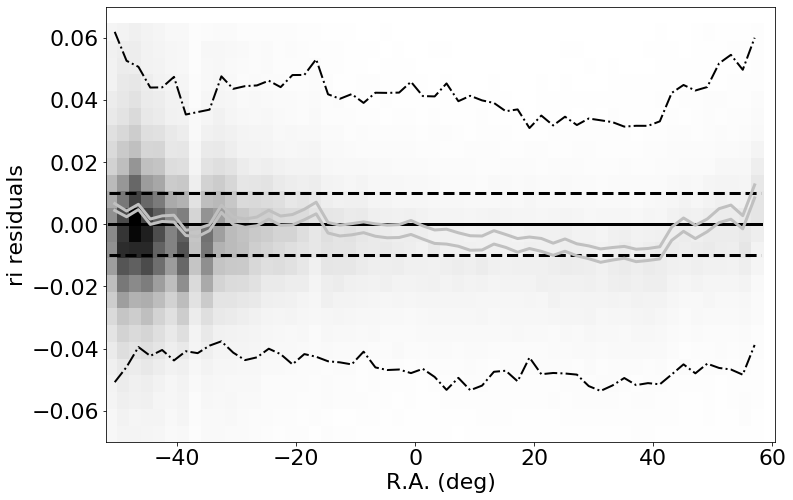

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.0015473506927493053 std.dev: 0.003329667885308621
saved plot as: colorResidGaiaColors_ri_Dec.png


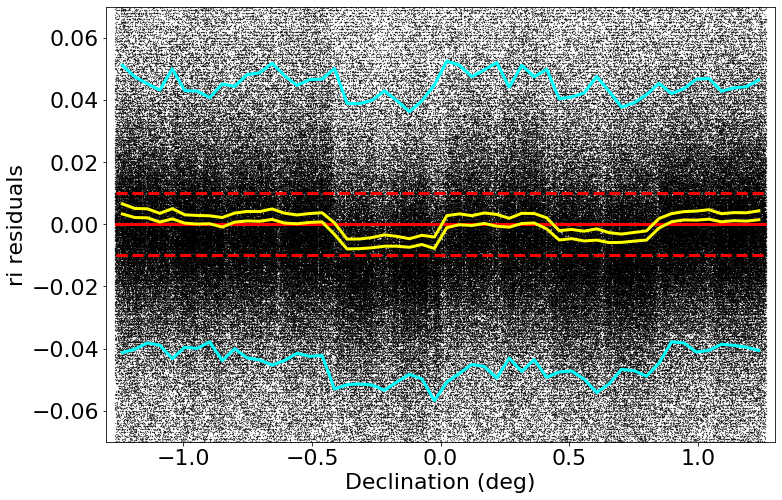

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: 0.001559720611573584 std.dev: 0.003330874508200132
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


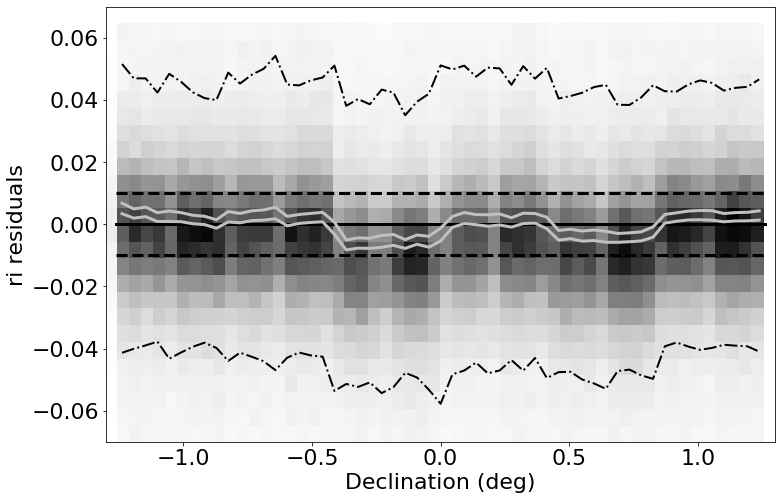

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0036271469116193333 std.dev: 0.04921206381428205
saved plot as: colorResidGaiaColors_ri_rmag.png


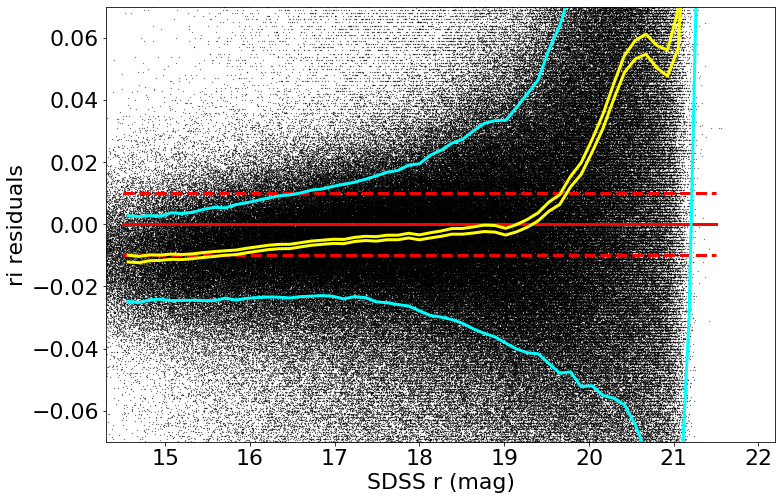

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0036271469116193333 std.dev: 0.04921206381428205
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


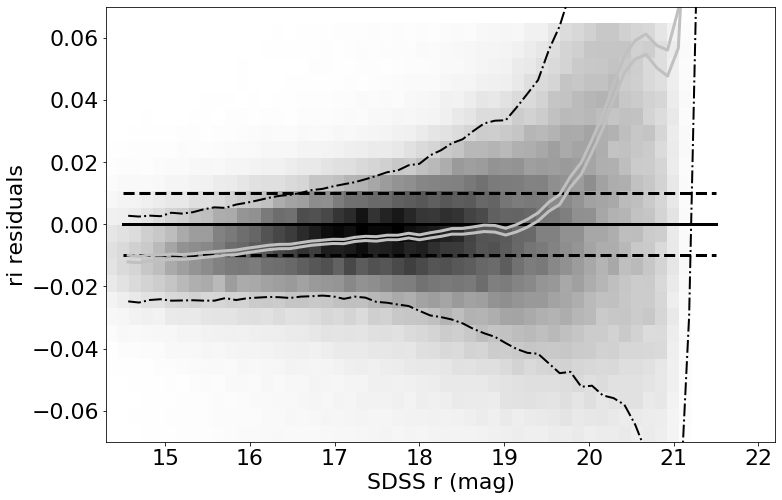

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0035816154480000917 std.dev: 0.02138013554505804
saved plot as: colorResidGaiaColors_ri_Gmag.png


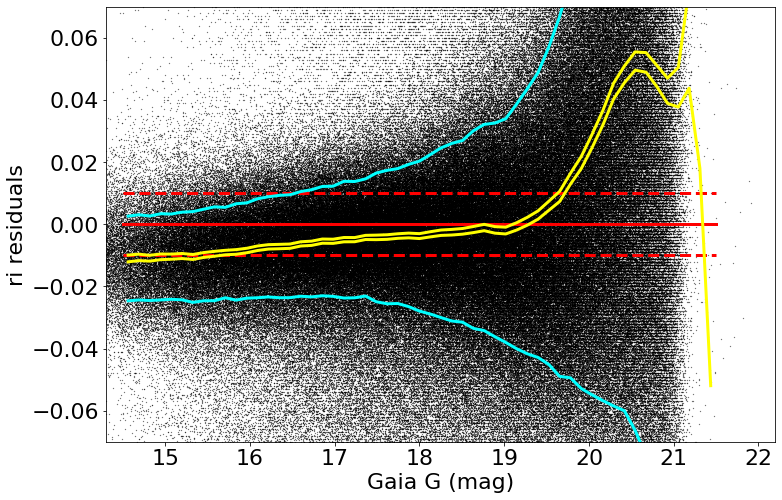

medianAll: 0.0001469894409191208 std.dev.All: 0.04514915397033663
N= 640299 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0035816154480000917 std.dev: 0.02138013554505804
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


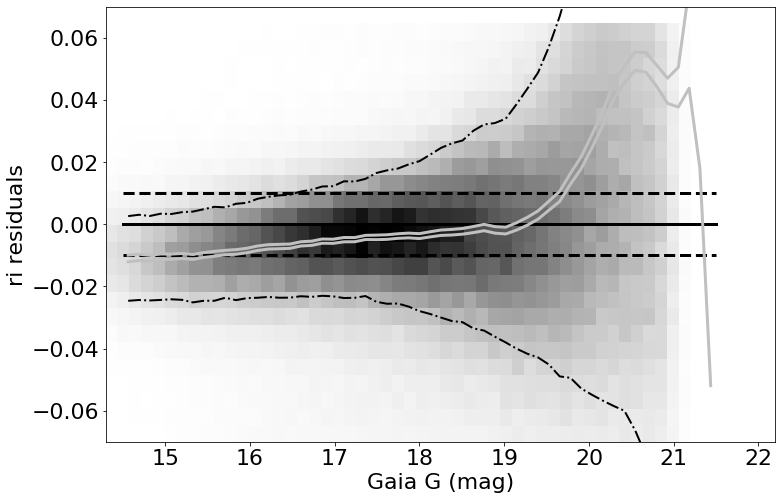

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008069349288942824 std.dev: 0.008405460025542757
saved plot as: colorResidGaiaColors_rz_RA.png


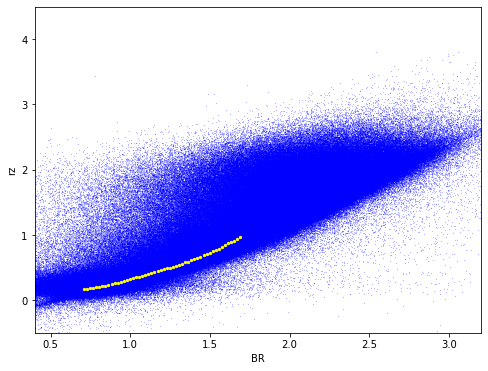

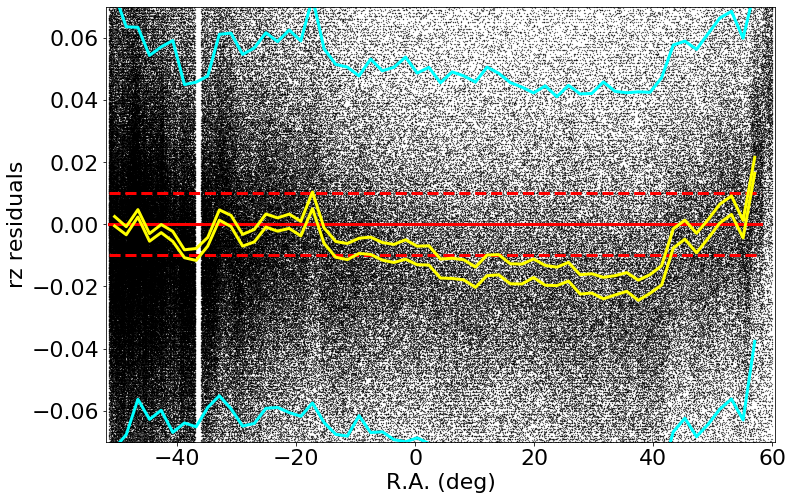

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.007736273193358317 std.dev: 0.008412853995260759
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


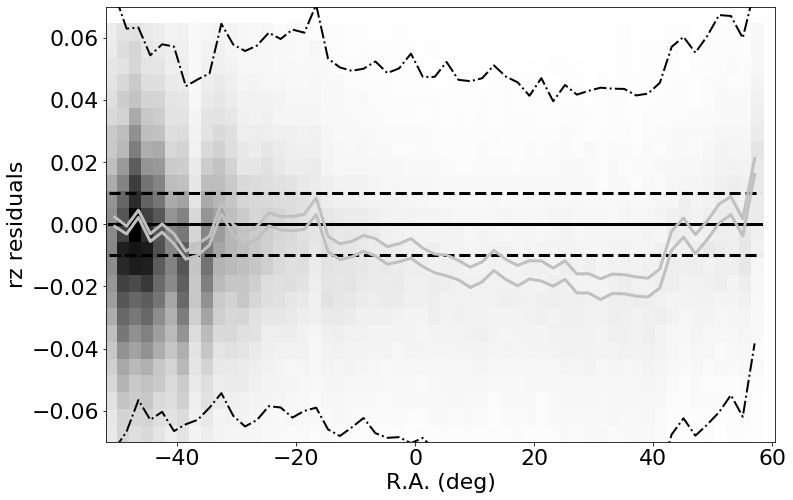

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00511232261657775 std.dev: 0.003183659061814311
saved plot as: colorResidGaiaColors_rz_Dec.png


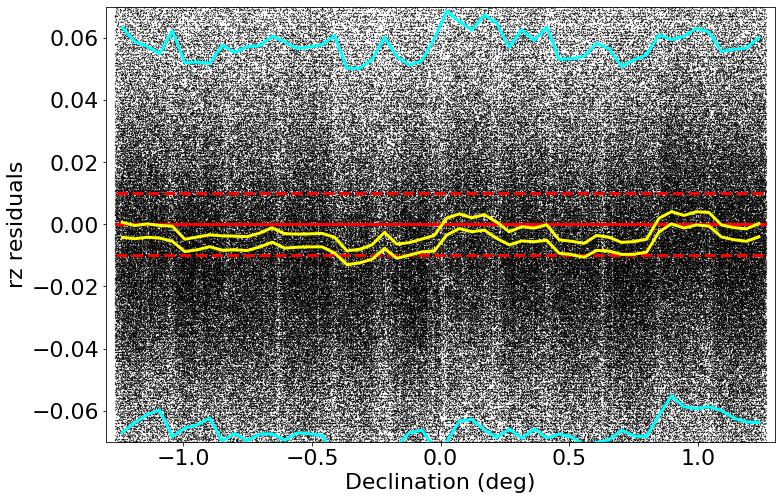

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.0049065986633300696 std.dev: 0.003149149544410354
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


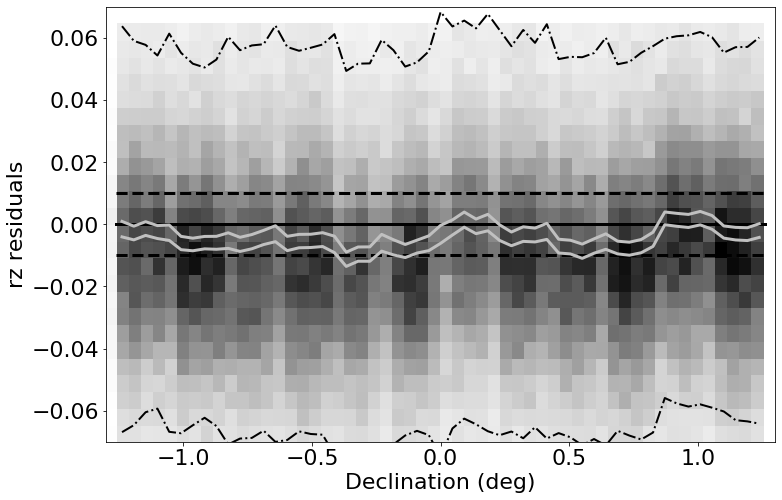

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00804257659911968 std.dev: 0.0507339157704549
saved plot as: colorResidGaiaColors_rz_rmag.png


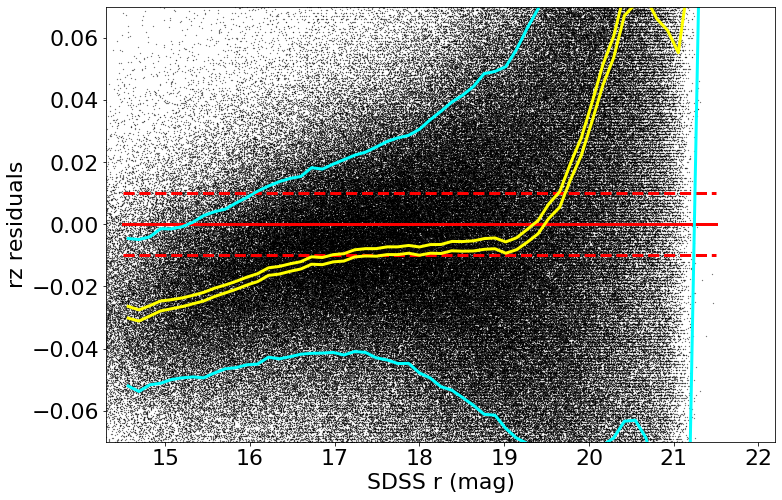

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.00804257659911968 std.dev: 0.0507339157704549
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


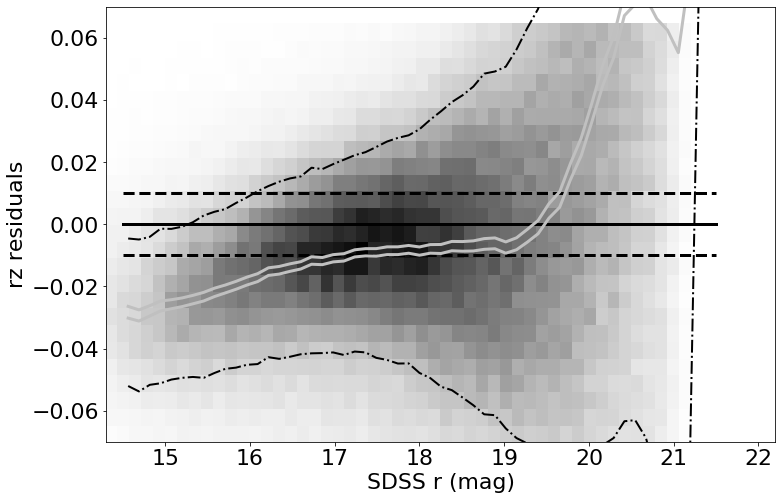

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008055117797853062 std.dev: 0.03064511185412417
saved plot as: colorResidGaiaColors_rz_Gmag.png


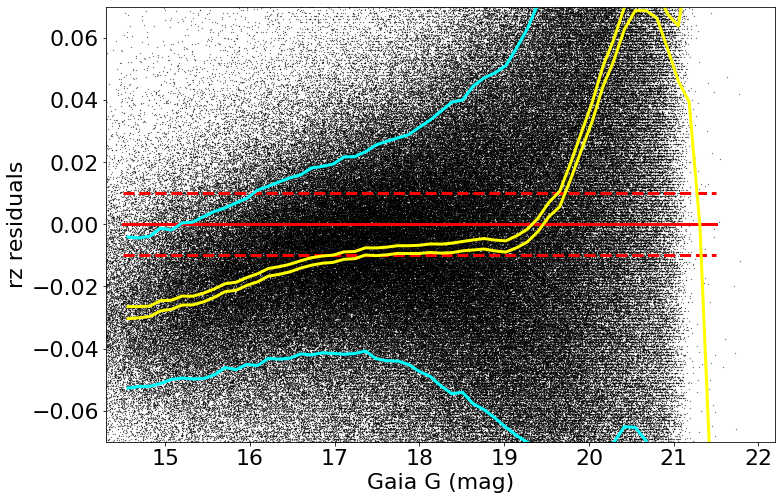

medianAll: -0.004284152984616568 std.dev.All: 0.061953993691633805
N= 585444 min= -0.2999887542724608 max= 0.29999999999999893
median: -0.008055117797853062 std.dev: 0.03064511185412417
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


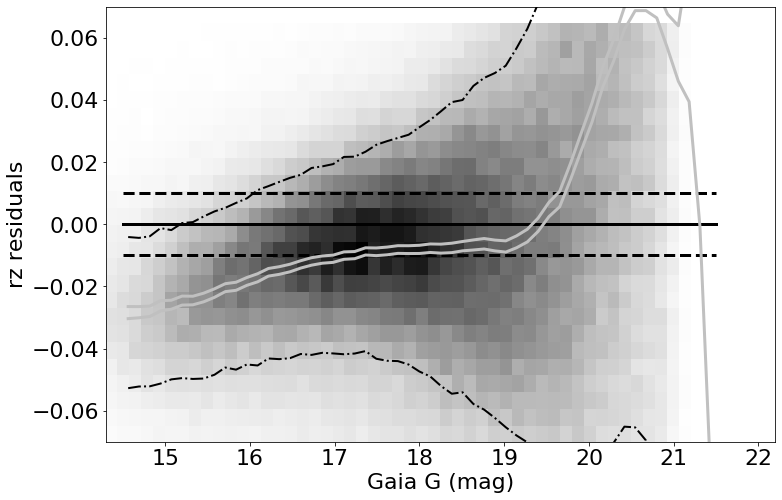

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [14]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [15]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesBu = matchesB[(matchesB['u_mMed_new']<20)]
print(np.size(matches), np.size(matchesB), np.size(matchesBu))

905428 307495 114707


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: 0.007576591491700035 std.dev: 0.029366001079963917
saved plot as: colorResidGaiaColorsB_ur_RA.png


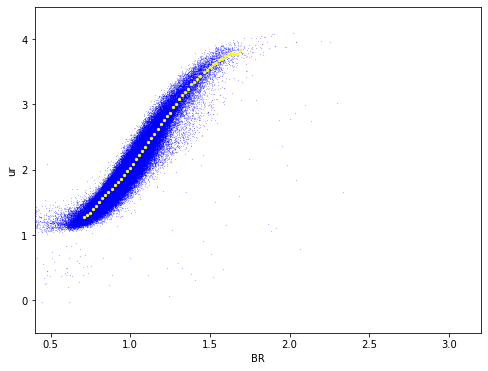

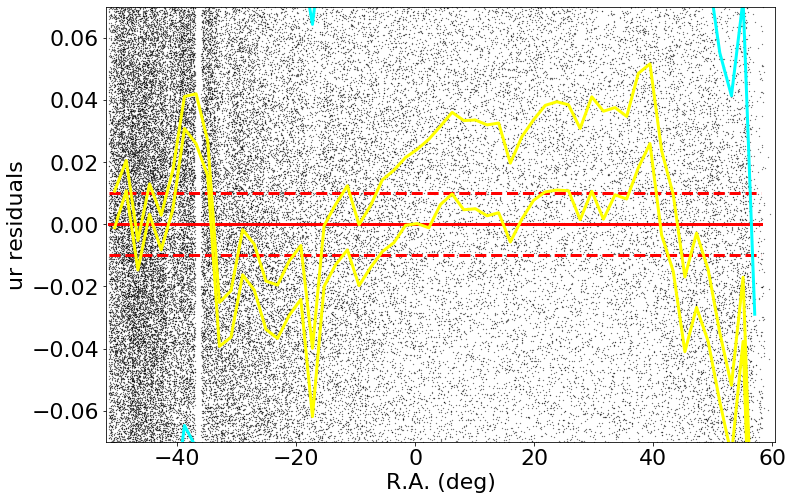

medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: 0.00990246887207169 std.dev: 0.029383399771585814
saved plot as: colorResidGaiaColorsB_ur_RA_Hess.png


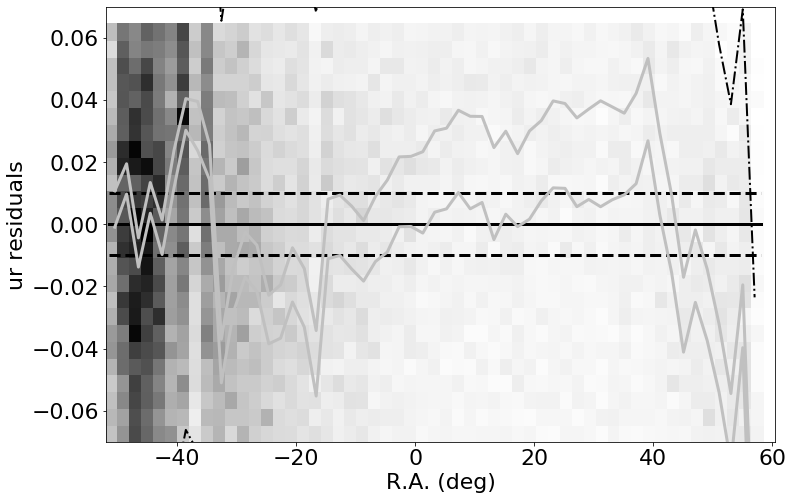

made plot colorResidGaiaColorsB_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: 0.0030645683288584302 std.dev: 0.016475497576502452
saved plot as: colorResidGaiaColorsB_ur_Dec.png


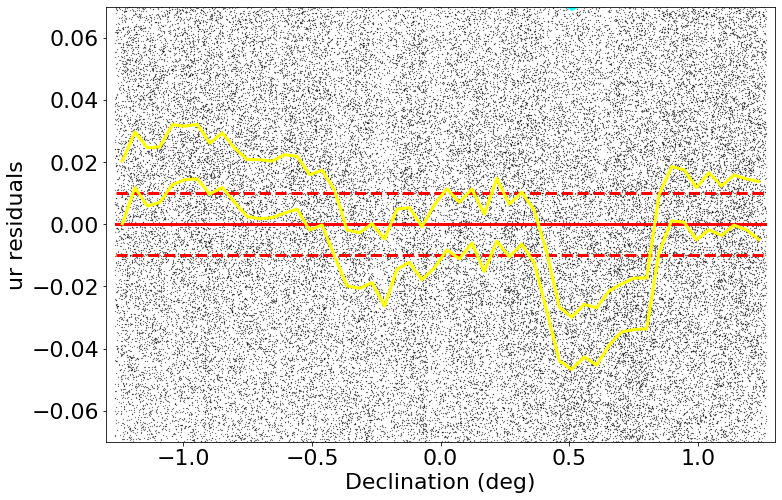

medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: 0.00294398269653362 std.dev: 0.016575444563408648
saved plot as: colorResidGaiaColorsB_ur_Dec_Hess.png


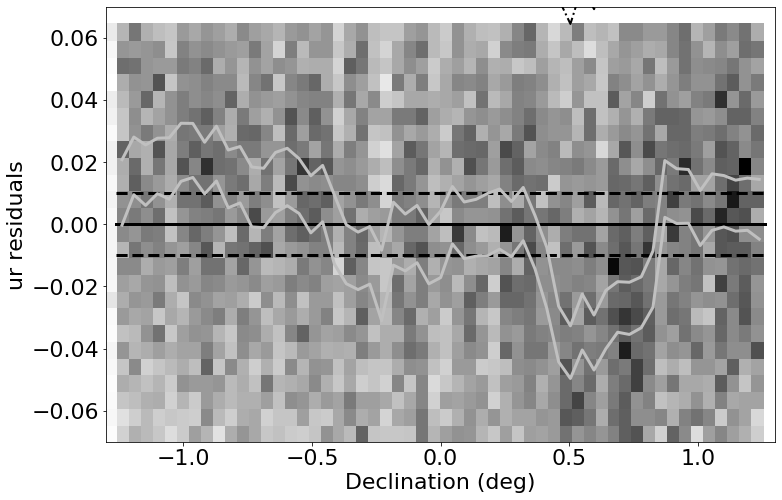

made plot colorResidGaiaColorsB_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: -0.002906052398681358 std.dev: 0.0824050089242157
saved plot as: colorResidGaiaColorsB_ur_rmag.png


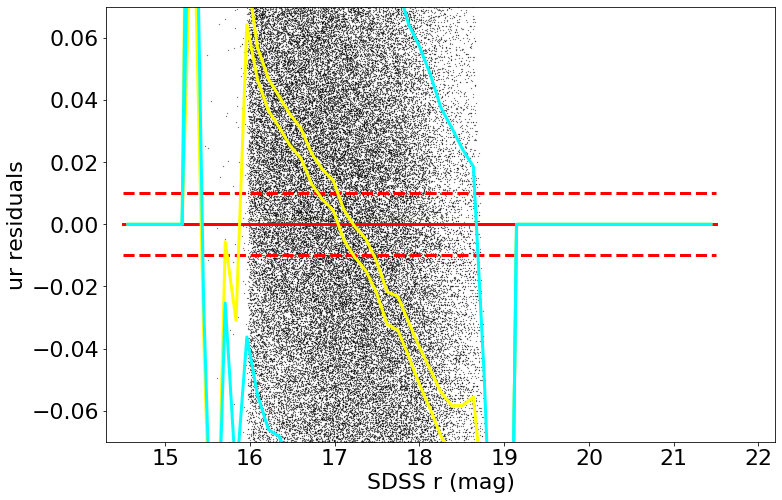

medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: -0.002906052398681358 std.dev: 0.0824050089242157
saved plot as: colorResidGaiaColorsB_ur_rmag_Hess.png


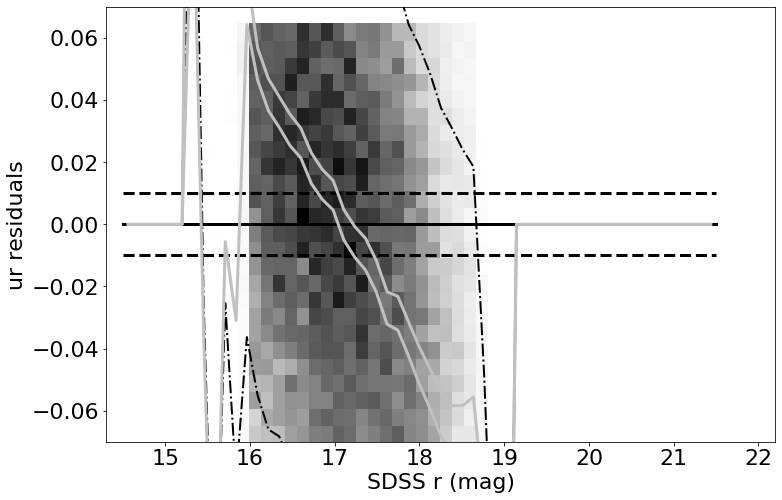

made plot colorResidGaiaColorsB_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: -0.010376441955565197 std.dev: 0.05274365346009364
saved plot as: colorResidGaiaColorsB_ur_Gmag.png


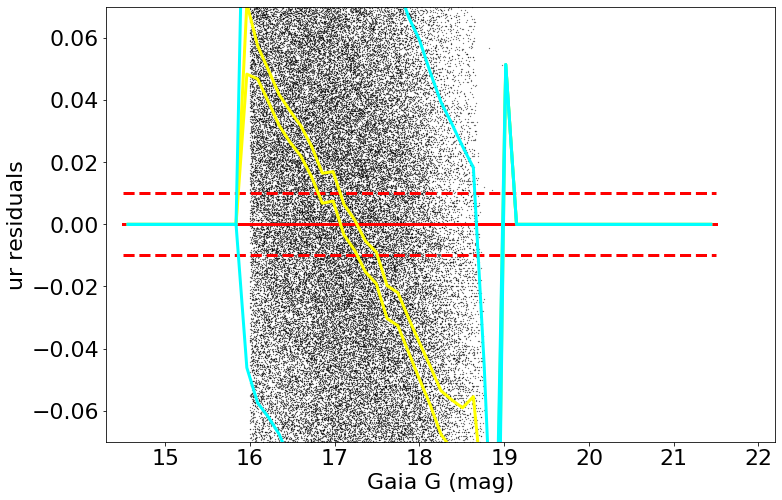

medianAll: -0.0005567642211954382 std.dev.All: 0.11063386776580698
N= 109669 min= -0.2999807739257798 max= 0.29998792724609213
median: -0.010376441955565197 std.dev: 0.05274365346009364
saved plot as: colorResidGaiaColorsB_ur_Gmag_Hess.png


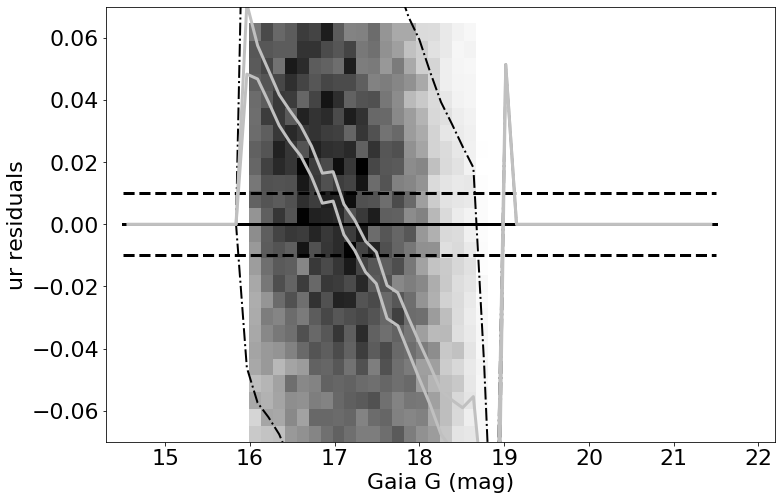

made plot colorResidGaiaColorsB_ur_Gmag_Hess.png
------------------------------------------------------------------


In [16]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
color = 'ur' 
keywords["Ystr"] = color 
doOneColorGaiaBR(matchesBu, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.017455947494506824 std.dev: 0.007407988287316392
saved plot as: colorResidGaiaColorsB_gr_RA.png


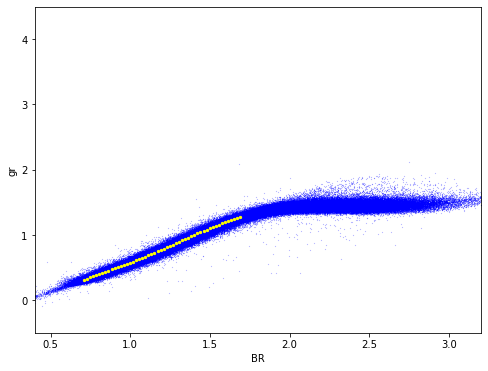

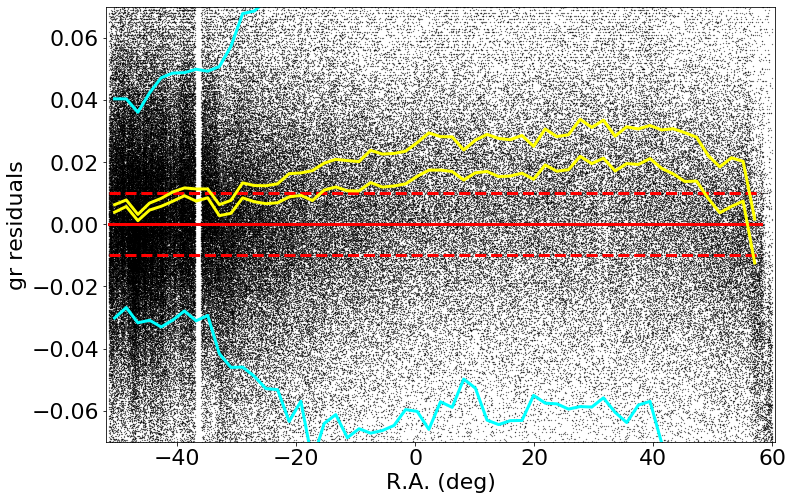

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.017099519348144576 std.dev: 0.0073210721884000695
saved plot as: colorResidGaiaColorsB_gr_RA_Hess.png


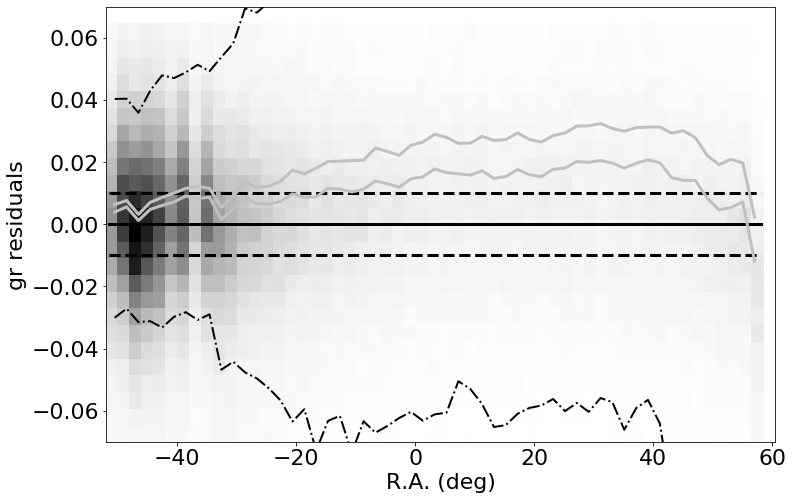

made plot colorResidGaiaColorsB_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010983567428588331 std.dev: 0.0040450793172982355
saved plot as: colorResidGaiaColorsB_gr_Dec.png


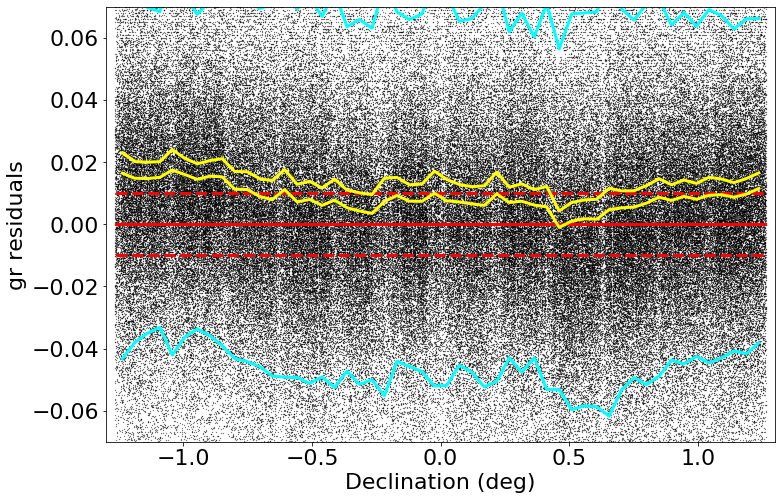

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.01089451904296937 std.dev: 0.004009478622194799
saved plot as: colorResidGaiaColorsB_gr_Dec_Hess.png


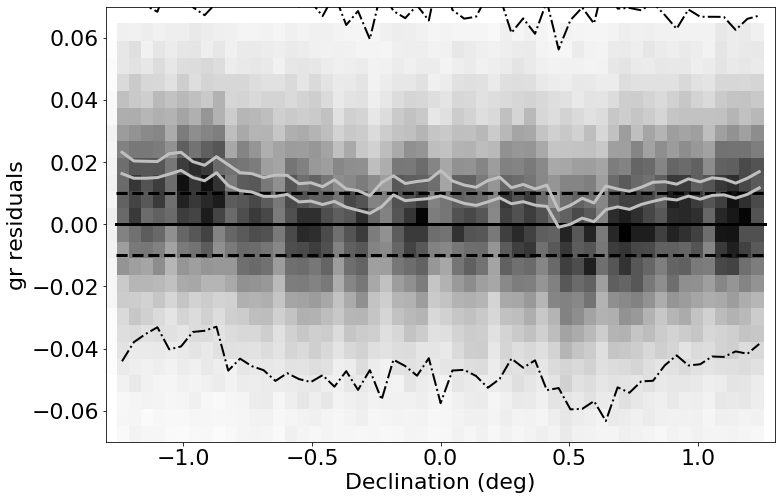

made plot colorResidGaiaColorsB_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.011223139190673734 std.dev: 0.09006422098695906
saved plot as: colorResidGaiaColorsB_gr_rmag.png


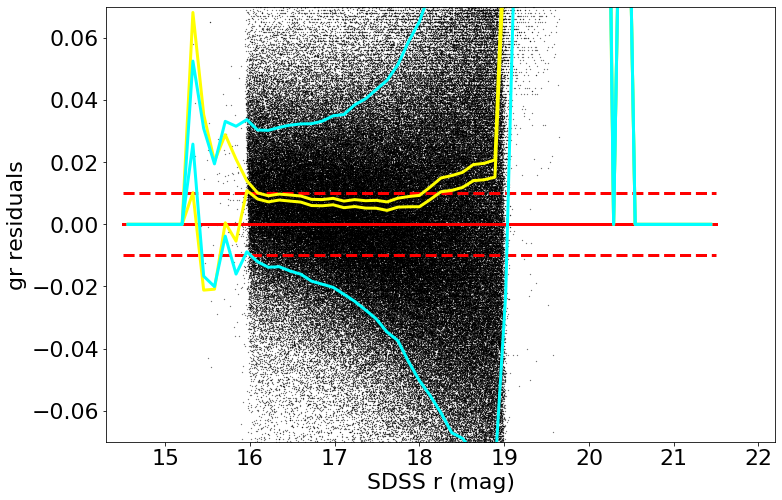

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.011223139190673734 std.dev: 0.09006422098695906
saved plot as: colorResidGaiaColorsB_gr_rmag_Hess.png


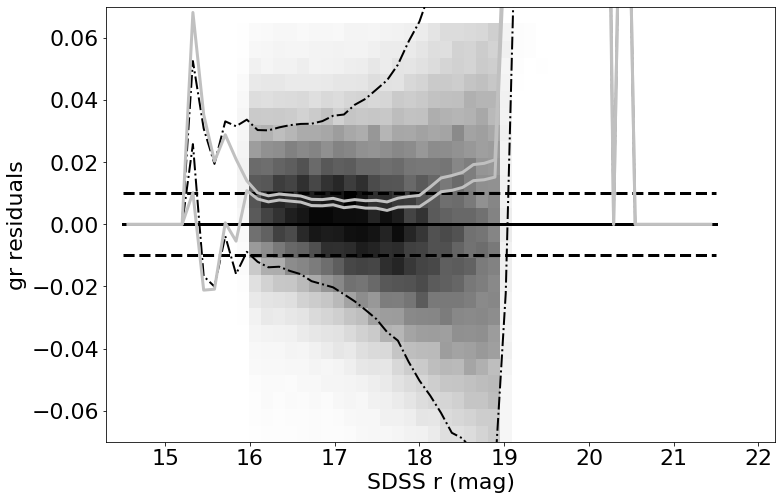

made plot colorResidGaiaColorsB_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010083191680907433 std.dev: 0.0055988243011782625
saved plot as: colorResidGaiaColorsB_gr_Gmag.png


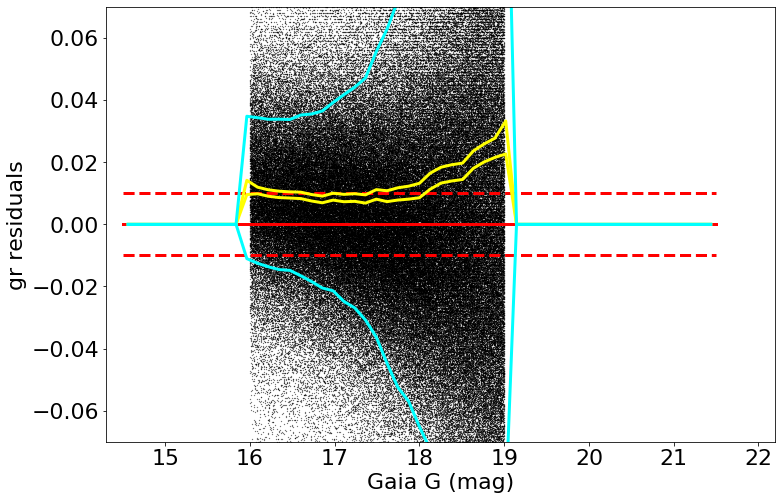

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010083191680907433 std.dev: 0.0055988243011782625
saved plot as: colorResidGaiaColorsB_gr_Gmag_Hess.png


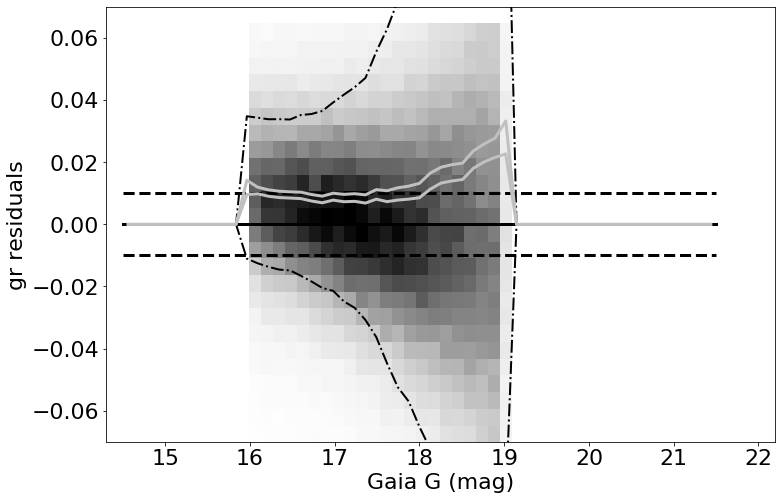

made plot colorResidGaiaColorsB_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002517384719849143 std.dev: 0.0025978907812433515
saved plot as: colorResidGaiaColorsB_ri_RA.png


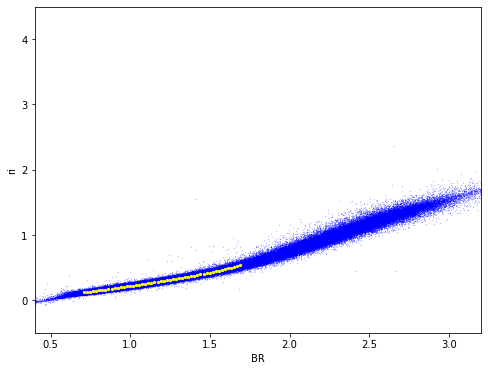

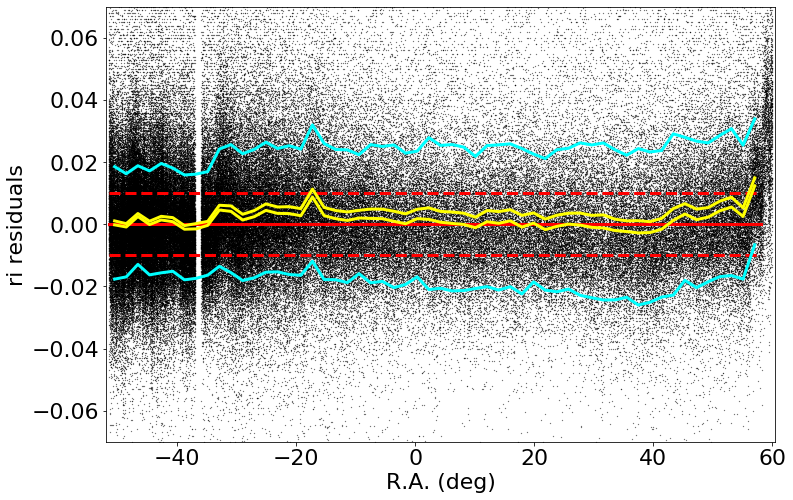

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0025639114379862465 std.dev: 0.002561481115851691
saved plot as: colorResidGaiaColorsB_ri_RA_Hess.png


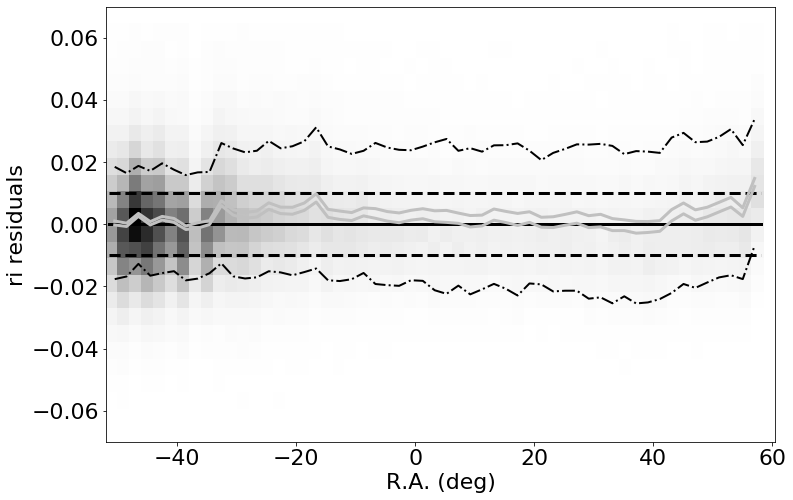

made plot colorResidGaiaColorsB_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0030549987792942435 std.dev: 0.003120953981955027
saved plot as: colorResidGaiaColorsB_ri_Dec.png


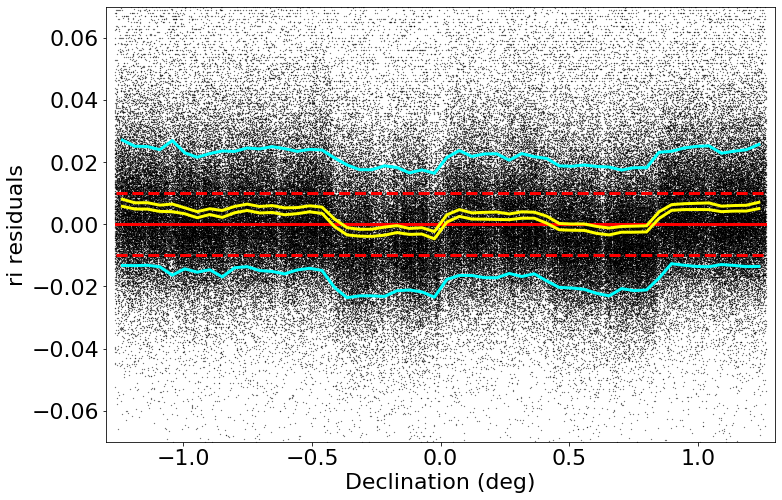

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0032858955383308214 std.dev: 0.003119921626873285
saved plot as: colorResidGaiaColorsB_ri_Dec_Hess.png


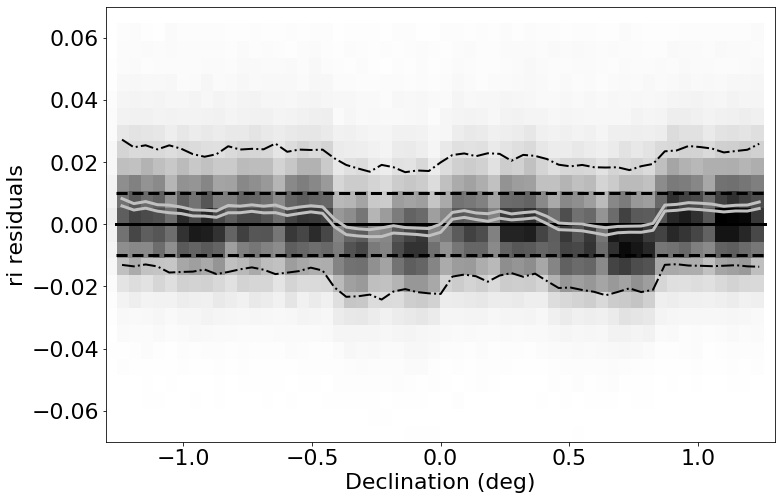

made plot colorResidGaiaColorsB_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002233013916016241 std.dev: 0.07031689436466795
saved plot as: colorResidGaiaColorsB_ri_rmag.png


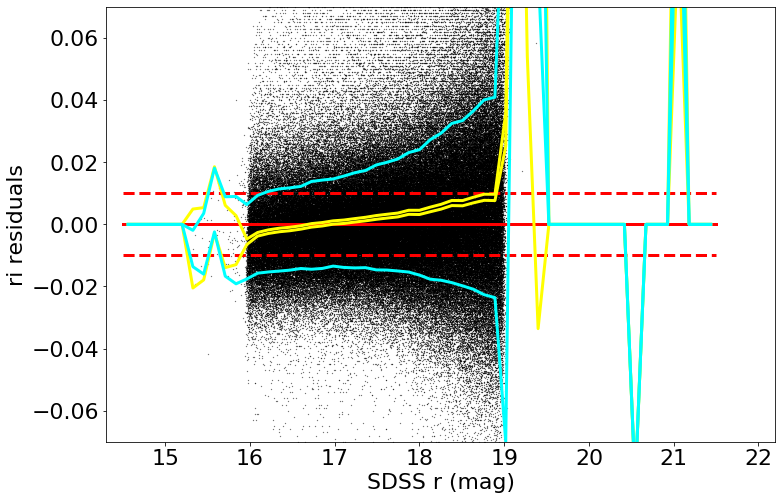

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002233013916016241 std.dev: 0.07031689436466795
saved plot as: colorResidGaiaColorsB_ri_rmag_Hess.png


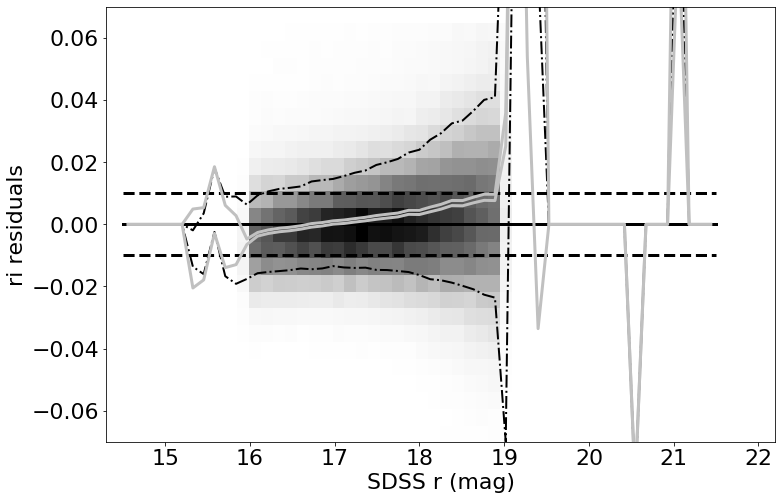

made plot colorResidGaiaColorsB_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0023762168884268187 std.dev: 0.0036533489445314937
saved plot as: colorResidGaiaColorsB_ri_Gmag.png


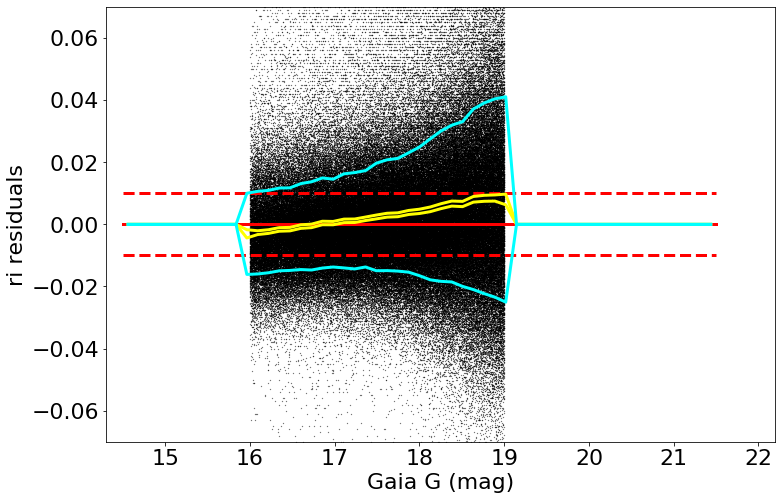

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0023762168884268187 std.dev: 0.0036533489445314937
saved plot as: colorResidGaiaColorsB_ri_Gmag_Hess.png


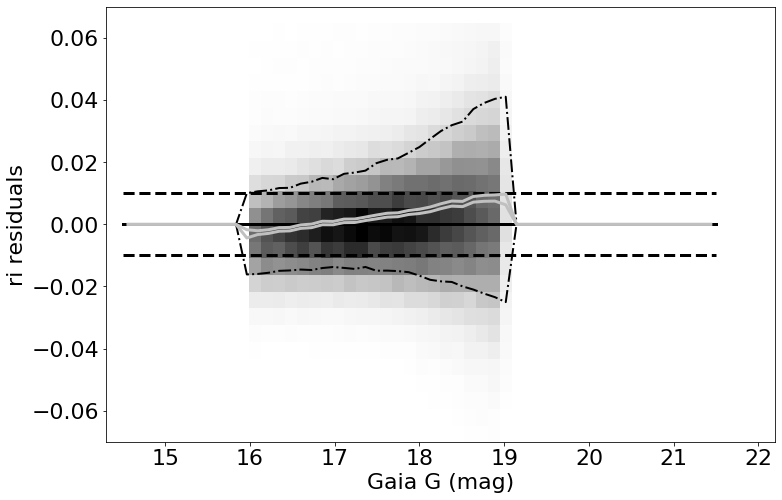

made plot colorResidGaiaColorsB_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0013426254272465299 std.dev: 0.006753015523284264
saved plot as: colorResidGaiaColorsB_rz_RA.png


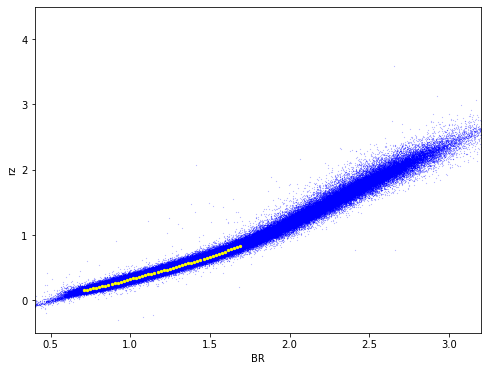

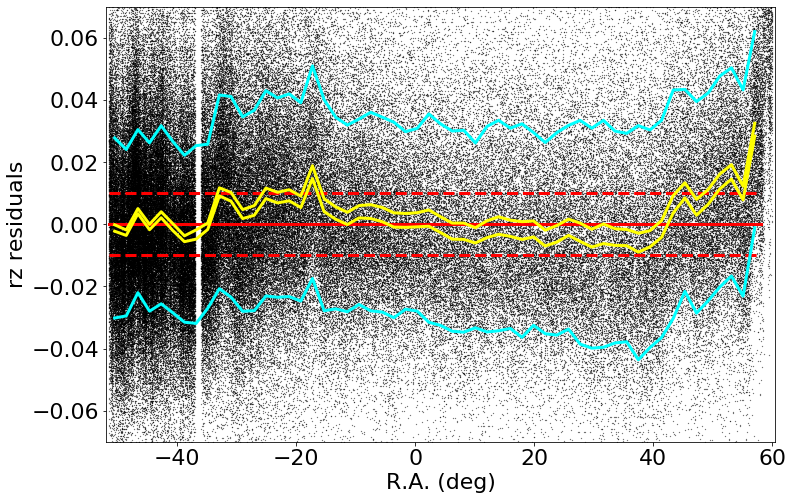

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0009999999999994458 std.dev: 0.0067560199470467095
saved plot as: colorResidGaiaColorsB_rz_RA_Hess.png


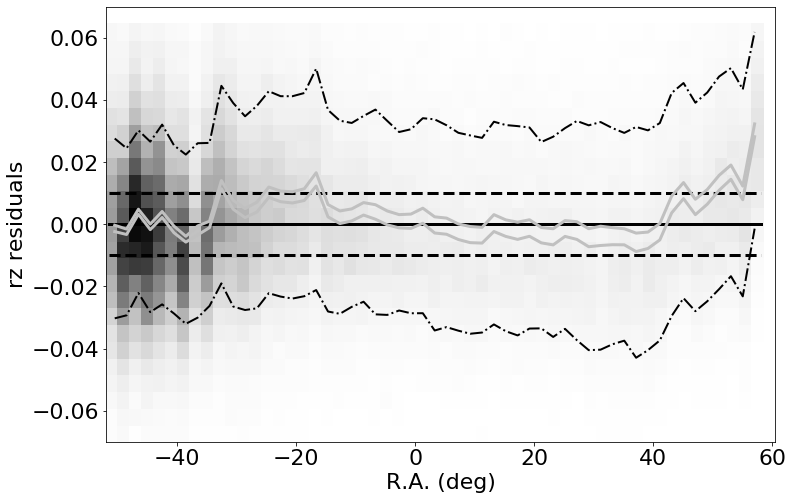

made plot colorResidGaiaColorsB_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002917317199706615 std.dev: 0.0031063917636085098
saved plot as: colorResidGaiaColorsB_rz_Dec.png


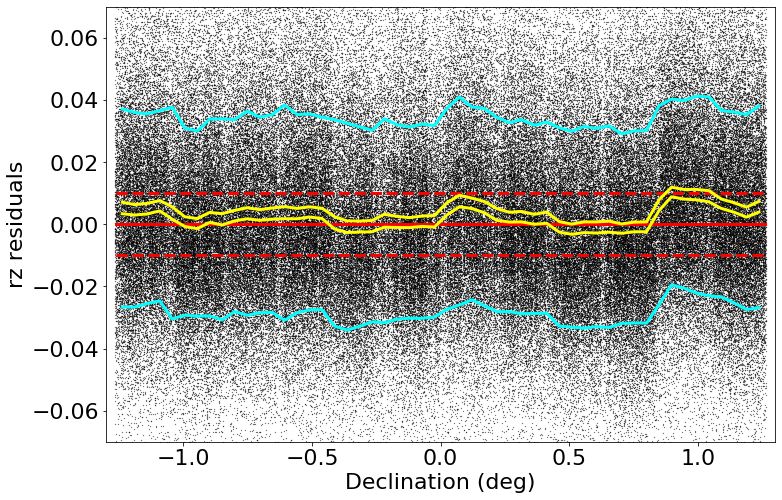

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0028433532714861876 std.dev: 0.0031425600627536187
saved plot as: colorResidGaiaColorsB_rz_Dec_Hess.png


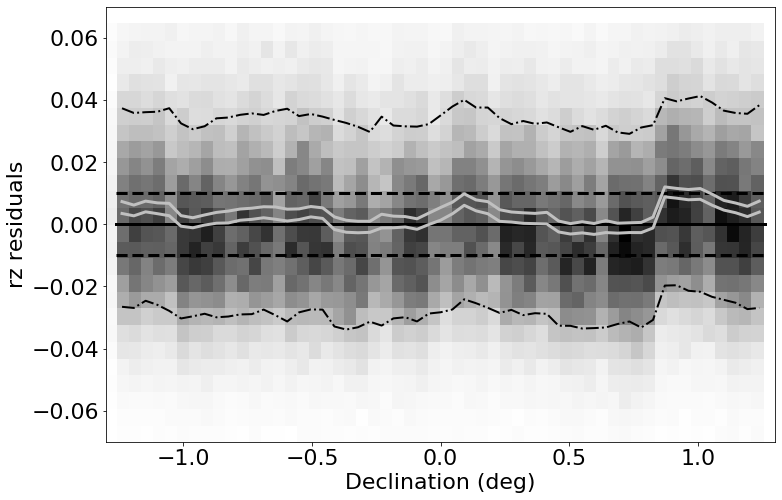

made plot colorResidGaiaColorsB_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0016412391662603554 std.dev: 0.054002854642226865
saved plot as: colorResidGaiaColorsB_rz_rmag.png


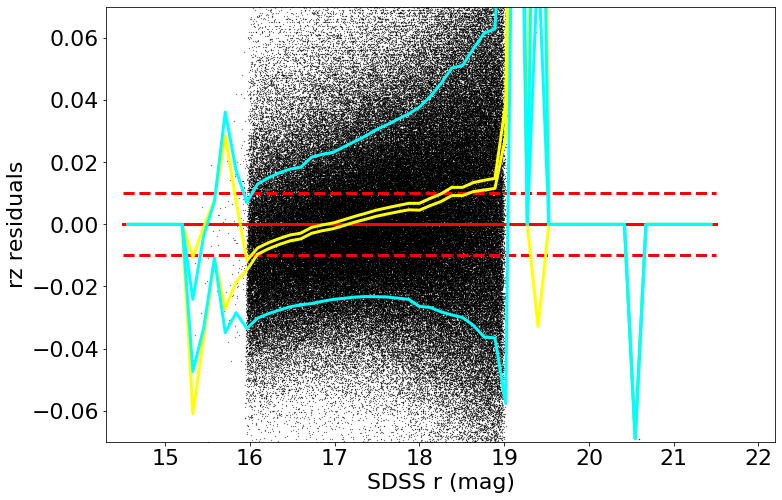

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0016412391662603554 std.dev: 0.054002854642226865
saved plot as: colorResidGaiaColorsB_rz_rmag_Hess.png


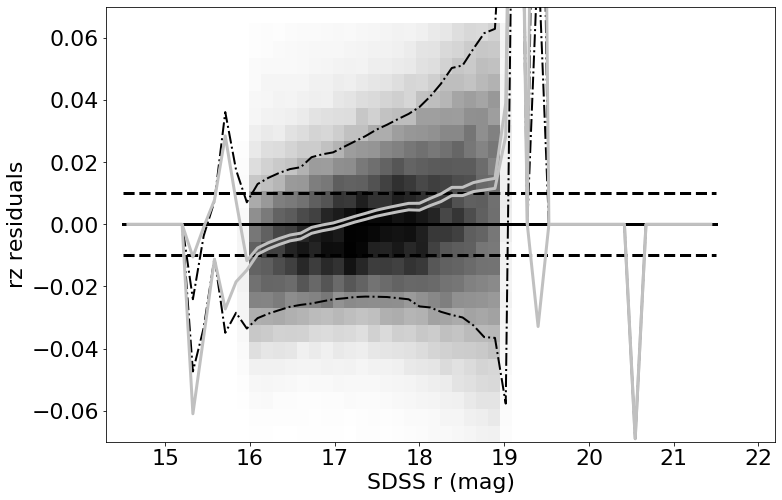

made plot colorResidGaiaColorsB_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003557762145996013 std.dev: 0.00680299723627355
saved plot as: colorResidGaiaColorsB_rz_Gmag.png


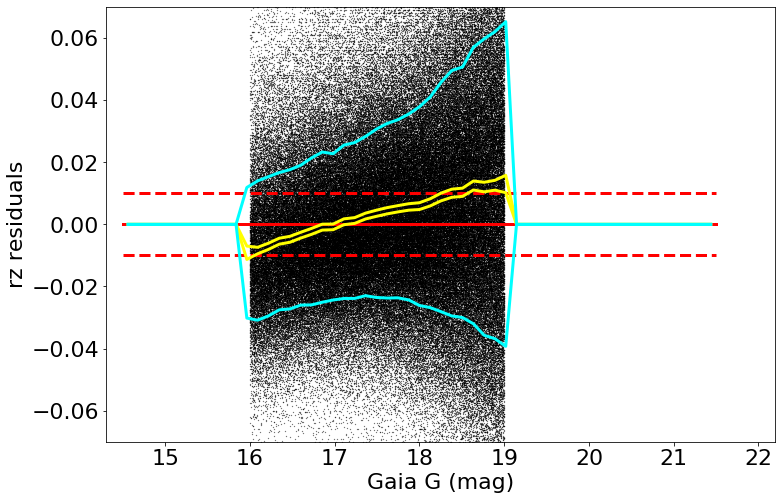

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003557762145996013 std.dev: 0.00680299723627355
saved plot as: colorResidGaiaColorsB_rz_Gmag_Hess.png


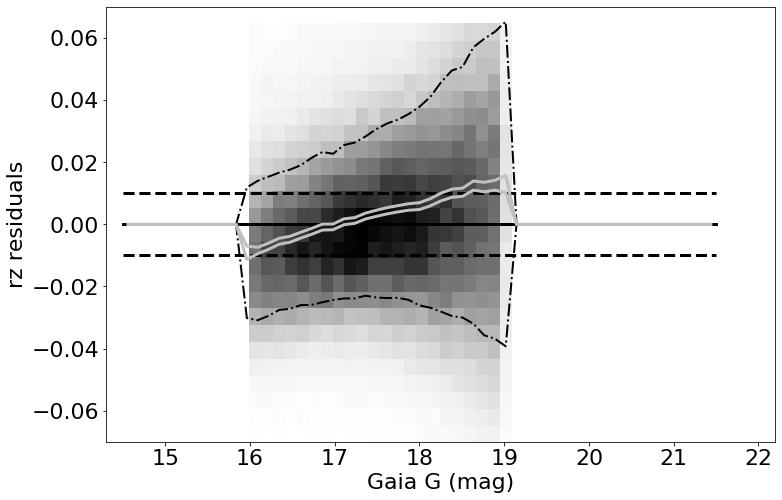

made plot colorResidGaiaColorsB_rz_Gmag_Hess.png
------------------------------------------------------------------


In [17]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsB_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [18]:
matchesRecalib = matches[(matches['BR']>0.7)&(matches['BR']<1.7)]
matchesUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matchesRecalib), np.size(matchesUR))

543663 168258


=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.017455947494506824 std.dev: 0.007407988287316392
saved plot as: colorResidGaiaColorsRecalib_gr_RA.png


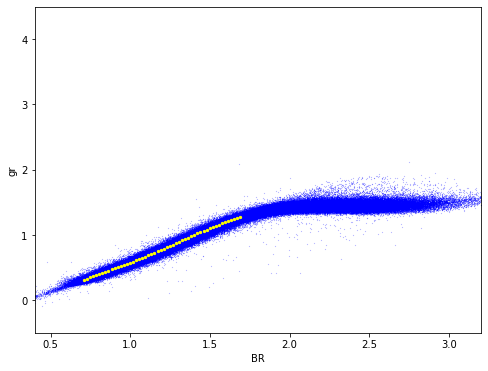

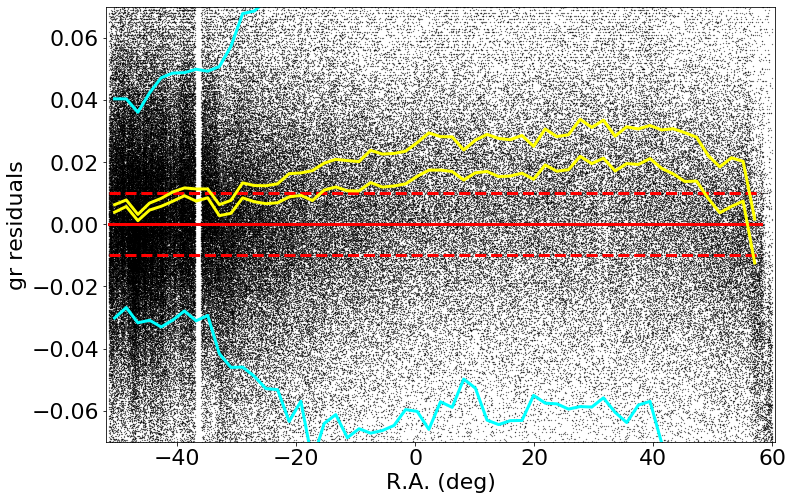

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.017099519348144576 std.dev: 0.0073210721884000695
saved plot as: colorResidGaiaColorsRecalib_gr_RA_Hess.png


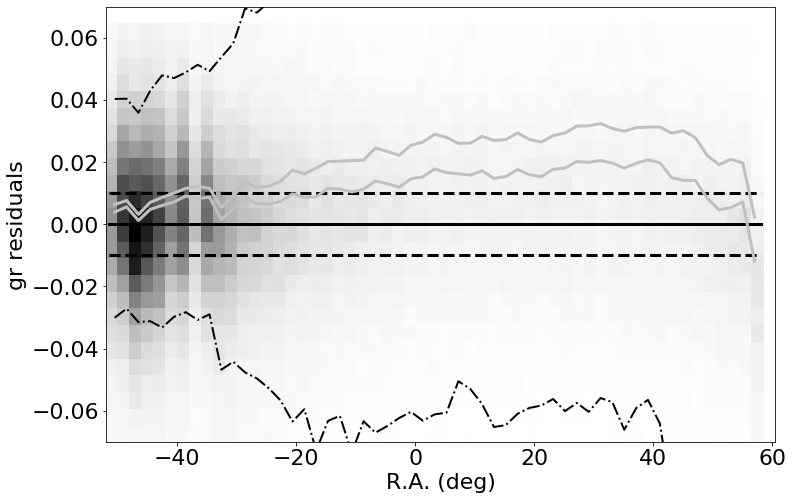

made plot colorResidGaiaColorsRecalib_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010983567428588331 std.dev: 0.0040450793172982355
saved plot as: colorResidGaiaColorsRecalib_gr_Dec.png


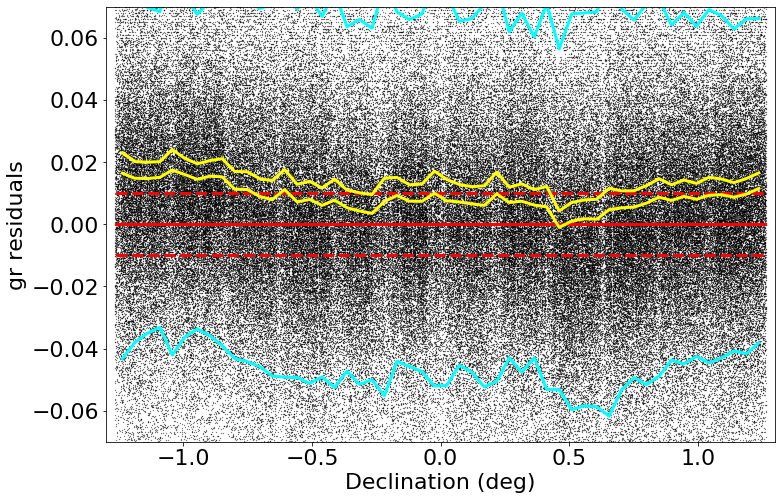

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.01089451904296937 std.dev: 0.004009478622194799
saved plot as: colorResidGaiaColorsRecalib_gr_Dec_Hess.png


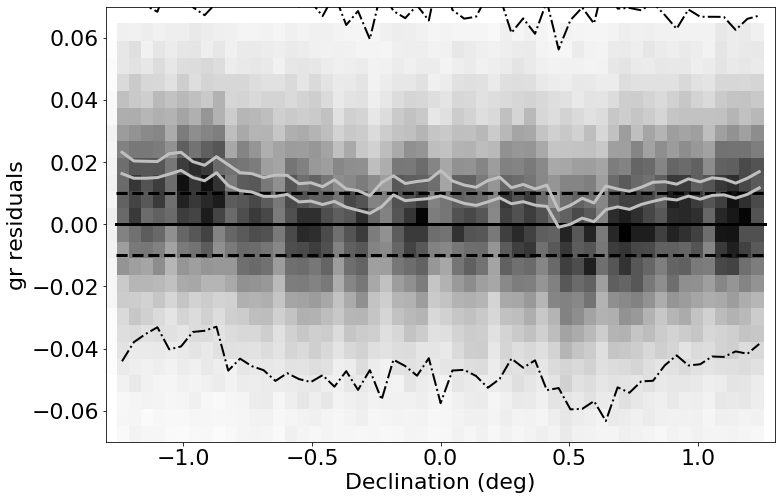

made plot colorResidGaiaColorsRecalib_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.011223139190673734 std.dev: 0.09006422098695906
saved plot as: colorResidGaiaColorsRecalib_gr_rmag.png


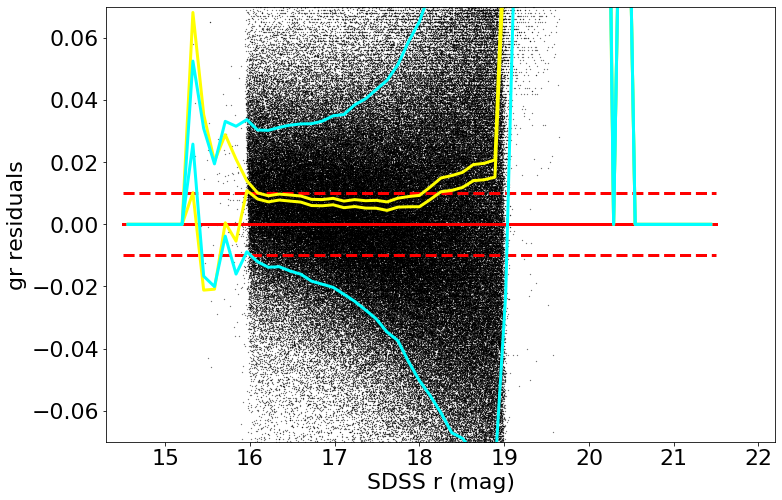

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.011223139190673734 std.dev: 0.09006422098695906
saved plot as: colorResidGaiaColorsRecalib_gr_rmag_Hess.png


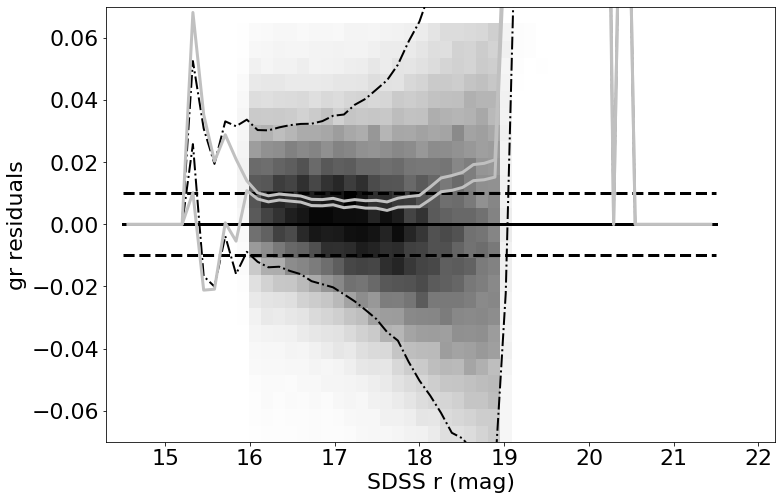

made plot colorResidGaiaColorsRecalib_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010083191680907433 std.dev: 0.0055988243011782625
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag.png


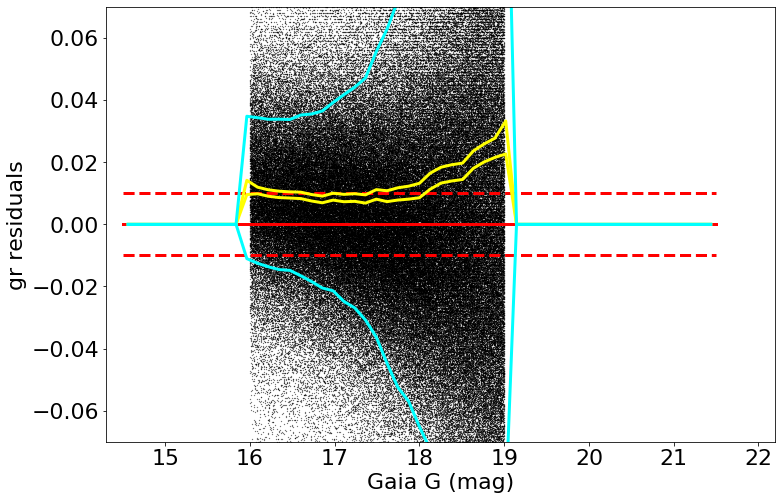

medianAll: 0.011632641601561078 std.dev.All: 0.0580547584899882
N= 304363 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.010083191680907433 std.dev: 0.0055988243011782625
saved plot as: colorResidGaiaColorsRecalib_gr_Gmag_Hess.png


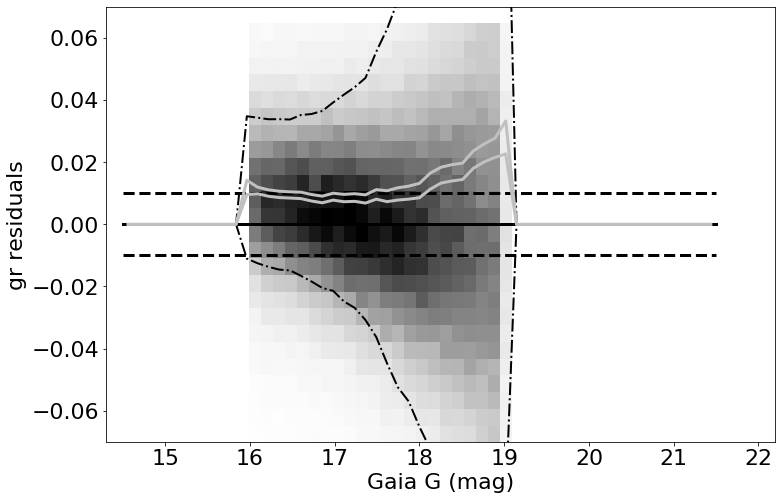

made plot colorResidGaiaColorsRecalib_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002517384719849143 std.dev: 0.0025978907812433515
saved plot as: colorResidGaiaColorsRecalib_ri_RA.png


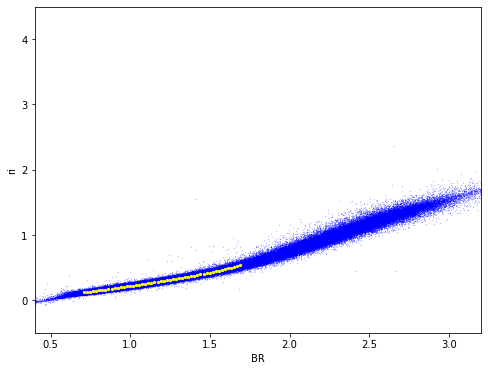

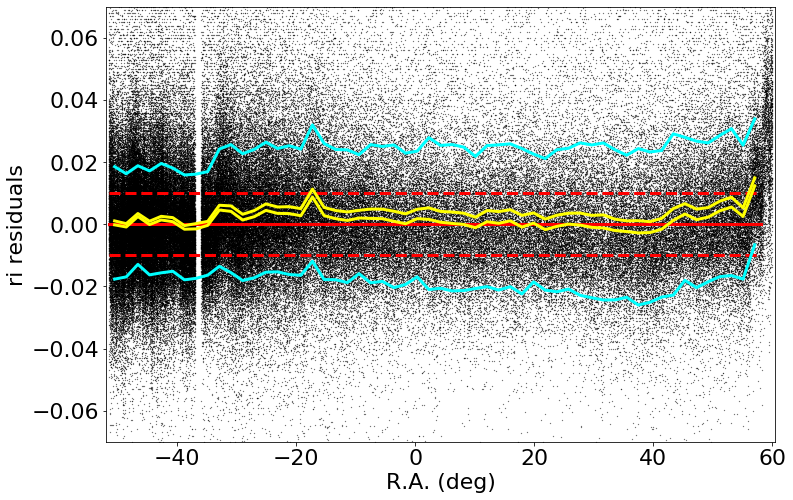

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0025639114379862465 std.dev: 0.002561481115851691
saved plot as: colorResidGaiaColorsRecalib_ri_RA_Hess.png


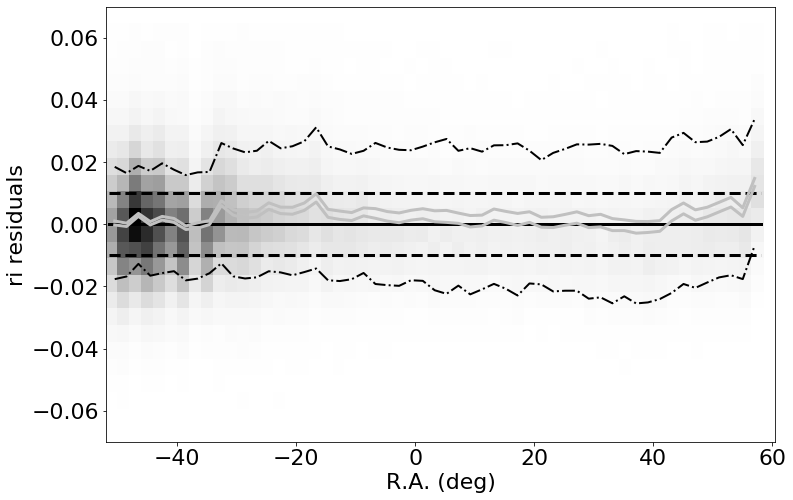

made plot colorResidGaiaColorsRecalib_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0030549987792942435 std.dev: 0.003120953981955027
saved plot as: colorResidGaiaColorsRecalib_ri_Dec.png


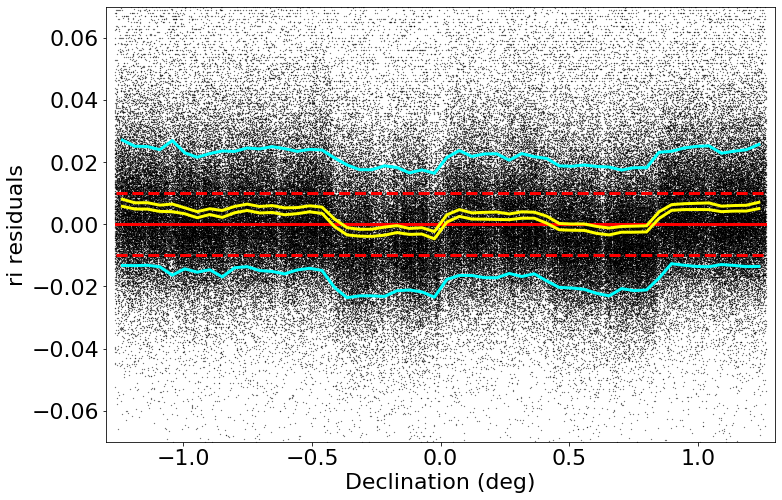

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0032858955383308214 std.dev: 0.003119921626873285
saved plot as: colorResidGaiaColorsRecalib_ri_Dec_Hess.png


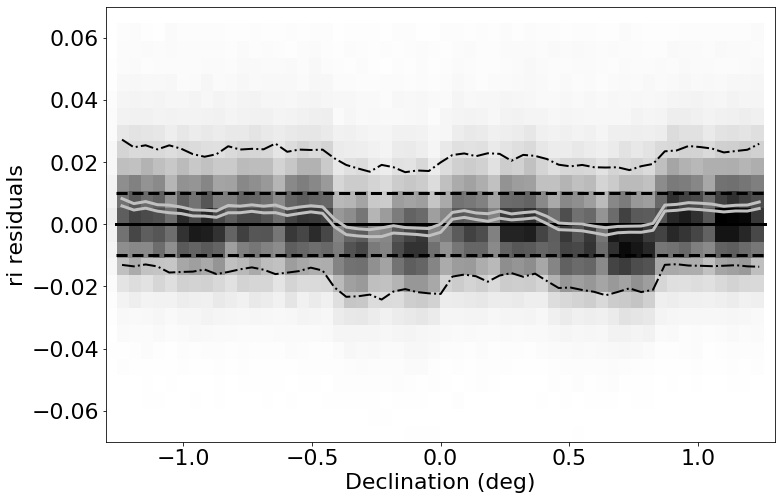

made plot colorResidGaiaColorsRecalib_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002233013916016241 std.dev: 0.07031689436466795
saved plot as: colorResidGaiaColorsRecalib_ri_rmag.png


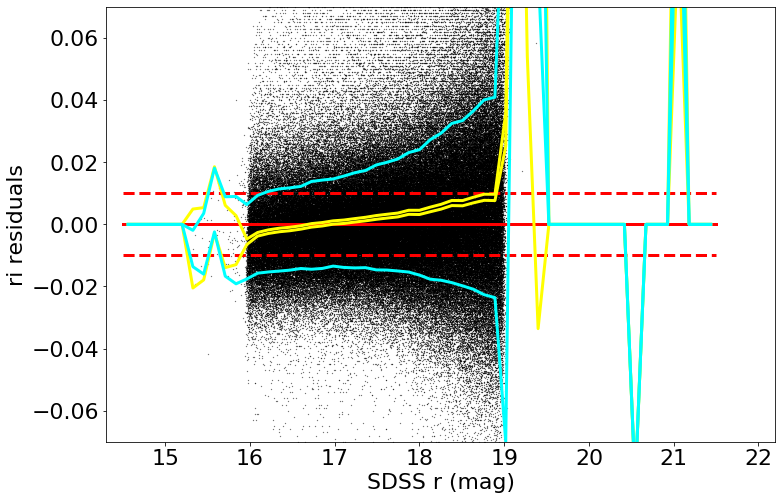

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002233013916016241 std.dev: 0.07031689436466795
saved plot as: colorResidGaiaColorsRecalib_ri_rmag_Hess.png


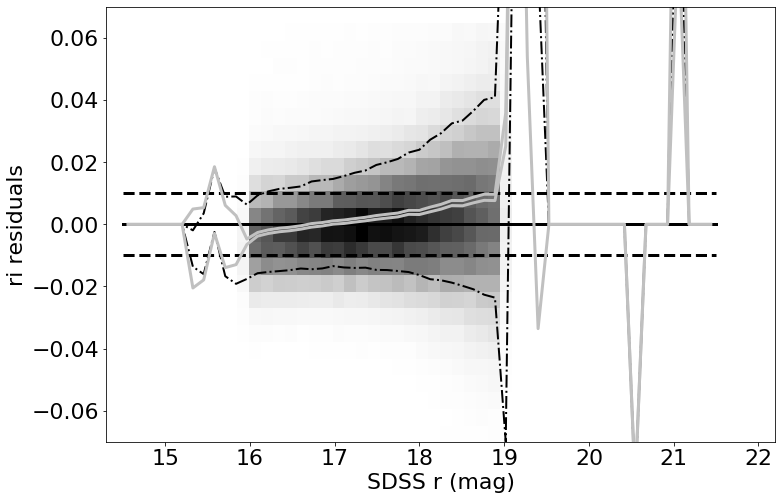

made plot colorResidGaiaColorsRecalib_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0023762168884268187 std.dev: 0.0036533489445314937
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag.png


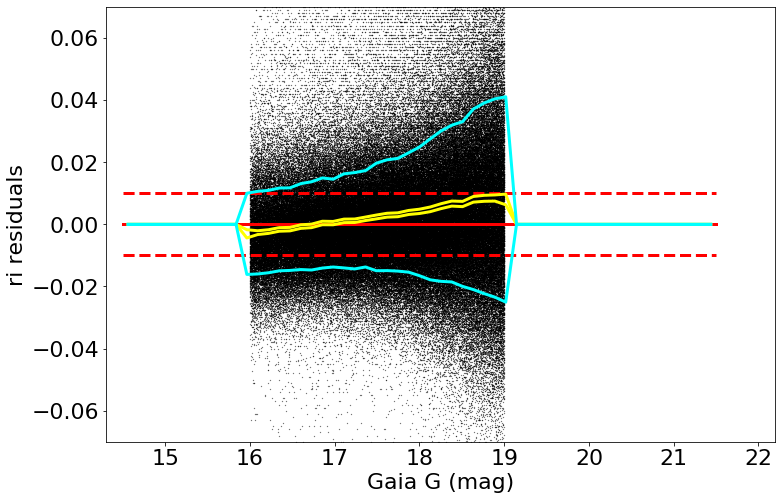

medianAll: 0.002611482238773166 std.dev.All: 0.019908373370359386
N= 261595 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0023762168884268187 std.dev: 0.0036533489445314937
saved plot as: colorResidGaiaColorsRecalib_ri_Gmag_Hess.png


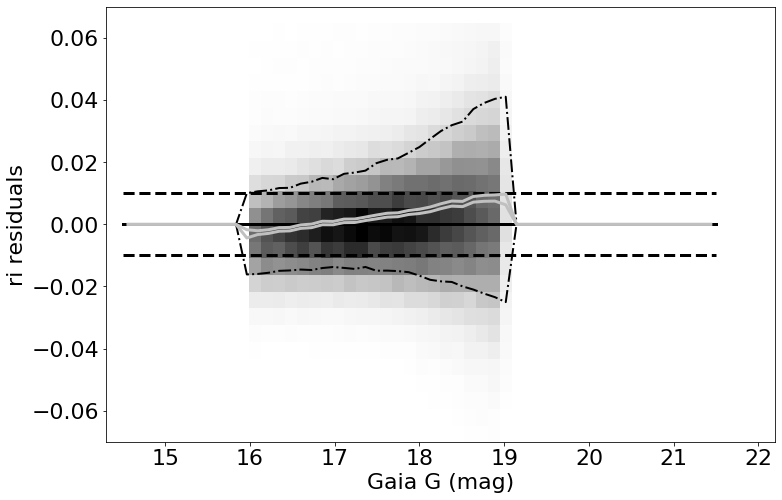

made plot colorResidGaiaColorsRecalib_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0013426254272465299 std.dev: 0.006753015523284264
saved plot as: colorResidGaiaColorsRecalib_rz_RA.png


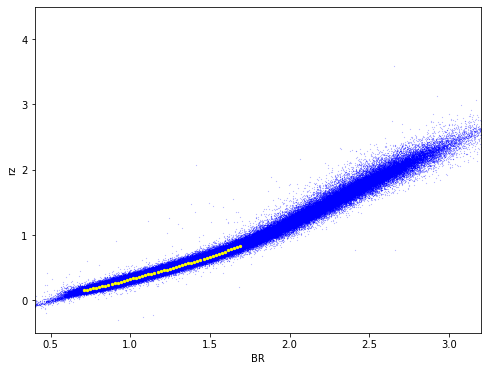

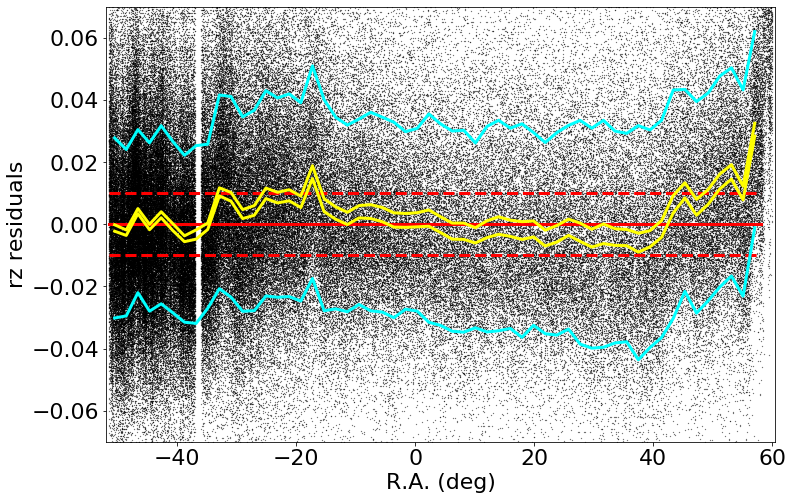

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0009999999999994458 std.dev: 0.0067560199470467095
saved plot as: colorResidGaiaColorsRecalib_rz_RA_Hess.png


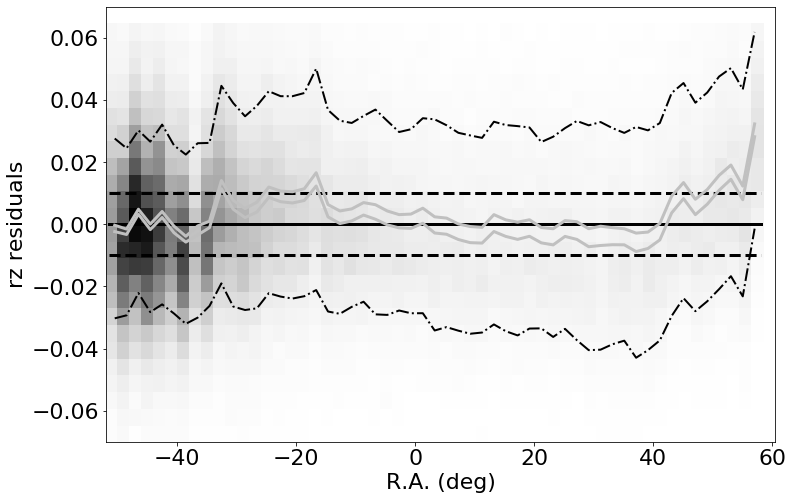

made plot colorResidGaiaColorsRecalib_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.002917317199706615 std.dev: 0.0031063917636085098
saved plot as: colorResidGaiaColorsRecalib_rz_Dec.png


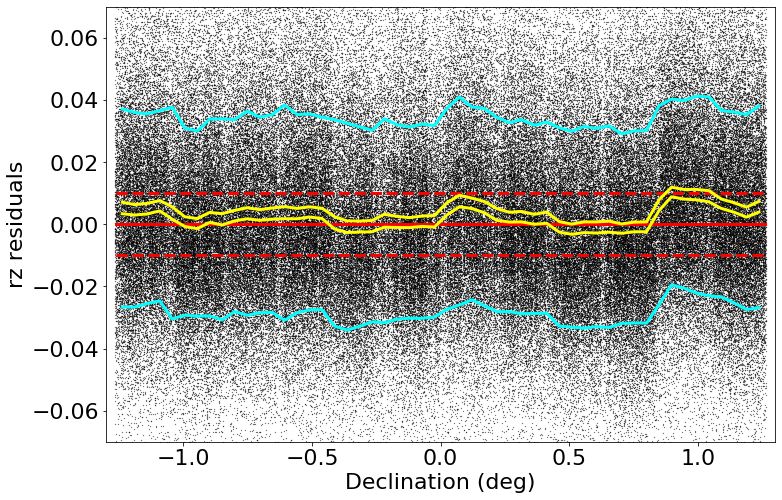

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0028433532714861876 std.dev: 0.0031425600627536187
saved plot as: colorResidGaiaColorsRecalib_rz_Dec_Hess.png


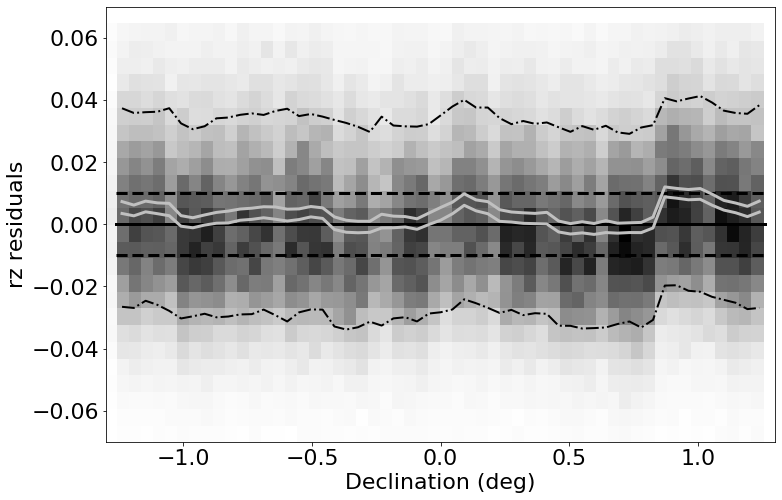

made plot colorResidGaiaColorsRecalib_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0016412391662603554 std.dev: 0.054002854642226865
saved plot as: colorResidGaiaColorsRecalib_rz_rmag.png


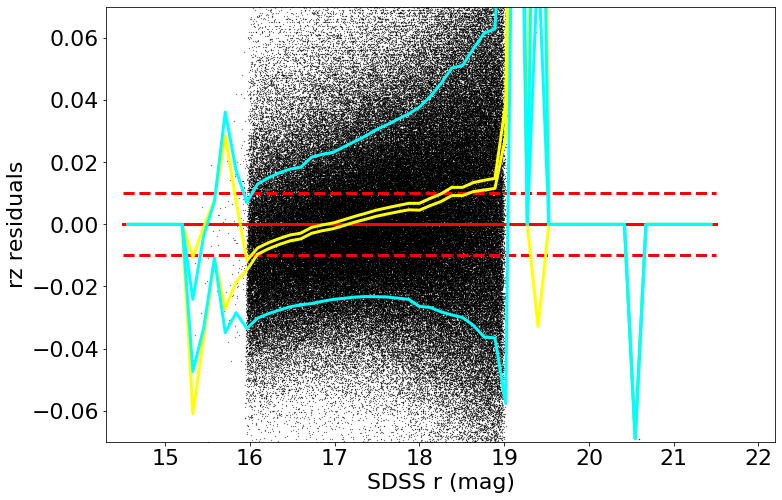

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.0016412391662603554 std.dev: 0.054002854642226865
saved plot as: colorResidGaiaColorsRecalib_rz_rmag_Hess.png


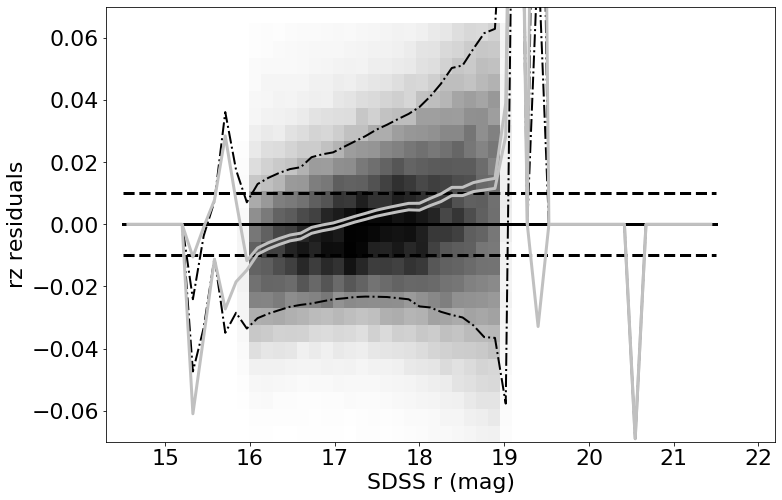

made plot colorResidGaiaColorsRecalib_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003557762145996013 std.dev: 0.00680299723627355
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag.png


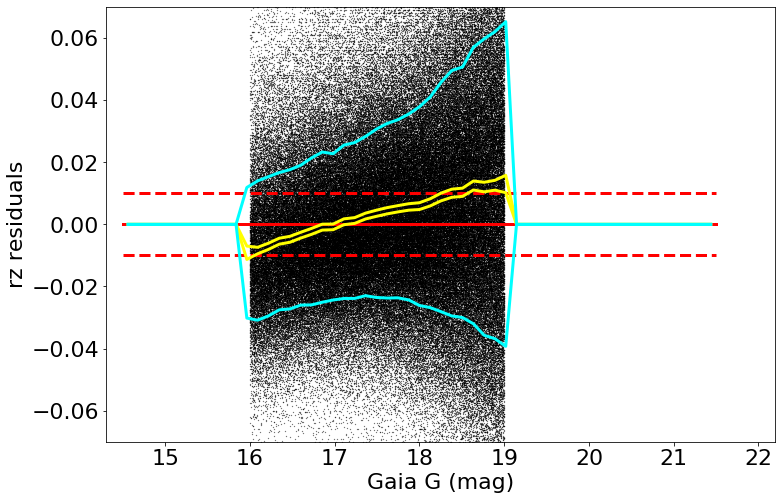

medianAll: 0.003068060302735584 std.dev.All: 0.03169850045356948
N= 249778 min= -0.29900000000000304 max= 0.29999999999999893
median: 0.003557762145996013 std.dev: 0.00680299723627355
saved plot as: colorResidGaiaColorsRecalib_rz_Gmag_Hess.png


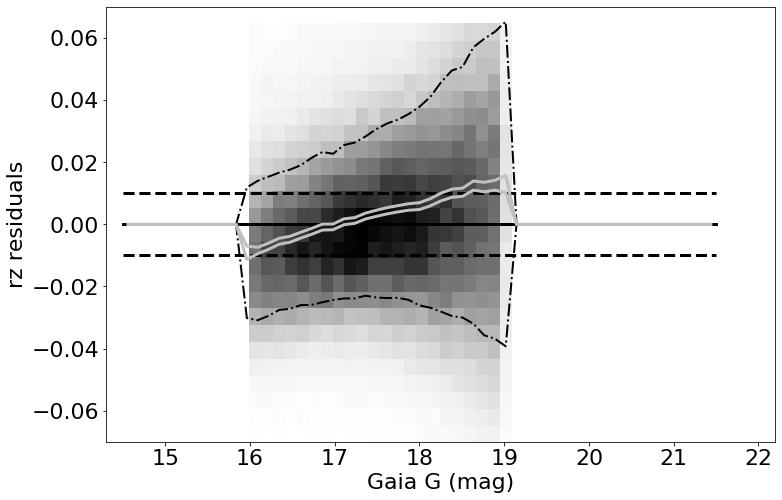

made plot colorResidGaiaColorsRecalib_rz_Gmag_Hess.png
------------------------------------------------------------------


In [19]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColorsRecalib_', "symbSize":0.05}
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesB, keywords)

In [20]:
d = matchesUR
xVec = d['BR'] 
yVec = d['ur']
# 
xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
goodC = d[np.abs(d['colorresid'])<0.3]
# goodC['colorresid'] = goodC['colorresid'] - np.median(goodC['colorresid'])

medianAll: 0.0061691493988029755 std.dev.All: 0.11971512431716877
N= 154850 min= -0.2999876098632792 max= 0.2999664916992171
median: 0.008777669906615104 std.dev: 0.020234163270599768
saved plot as: colorResidGaiaColorsB_urResiduals_Dec.png


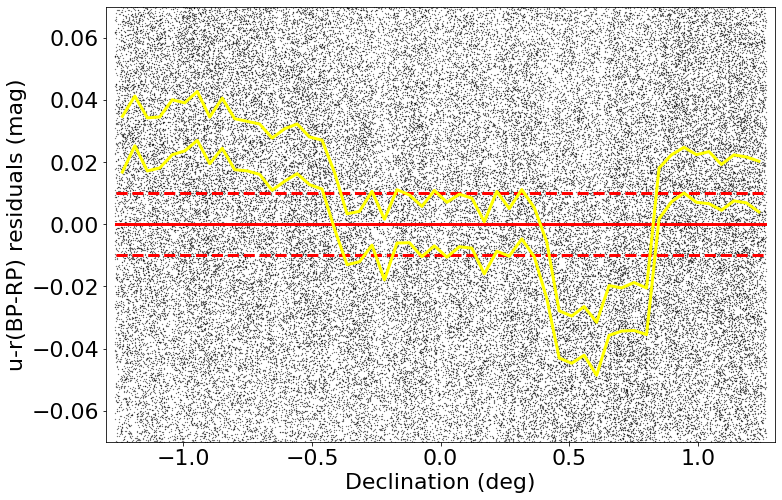

In [21]:
plotName = 'colorResidGaiaColorsB_urResiduals_Dec.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'dec', "Xmin":-1.3, "Xmax":1.3, "Xlabel":'Declination (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-1.26, "XmaxBin":1.26, "nBin":52, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

medianAll: 0.0061691493988029755 std.dev.All: 0.11971512431716877
N= 154850 min= -0.2999876098632792 max= 0.2999664916992171
median: 0.0156022052764892 std.dev: 0.036152871299019416
saved plot as: colorResidGaiaColorsB_urResiduals_RA.png


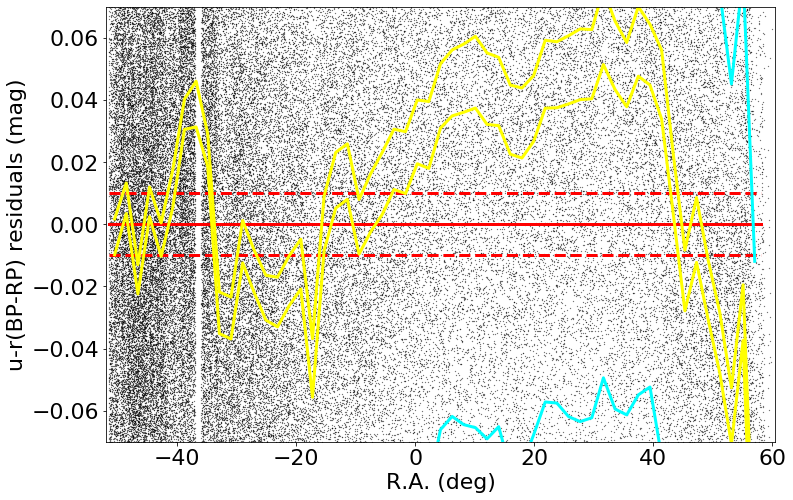

In [22]:
plotName = 'colorResidGaiaColorsB_urResiduals_RA.png' 
Ylabel = 'u-r(BP-RP) residuals (mag)'
kwOC = {"Xstr":'raW', "Xmin":-52, "Xmax":60.5, "Xlabel":'R.A. (deg)', \
          "Ystr":'colorresid', "Ymin":-0.07, "Ymax":0.07, "Ylabel":Ylabel, \
          "XminBin":-51.5, "XmaxBin":58, "nBin":56, \
          "plotName":plotName, "Nsigma":3, "offset":0.01, "symbSize":0.05}
zit.plotdelMag(goodC, kwOC)

In [23]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
np.savetxt('ZPcorrectionsDec_ur_v4.2_final.dat', (xBin, medianBin)) 

median: 0.008777669906615104 std.dev: 0.020234163270599768


In [24]:
xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
# we cannot confirm the RA behavior with CFIS data: it's better to leave it as it is
medianBin = 0.0*medianBin
np.savetxt('ZPcorrectionsRA_ur_v4.2_final.dat', (xBin, medianBin)) 

median: 0.0156022052764892 std.dev: 0.036152871299019416


In [29]:
d = matchesRecalib  
xVec = d['BR'] 
for color in ('gr', 'ri', 'rz'):
    yVec = d[color]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(xVec, yVec, 0.7, 1.7, 40, 0)
    d['colorresid'] = yVec - np.interp(xVec, xBin, medianBin)  
    goodC = d[np.abs(d['colorresid'])<0.1]
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['dec'], goodC['colorresid'], -1.26, 1.26, 52, 1)
    fname = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 
    xBin, nPts, medianBin, sigGbin = zit.fitMedians(goodC['raW'], goodC['colorresid'], -51.5, 58, 56, 1)
    fname = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'
    np.savetxt(fname, (xBin, medianBin)) 

median: -0.0069997692108171305 std.dev: 0.0042480530301542046
median: -0.0051179046630884795 std.dev: 0.003867381115243933
median: -0.0041222305297839434 std.dev: 0.0032552409374615567
median: -0.007357786178591279 std.dev: 0.003827694749500115
median: -0.010941791534424192 std.dev: 0.0029694884041323124
median: -0.013115848541260453 std.dev: 0.007372320884583461


In [30]:
sdssOut = sdss[sdss['ra_new']<1000] 
print(np.size(sdssOut))

991472


In [31]:
decGrid2correct = sdssOut['dec_new']
# RA correction 
ra = sdssOut['ra_new'] 
raWGrid2correct = np.where(ra > 180, ra-360, ra) 

In [32]:
print('ENTRIES FOR TABLE 1:')
## apply color corrections 
for mtype in ('_mMed_new', '_mMean_new'):
    ## u band from u-r color
    color = 'ur'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('u-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'u' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## g band from g-r color
    color = 'gr'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    print('g-r std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    mstr = 'g' + mtype
    sdssOut[mstr] = sdssOut[mstr] - ZPcorrectionsRA - ZPcorrectionsDec 
    ## i band from r-i color
    color = 'ri'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'i' + mtype
    print('r-i std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 
    ## i band from r-z color
    color = 'rz'
    zpcFilename = 'ZPcorrectionsRA_' + color + '_v4.2_final.dat'  
    zpcRAgrid, zpcRA = np.loadtxt(zpcFilename)   
    zpcFilename = 'ZPcorrectionsDec_' + color + '_v4.2_final.dat'  
    zpcDecgrid, zpcDec = np.loadtxt(zpcFilename)   
    ZPcorrectionsRA = np.interp(raWGrid2correct, zpcRAgrid, zpcRA) 
    ZPcorrectionsDec = np.interp(decGrid2correct, zpcDecgrid, zpcDec) 
    mstr = 'z' + mtype
    print('r-z std RA/Dec:', np.std(ZPcorrectionsRA), np.std(ZPcorrectionsDec)) 
    sdssOut[mstr] = sdssOut[mstr] + ZPcorrectionsRA + ZPcorrectionsDec 

ENTRIES FOR TABLE 1:
u-r std RA/Dec: 0.0 0.01996356563174435
g-r std RA/Dec: 0.003873685171007741 0.00417010970593145
r-i std RA/Dec: 0.0036627854579085336 0.003173478300984807
r-z std RA/Dec: 0.006777405809981391 0.0028656585672074374
u-r std RA/Dec: 0.0 0.01996356563174435
g-r std RA/Dec: 0.003873685171007741 0.00417010970593145
r-i std RA/Dec: 0.0036627854579085336 0.003173478300984807
r-z std RA/Dec: 0.006777405809981391 0.0028656585672074374


In [33]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla_new'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i)
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v4.2temp_noheader_final.dat


<a id='dataReading'></a>

### Test v4.2

In [34]:
# Karun's new catalog from 2020, after Gmag-based gray and BP-RP color corrections 
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [35]:
sdssOld_coords = SkyCoord(ra = sdssOld['ra']*u.degree, dec= sdssOld['dec']*u.degree) 
sdssNew_coords = SkyCoord(ra = sdssNew['ra']*u.degree, dec= sdssNew['dec']*u.degree) 
# this is matching sdssNew to sdssOld, so that indices are into sdssNew catalog
# makes sense in this case since the sdssOld catalog is (a little bit) bigger 
# than sdssNew (1006849 vs 1005470)
idx, d2d, d3d = sdssNew_coords.match_to_catalog_sky(sdssOld_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
new_old = hstack([sdssNew, sdssOld[idx]], table_names = ['new', 'old'])
new_old['sep_2d_arcsec'] = d2d.arcsec
# good matches between the old and new catalogs
MAX_DISTANCE_ARCSEC = 0.5
sdss = new_old[(new_old['sep_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]
print(np.size(sdss))

991472


In [36]:
sdss_coords = SkyCoord(ra = sdss['ra_old']*u.degree, dec= sdss['dec_old']*u.degree) 
gaia_coords = SkyCoord(ra = gaia['raG']*u.degree, dec= gaia['decG']*u.degree) 

# this is matching gaia to sdss, so that indices are into sdss catalog
# makes sense in this case since the sdss catalog is bigger than gaia
idxG, d2dG, d3dG = gaia_coords.match_to_catalog_sky(sdss_coords)  

# object separation is an object with units, 
# I add that as a column so that one can 
# select based on separation to the nearest matching object
gaia_sdss = hstack([gaia, sdss[idxG]], table_names = ['gaia', 'sdss'])
gaia_sdss['sepSG_2d_arcsec'] = d2dG.arcsec
derivedColumns(gaia_sdss)

In [37]:
MAX_DISTANCE_ARCSEC = 0.5
matches = gaia_sdss[(gaia_sdss['sepSG_2d_arcsec'] < MAX_DISTANCE_ARCSEC)]

=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.013782759666443212 std.dev: 0.01381217536480723
saved plot as: colorResidGaiaColors_ur_RA.png


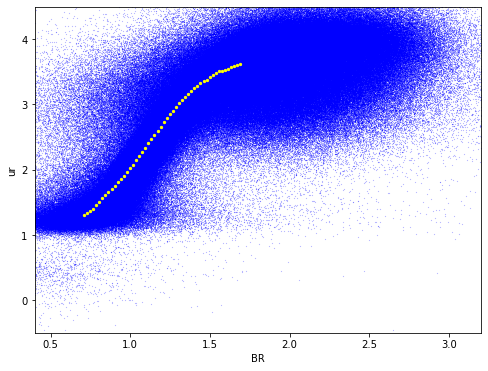

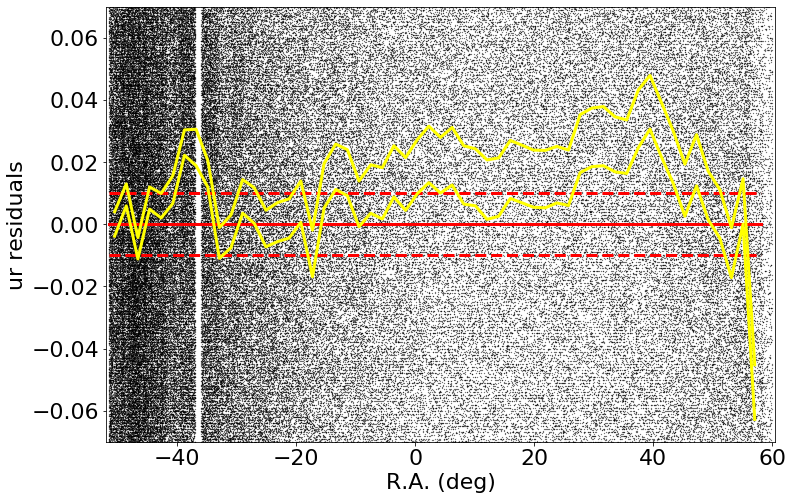

medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.014007917785645585 std.dev: 0.013776650430873345
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


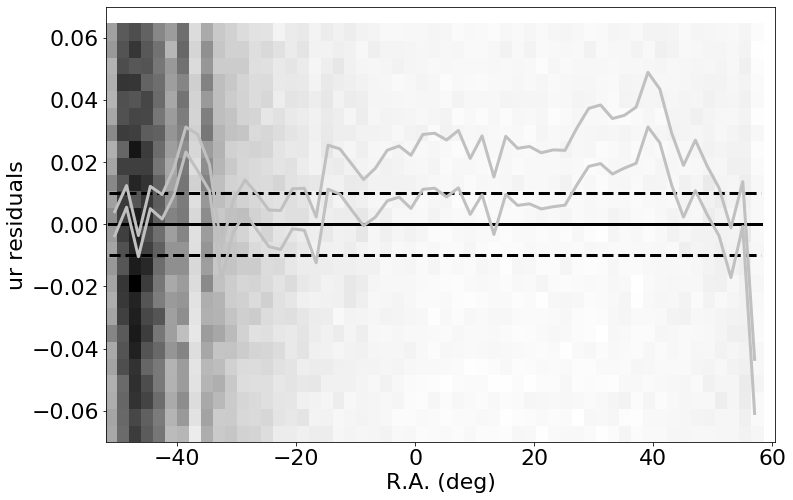

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.008932159423828079 std.dev: 0.0025182524082262136
saved plot as: colorResidGaiaColors_ur_Dec.png


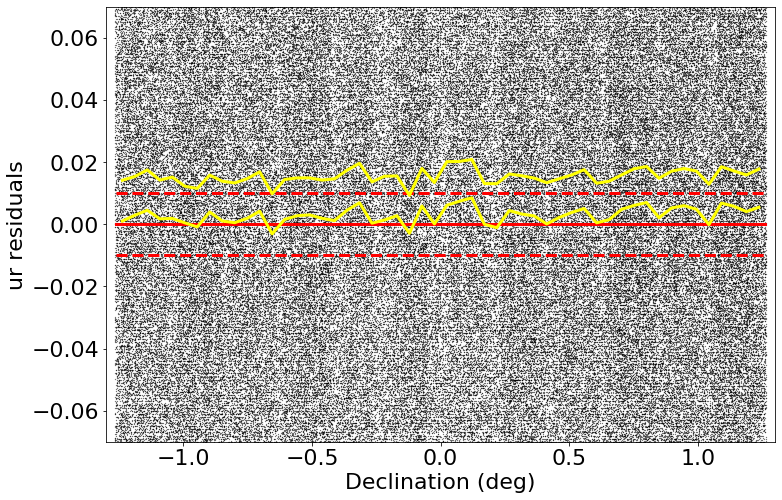

medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.008985633850098318 std.dev: 0.003223856508476334
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


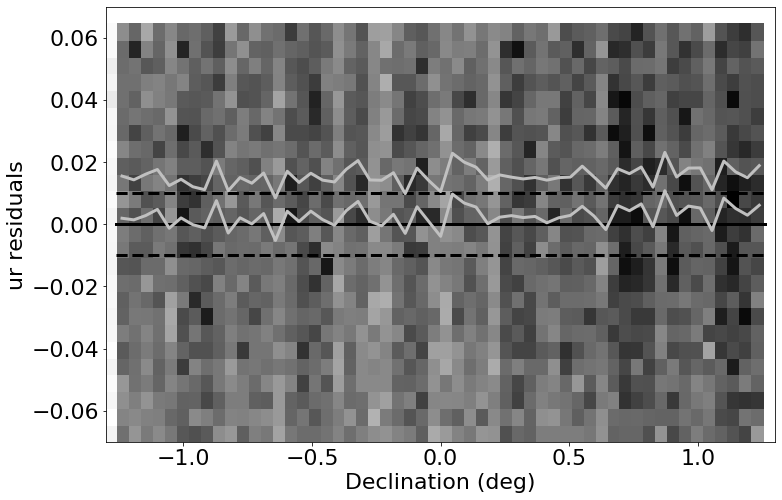

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.0019517272949198805 std.dev: 0.05263983909418426
saved plot as: colorResidGaiaColors_ur_rmag.png


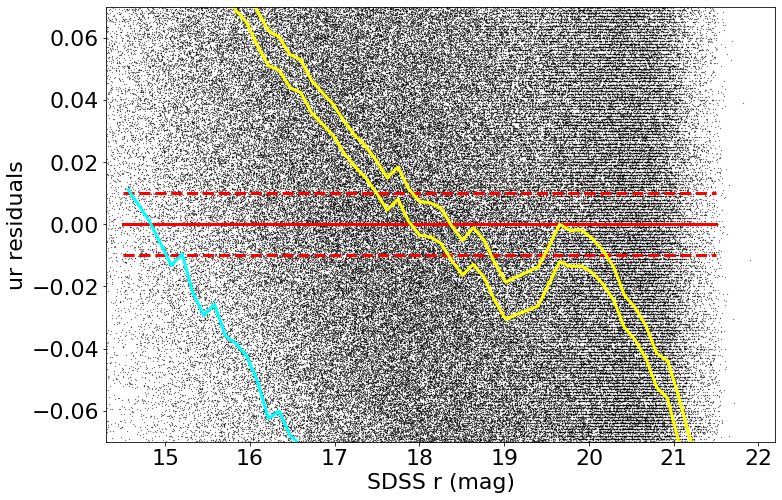

medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.0019517272949198805 std.dev: 0.05263983909418426
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


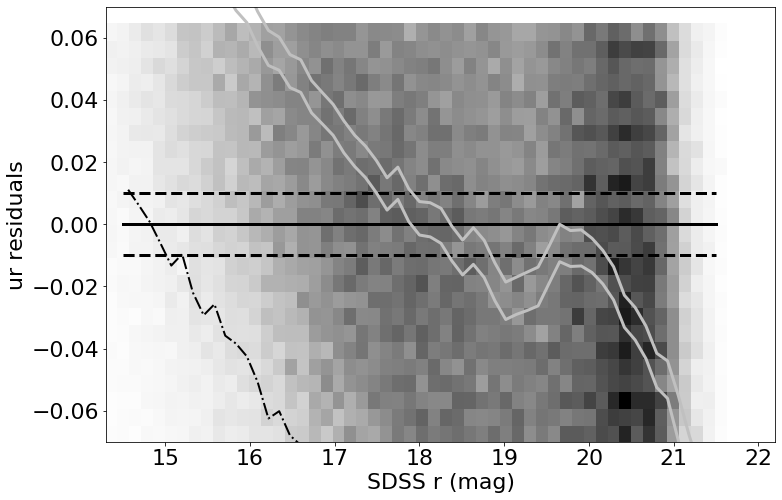

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.009290705871580762 std.dev: 0.05388099986922503
saved plot as: colorResidGaiaColors_ur_Gmag.png


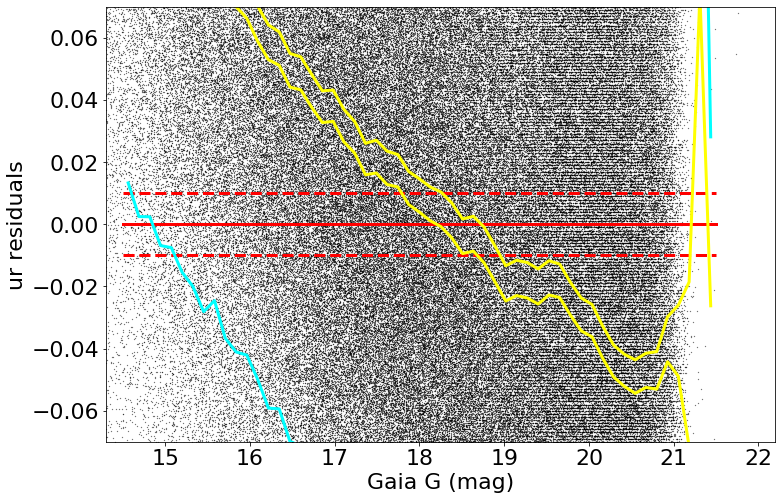

medianAll: 0.00916636505127122 std.dev.All: 0.16986077742691238
N= 545342 min= -0.29999999999999716 max= 0.29999042968750134
median: 0.009290705871580762 std.dev: 0.05388099986922503
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


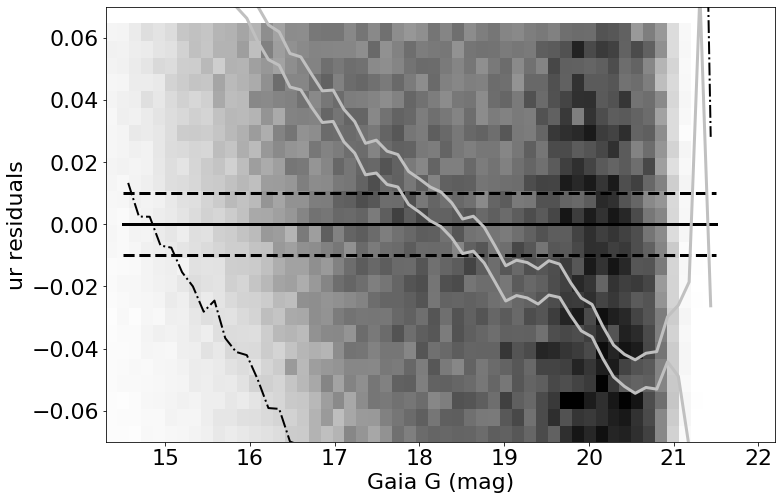

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.02092768783569232 std.dev: 0.010641866790887794
saved plot as: colorResidGaiaColors_gr_RA.png


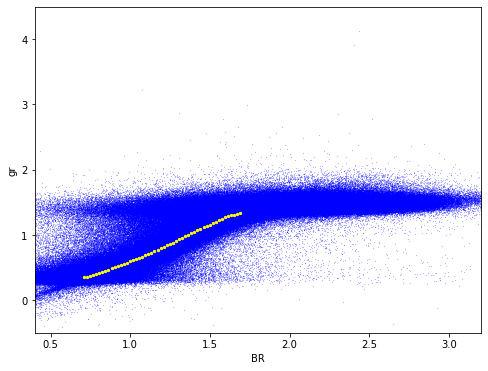

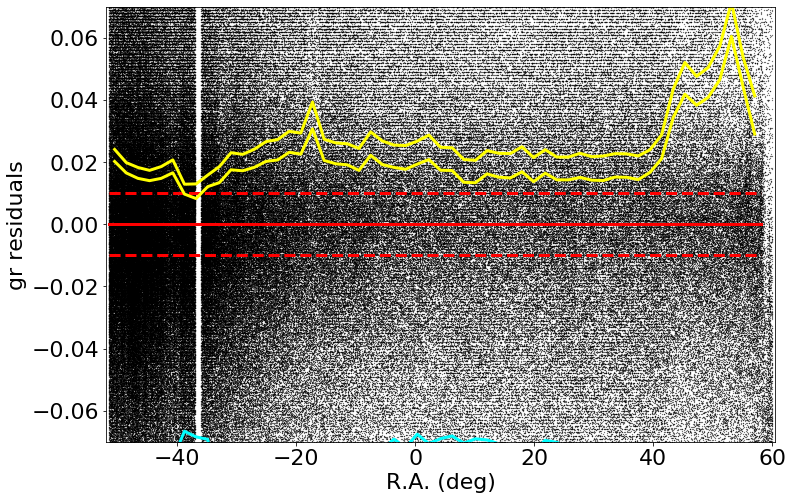

medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.021000000000000796 std.dev: 0.010599053561101883
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


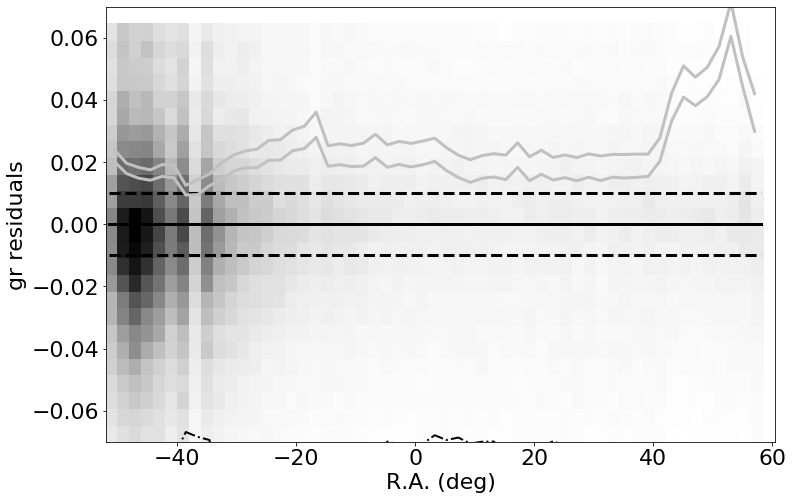

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.020070050048828503 std.dev: 0.0029546134069533803
saved plot as: colorResidGaiaColors_gr_Dec.png


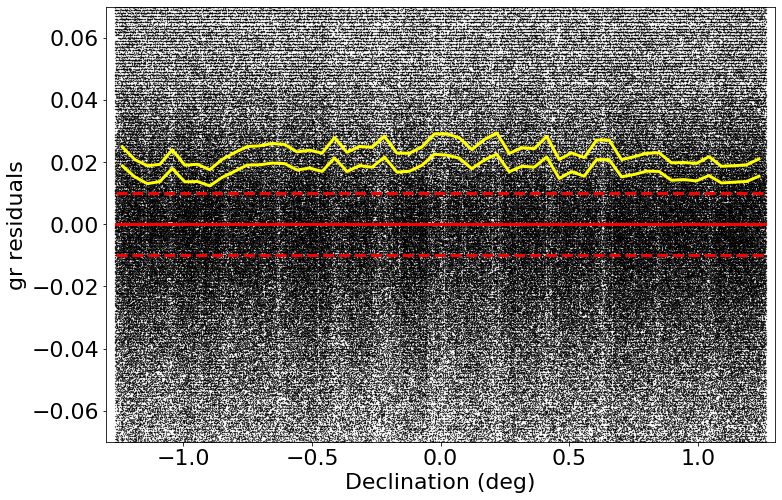

medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.02034326019286825 std.dev: 0.003074637261192368
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


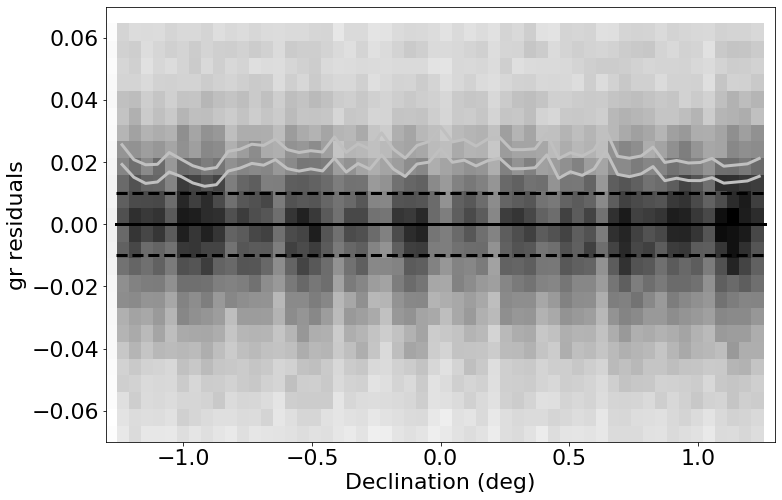

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.002815366744992942 std.dev: 0.04337579886472154
saved plot as: colorResidGaiaColors_gr_rmag.png


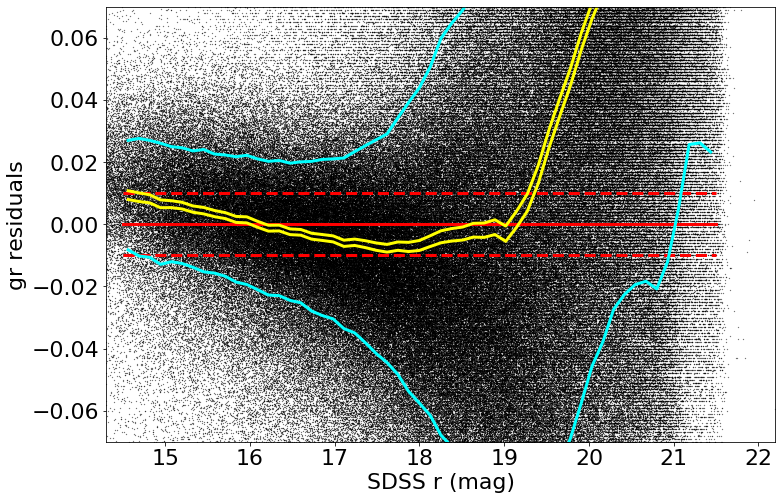

medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.002815366744992942 std.dev: 0.04337579886472154
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


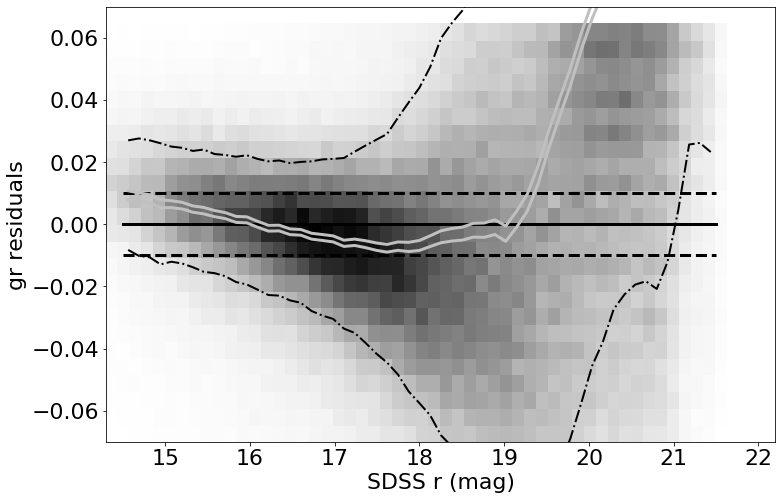

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005511050415037189 std.dev: 0.03424409122993011
saved plot as: colorResidGaiaColors_gr_Gmag.png


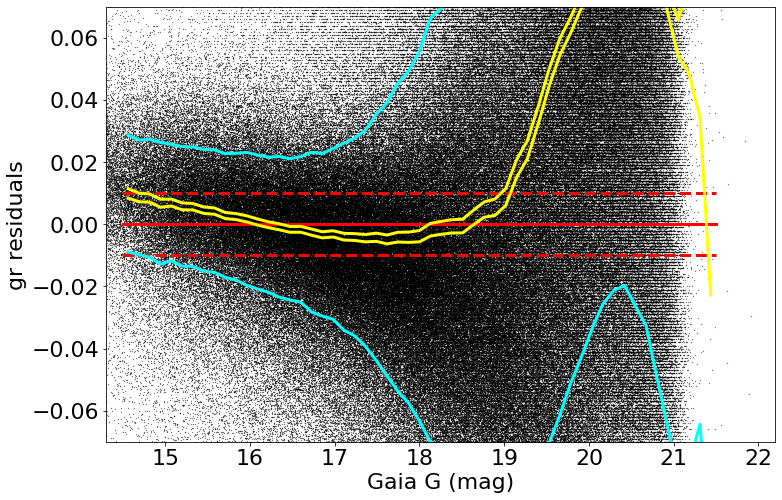

medianAll: 0.019999999999999574 std.dev.All: 0.09929399999999762
N= 820736 min= -0.29999999999999716 max= 0.29999999999999716
median: 0.005511050415037189 std.dev: 0.03424409122993011
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


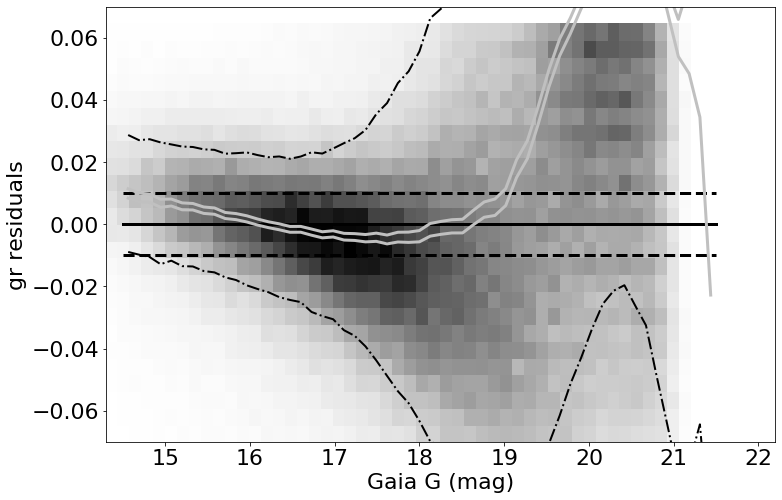

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.00040367660522534765 std.dev: 0.0014109693143090813
saved plot as: colorResidGaiaColors_ri_RA.png


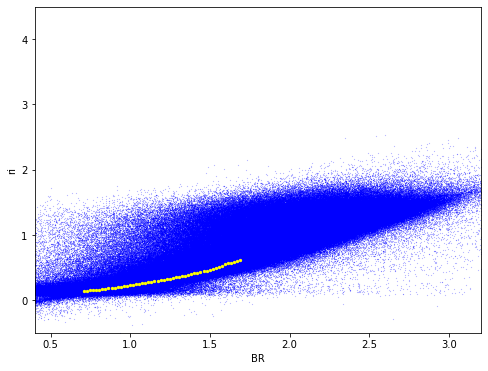

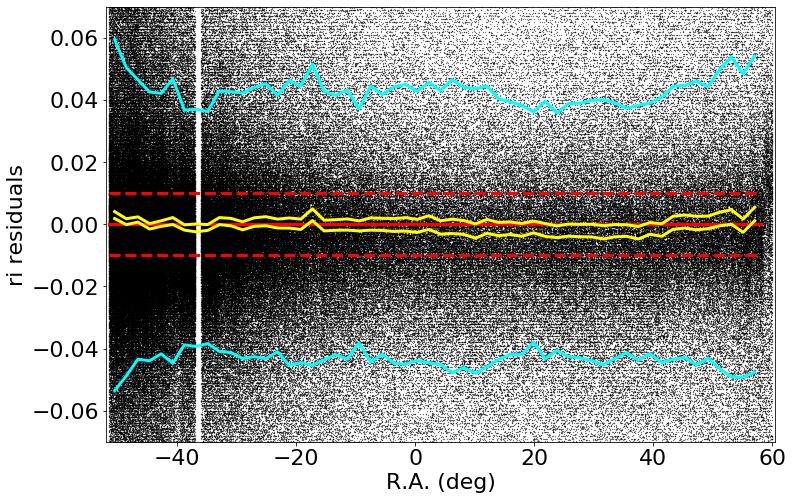

medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.00014508628845351368 std.dev: 0.0014204122618367064
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


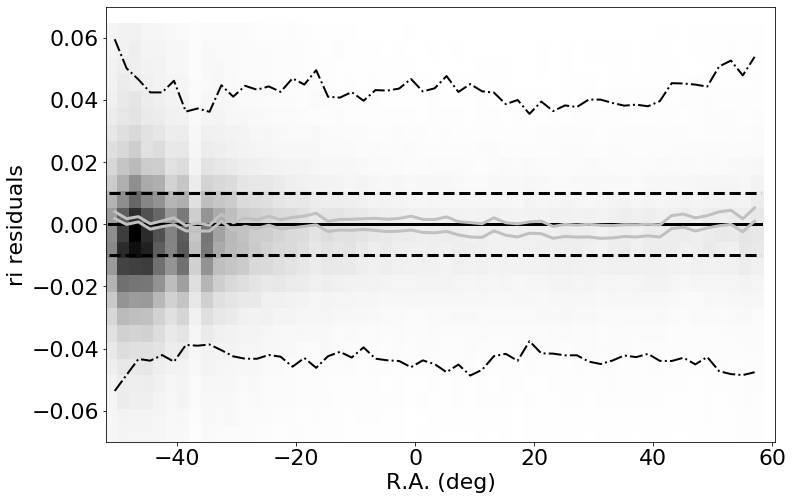

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: 4.6044921875189326e-05 std.dev: 0.0006409160580431818
saved plot as: colorResidGaiaColors_ri_Dec.png


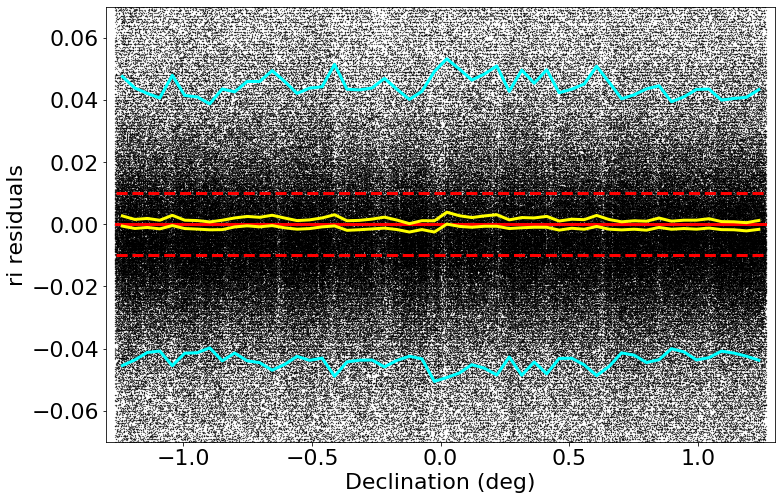

medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: 6.907958984572748e-05 std.dev: 0.0006798591479675581
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


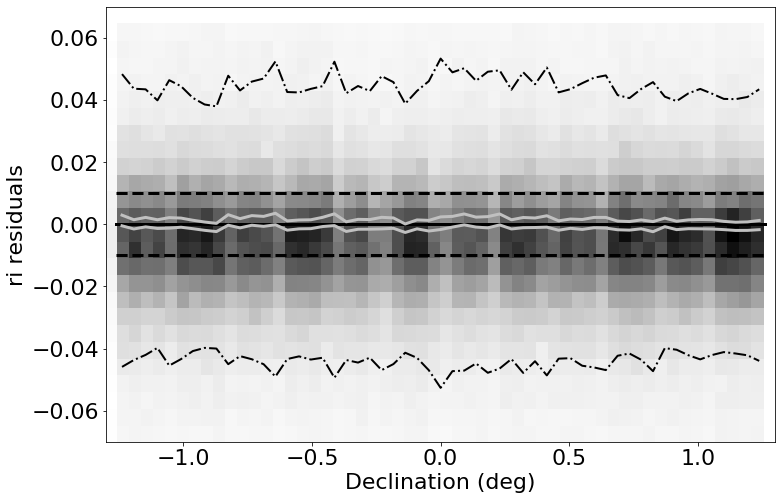

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.003515576171875312 std.dev: 0.04914747645701013
saved plot as: colorResidGaiaColors_ri_rmag.png


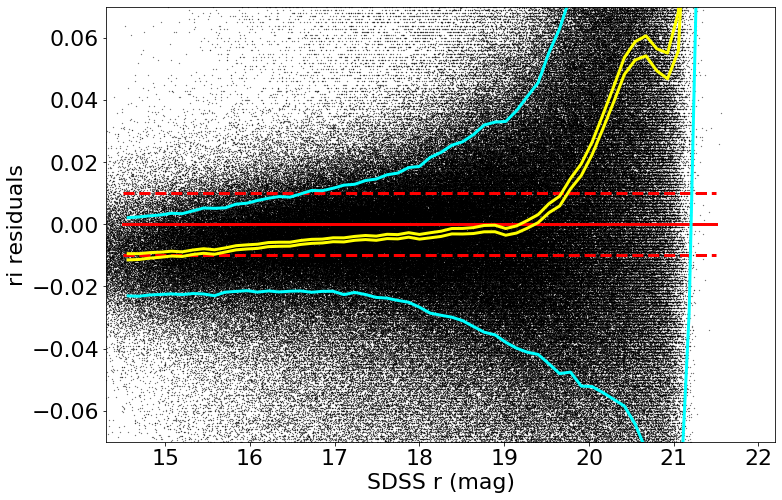

medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.003515576171875312 std.dev: 0.04914747645701013
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


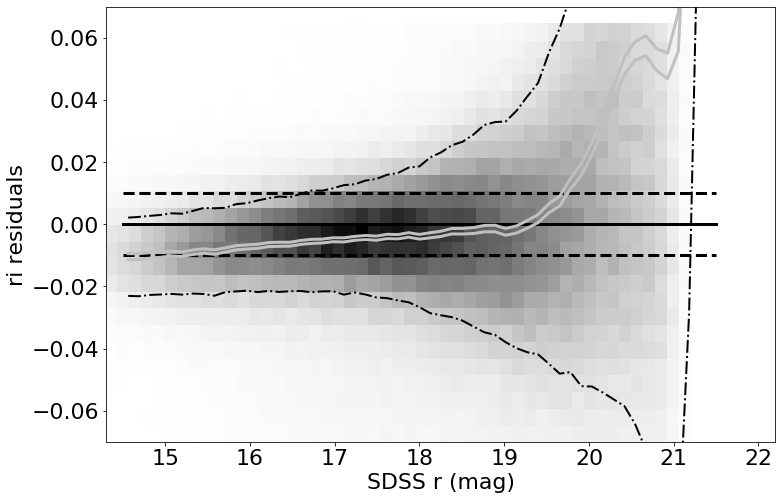

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.003555967712403657 std.dev: 0.02118917878942978
saved plot as: colorResidGaiaColors_ri_Gmag.png


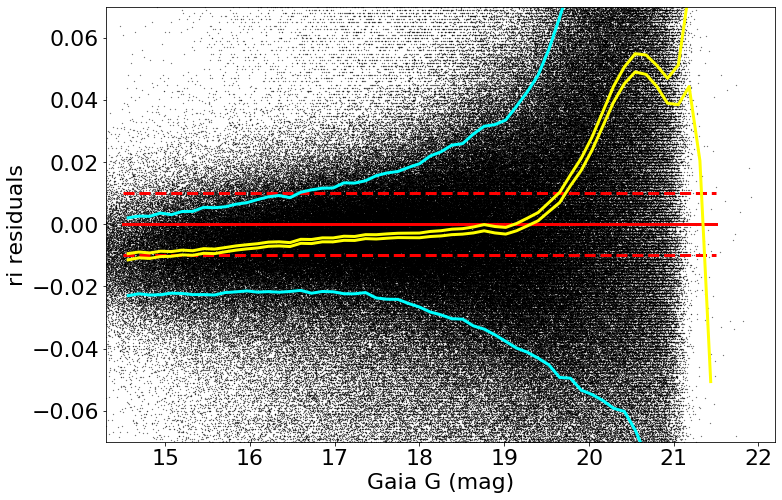

medianAll: 0.0001617935180659169 std.dev.All: 0.044095922241212594
N= 640545 min= -0.2999475311279294 max= 0.29999999999999893
median: -0.003555967712403657 std.dev: 0.02118917878942978
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


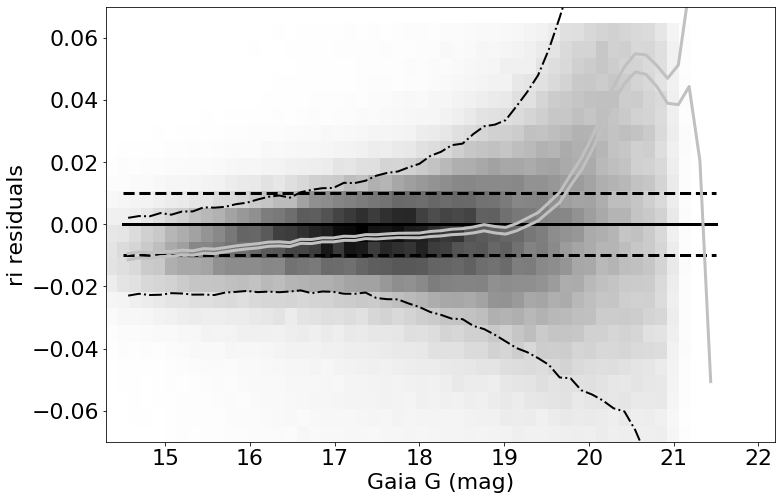

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.005262583923340336 std.dev: 0.00203972187794351
saved plot as: colorResidGaiaColors_rz_RA.png


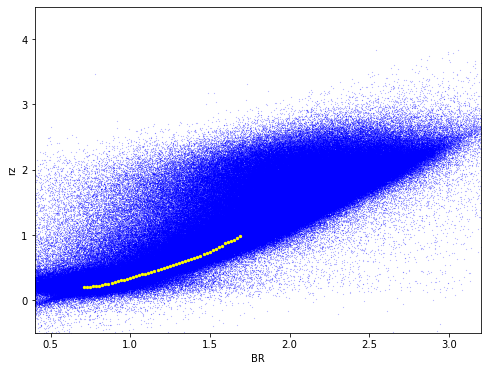

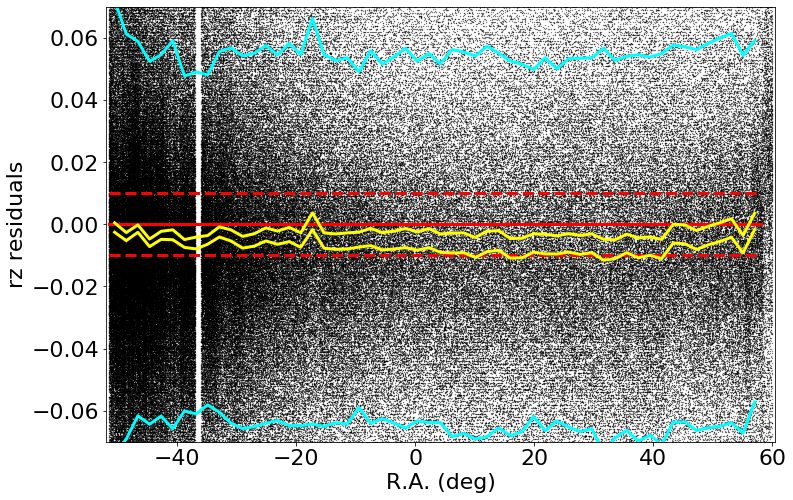

medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.004999999999999005 std.dev: 0.002086128648500309
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


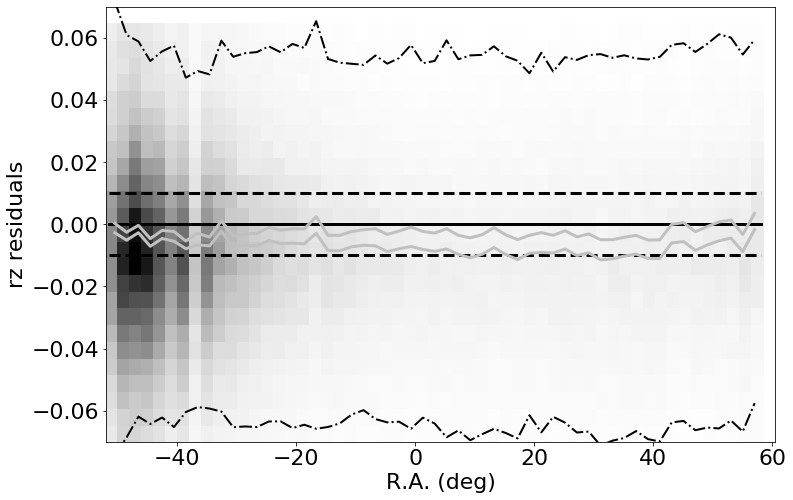

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.004131965637206761 std.dev: 0.0008413173527941903
saved plot as: colorResidGaiaColors_rz_Dec.png


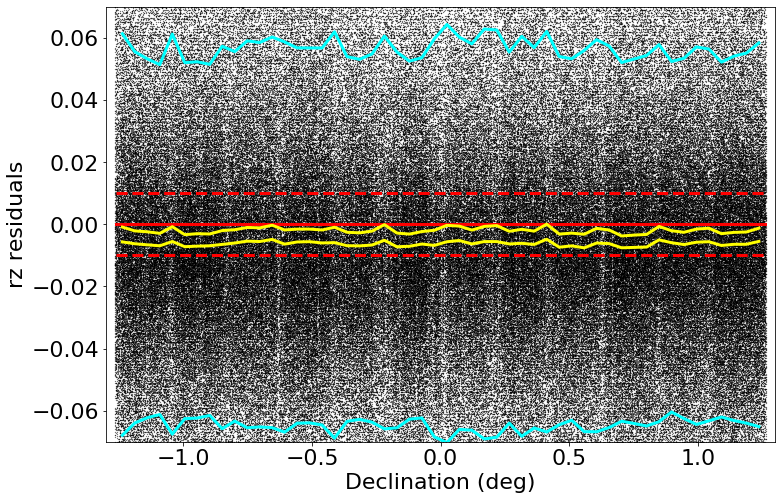

medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.0041460739135749936 std.dev: 0.0009184092743019761
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


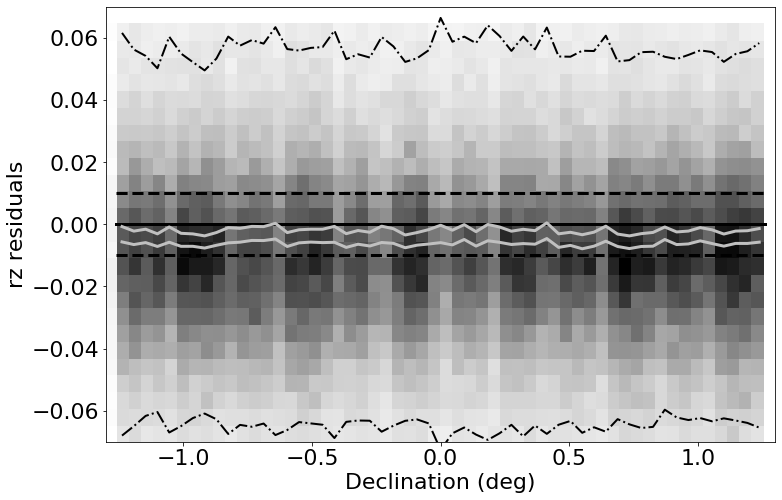

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.007792930603029186 std.dev: 0.05022191340205869
saved plot as: colorResidGaiaColors_rz_rmag.png


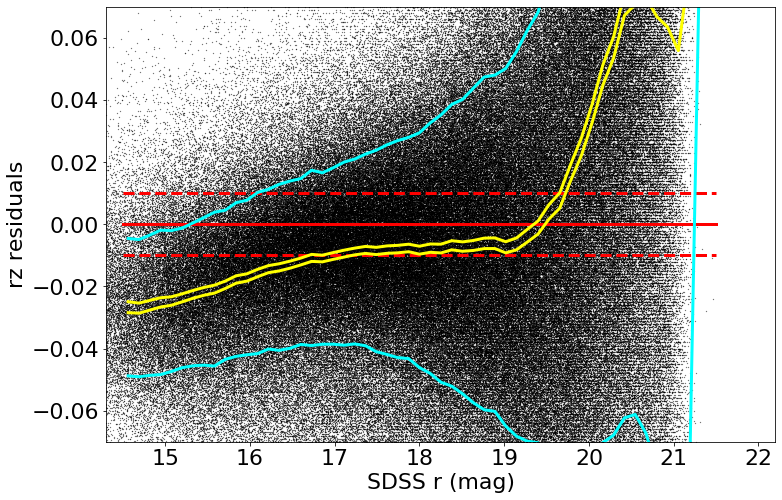

medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.007792930603029186 std.dev: 0.05022191340205869
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


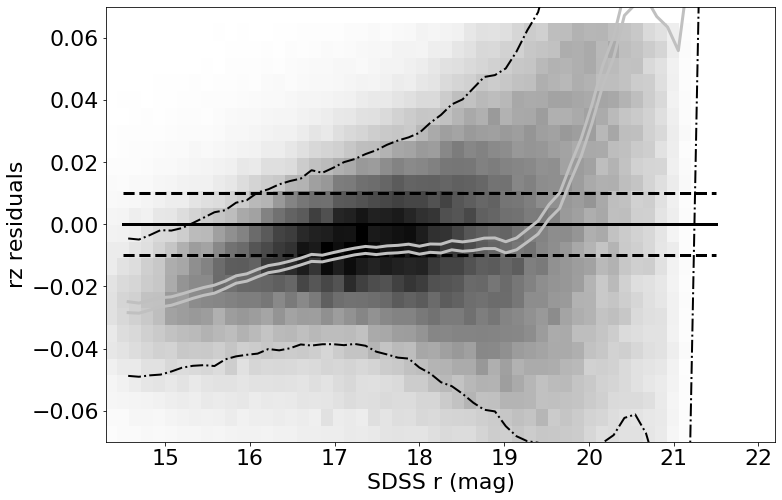

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.007572084045409655 std.dev: 0.03048090020552889
saved plot as: colorResidGaiaColors_rz_Gmag.png


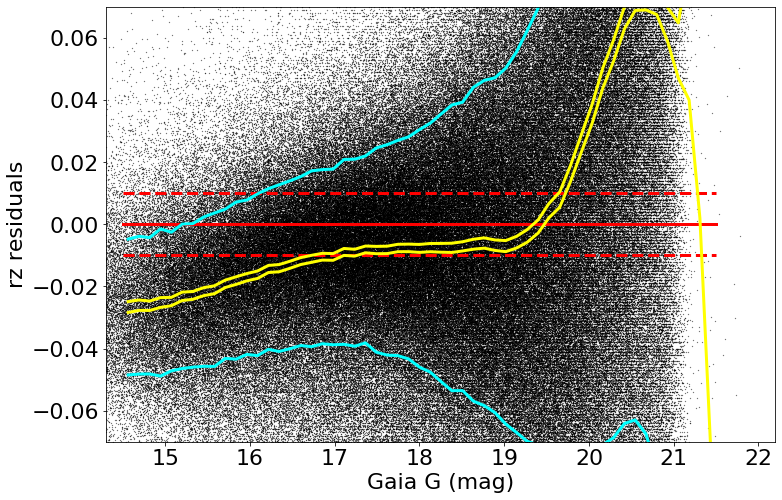

medianAll: -0.004105126953125815 std.dev.All: 0.06060622616501071
N= 585563 min= -0.29999999999999716 max= 0.29999999999999893
median: -0.007572084045409655 std.dev: 0.03048090020552889
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


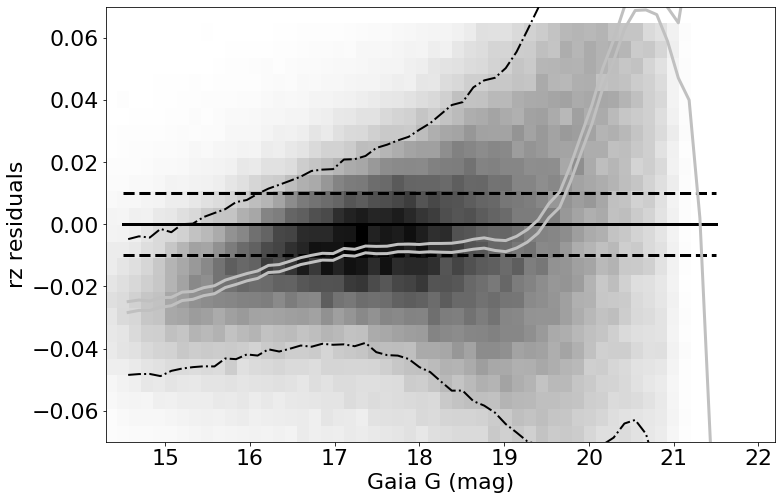

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [38]:
keywords = {"Xstr":'BR', "plotNameRoot":'colorResidGaiaColors_', "symbSize":0.05}
for color in ('ur', 'gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matches, keywords)

In [39]:
matchesB = matches[(matches['Gmag']>16)&(matches['Gmag']<19)]
matchesRecalib = matchesB[(matchesB['BR']>0.7)&(matchesB['BR']<1.7)]
matchesRecalibUR = matchesRecalib[(matchesRecalib['u_mMed_new']<20.0)]
print(np.size(matches), np.size(matches), np.size(matchesRecalib), np.size(matchesRecalibUR))

905428 905428 217883 109816


=========== WORKING ON: ur ===================
 stats for RA binning medians:
medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.01161639747619514 std.dev: 0.03396142827838578
saved plot as: colorResidGaiaColors_ur_RA.png


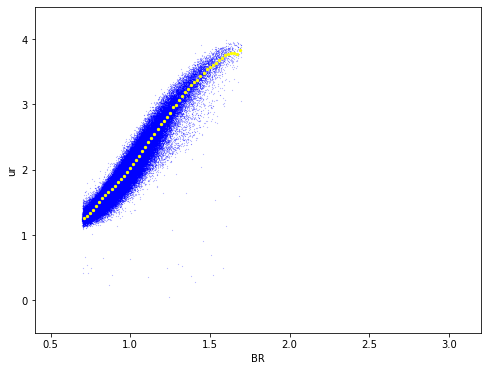

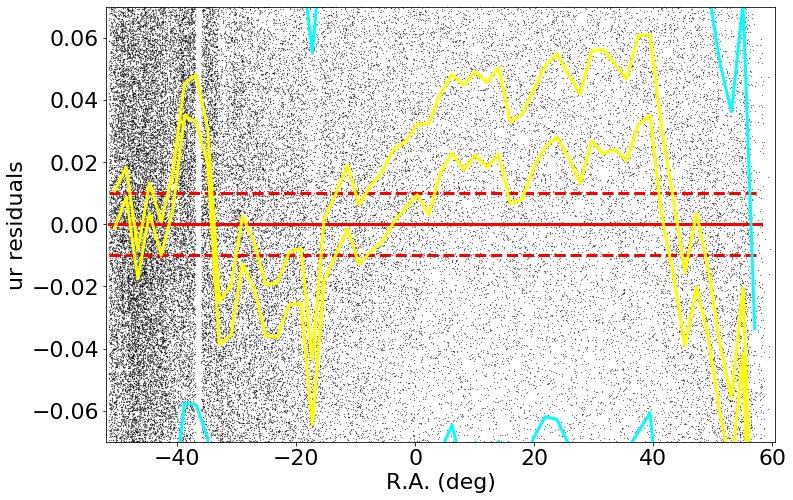

medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.012059953308107385 std.dev: 0.03411169311351775
saved plot as: colorResidGaiaColors_ur_RA_Hess.png


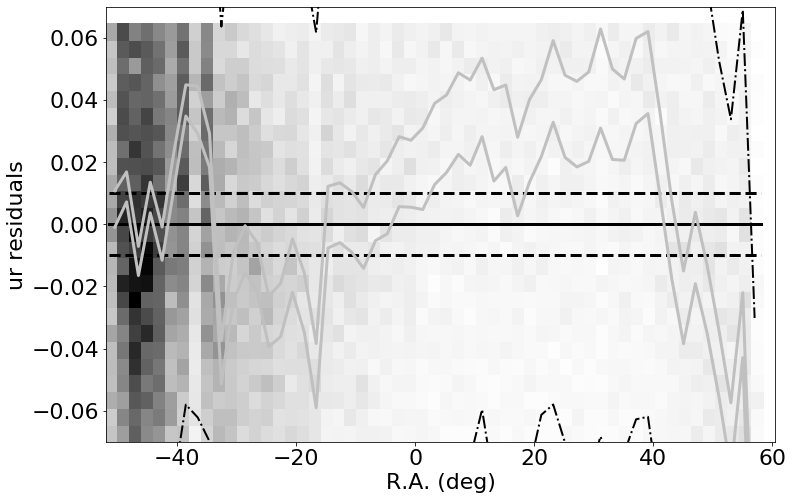

made plot colorResidGaiaColors_ur_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.001342221450806036 std.dev: 0.004323189555765486
saved plot as: colorResidGaiaColors_ur_Dec.png


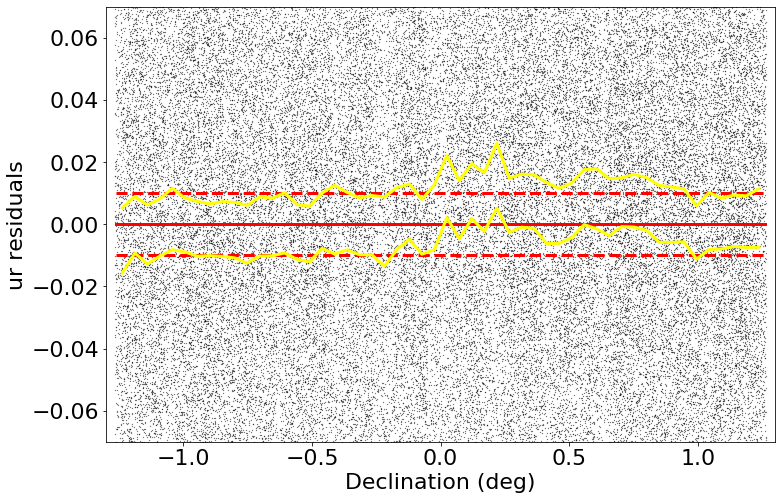

medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: 0.001706227111813785 std.dev: 0.004897513472302657
saved plot as: colorResidGaiaColors_ur_Dec_Hess.png


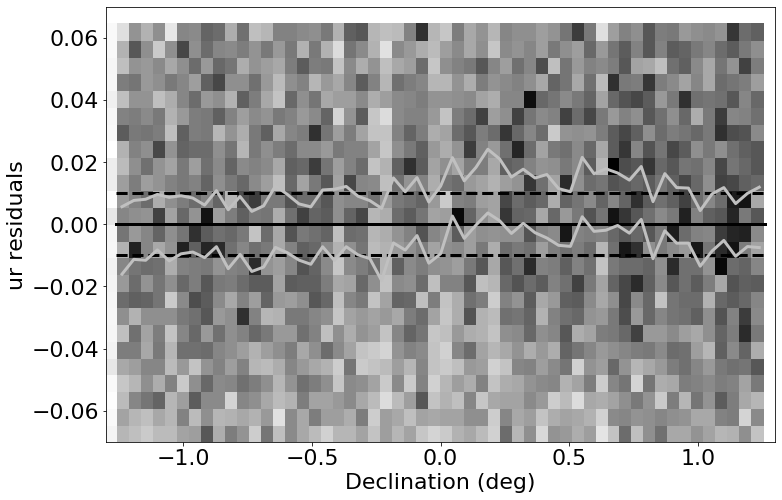

made plot colorResidGaiaColors_ur_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.005409362792969885 std.dev: 0.0642030278197831
saved plot as: colorResidGaiaColors_ur_rmag.png


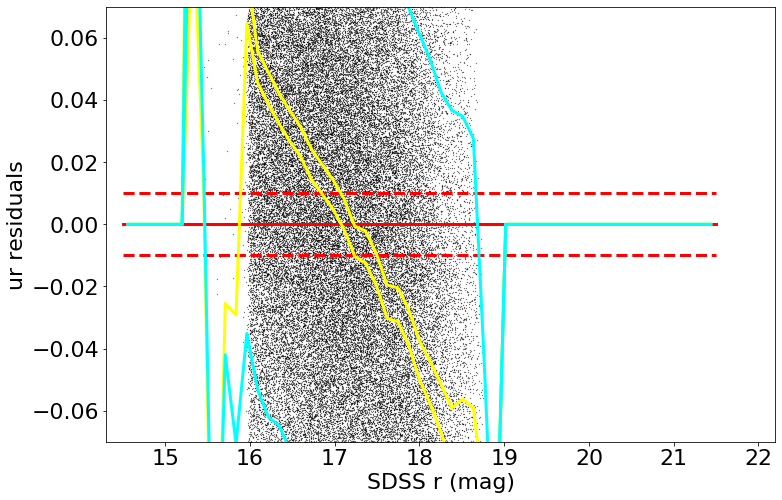

medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.005409362792969885 std.dev: 0.0642030278197831
saved plot as: colorResidGaiaColors_ur_rmag_Hess.png


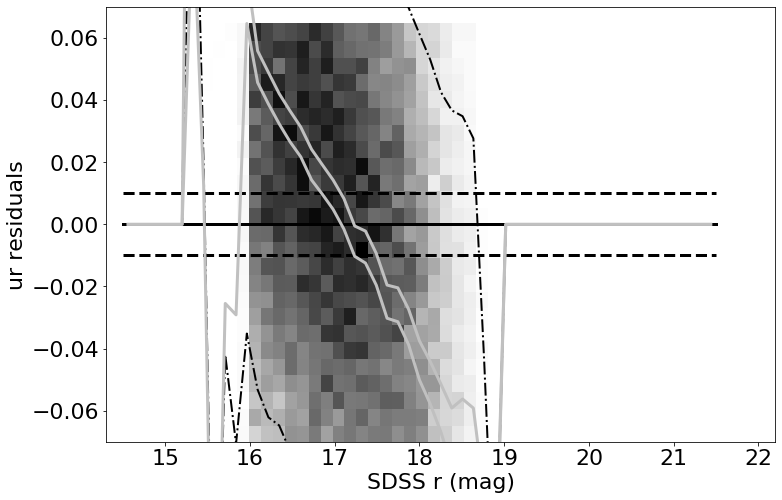

made plot colorResidGaiaColors_ur_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.007498953247070839 std.dev: 0.05192539314811005
saved plot as: colorResidGaiaColors_ur_Gmag.png


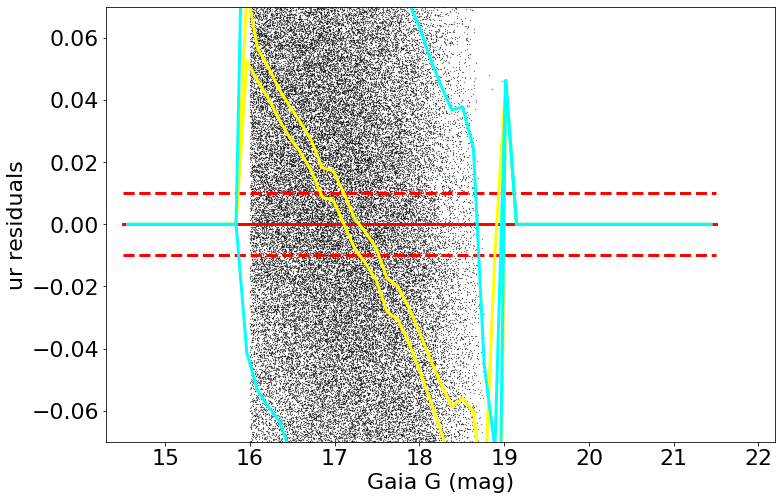

medianAll: 0.0023559539794921758 std.dev.All: 0.10898540692005343
N= 105502 min= -0.2999991622924818 max= 0.2999494113922099
median: -0.007498953247070839 std.dev: 0.05192539314811005
saved plot as: colorResidGaiaColors_ur_Gmag_Hess.png


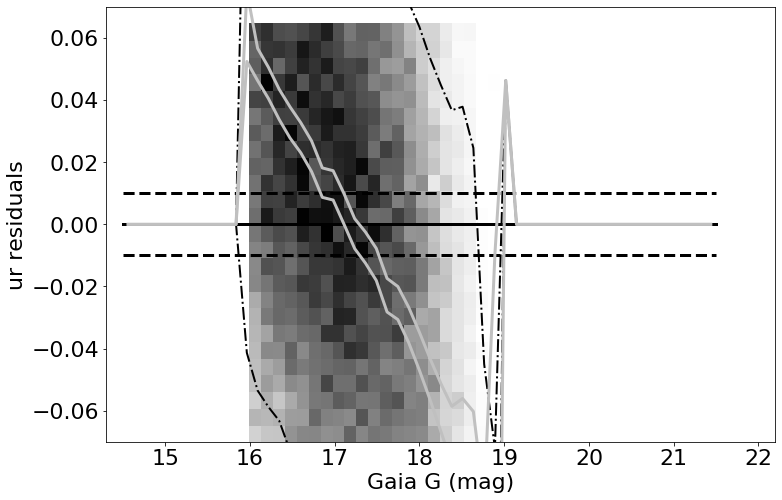

made plot colorResidGaiaColors_ur_Gmag_Hess.png
------------------------------------------------------------------


In [40]:
keywords["Ystr"] = 'ur'
doOneColorGaiaBR(matchesRecalibUR, keywords)

=========== WORKING ON: gr ===================
 stats for RA binning medians:
medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: 0.0008656185150143769 std.dev: 0.0015797318844379766
saved plot as: colorResidGaiaColors_gr_RA.png


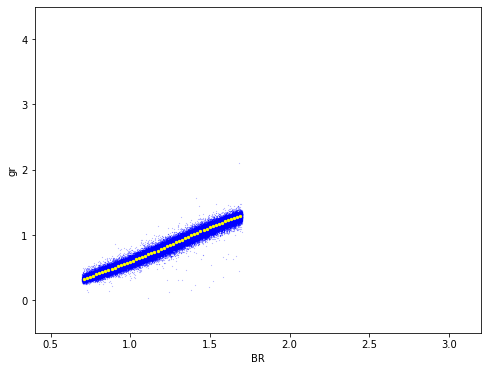

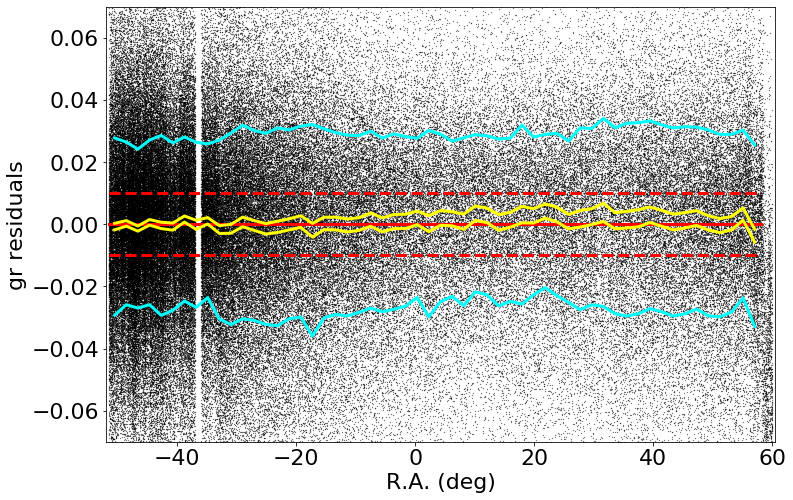

medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: 0.0007903350830059663 std.dev: 0.0016225306969910084
saved plot as: colorResidGaiaColors_gr_RA_Hess.png


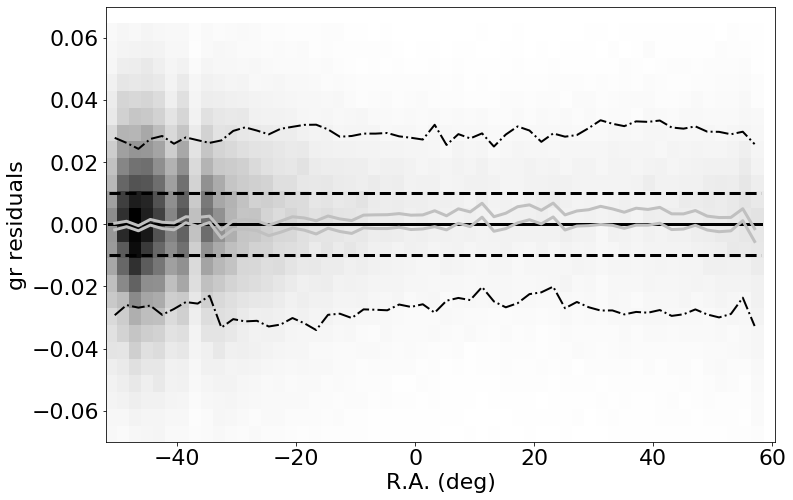

made plot colorResidGaiaColors_gr_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: 0.00012517890930349718 std.dev: 0.0007643607947734498
saved plot as: colorResidGaiaColors_gr_Dec.png


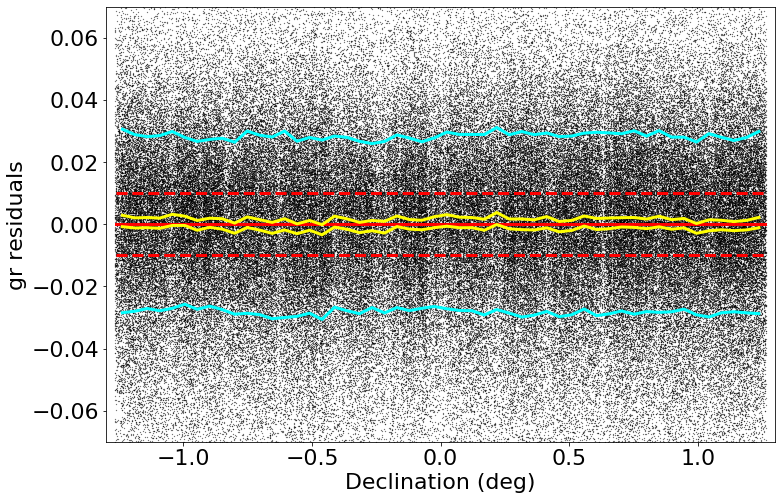

medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: 0.00015106239318715686 std.dev: 0.0007992975840100716
saved plot as: colorResidGaiaColors_gr_Dec_Hess.png


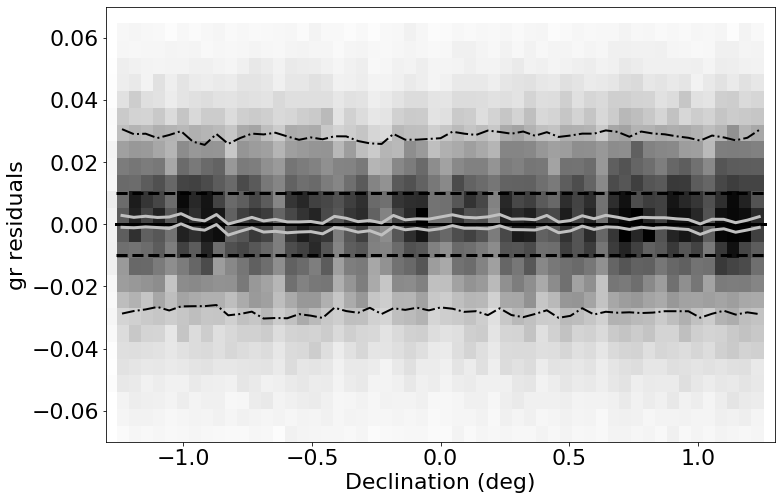

made plot colorResidGaiaColors_gr_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: -0.0004853034973135162 std.dev: 0.04592846998363823
saved plot as: colorResidGaiaColors_gr_rmag.png


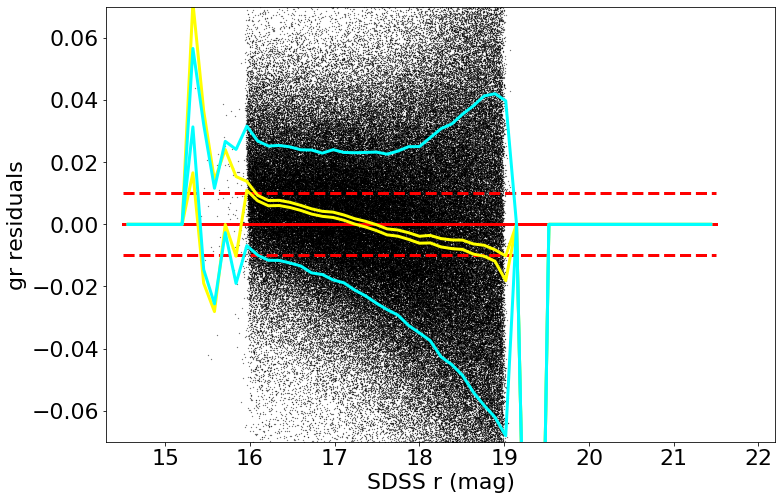

medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: -0.0004853034973135162 std.dev: 0.04592846998363823
saved plot as: colorResidGaiaColors_gr_rmag_Hess.png


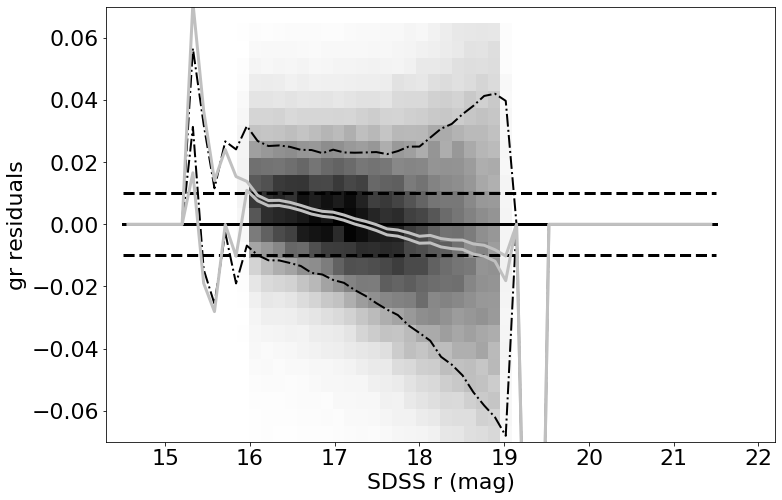

made plot colorResidGaiaColors_gr_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: -0.0006471832275403155 std.dev: 0.0060579105117760735
saved plot as: colorResidGaiaColors_gr_Gmag.png


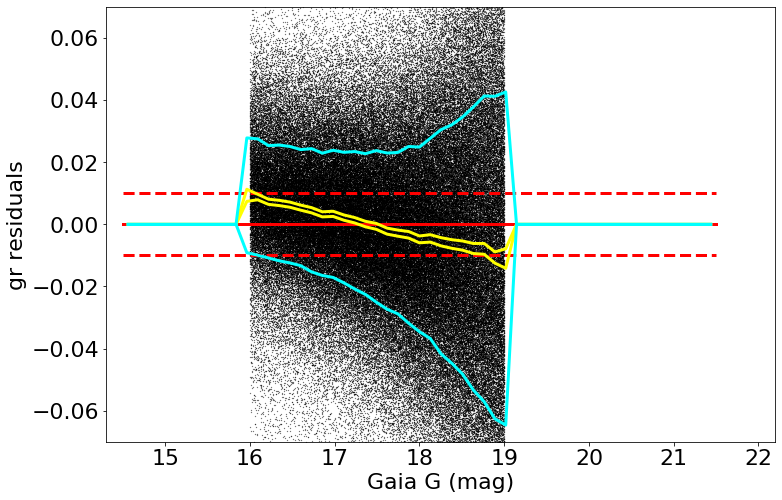

medianAll: 7.707366943565663e-05 std.dev.All: 0.028370004061886892
N= 217828 min= -0.2967107742309565 max= 0.2788063781738318
median: -0.0006471832275403155 std.dev: 0.0060579105117760735
saved plot as: colorResidGaiaColors_gr_Gmag_Hess.png


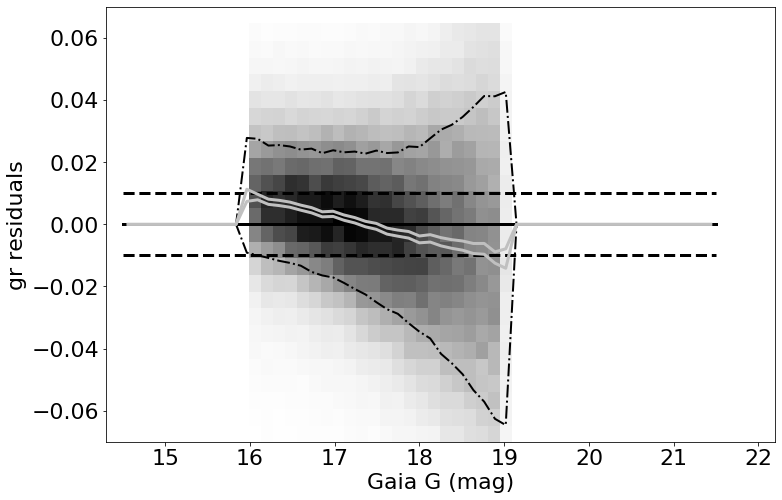

made plot colorResidGaiaColors_gr_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: ri ===================
 stats for RA binning medians:
medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 0.0015268280029271802 std.dev: 0.0019545455242630234
saved plot as: colorResidGaiaColors_ri_RA.png


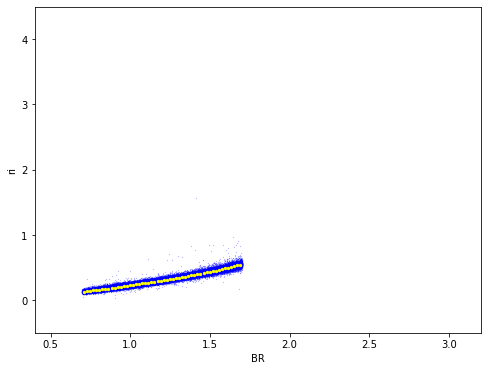

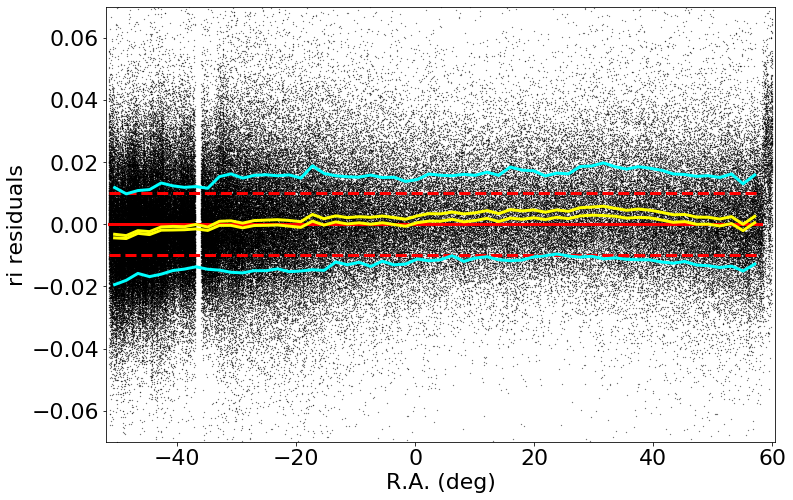

medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 0.0014821380615234747 std.dev: 0.0019574630450324925
saved plot as: colorResidGaiaColors_ri_RA_Hess.png


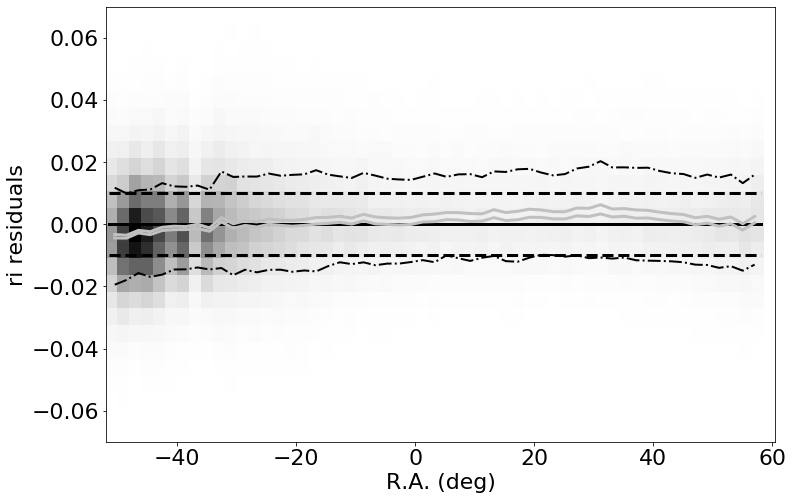

made plot colorResidGaiaColors_ri_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 5.280303953816845e-06 std.dev: 0.0005780989205667466
saved plot as: colorResidGaiaColors_ri_Dec.png


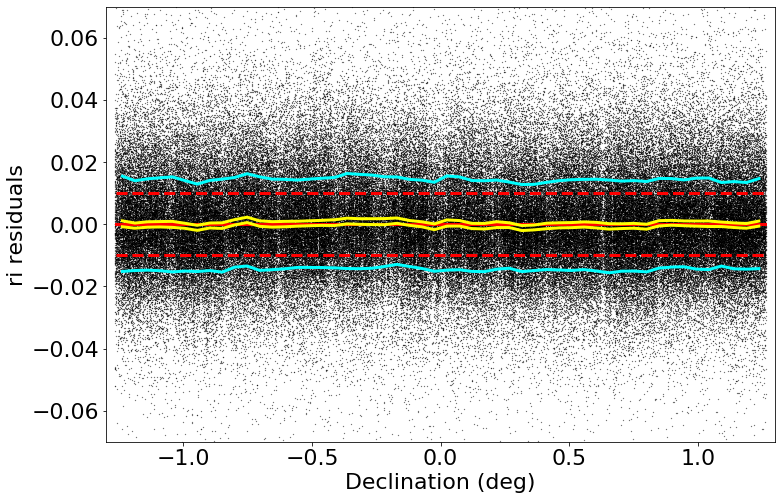

medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 0.0 std.dev: 0.000638259057304247
saved plot as: colorResidGaiaColors_ri_Dec_Hess.png


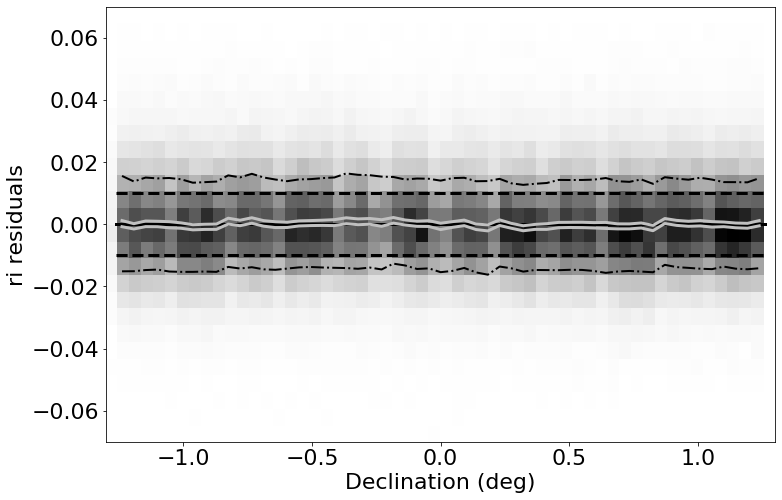

made plot colorResidGaiaColors_ri_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 0.0003117835998521501 std.dev: 0.05469142838166186
saved plot as: colorResidGaiaColors_ri_rmag.png


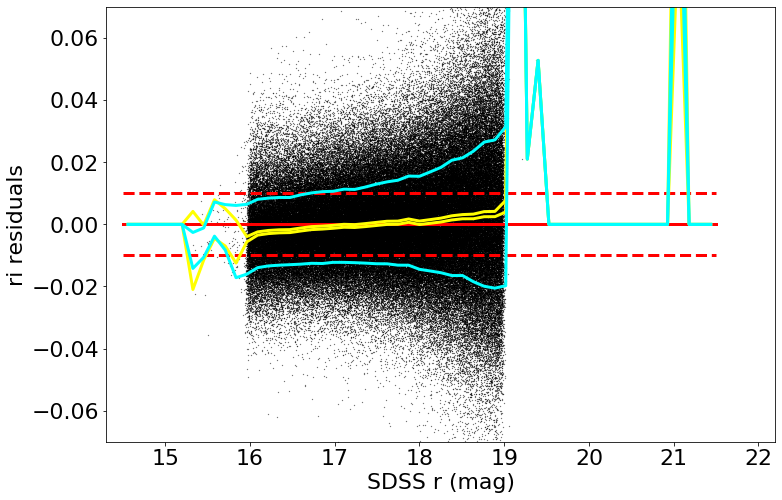

medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 0.0003117835998521501 std.dev: 0.05469142838166186
saved plot as: colorResidGaiaColors_ri_rmag_Hess.png


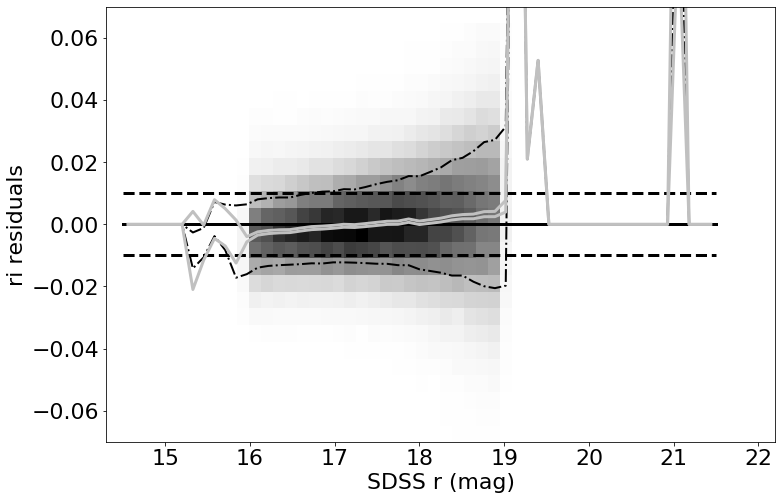

made plot colorResidGaiaColors_ri_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 1.9188690183982726e-05 std.dev: 0.0019391191105517442
saved plot as: colorResidGaiaColors_ri_Gmag.png


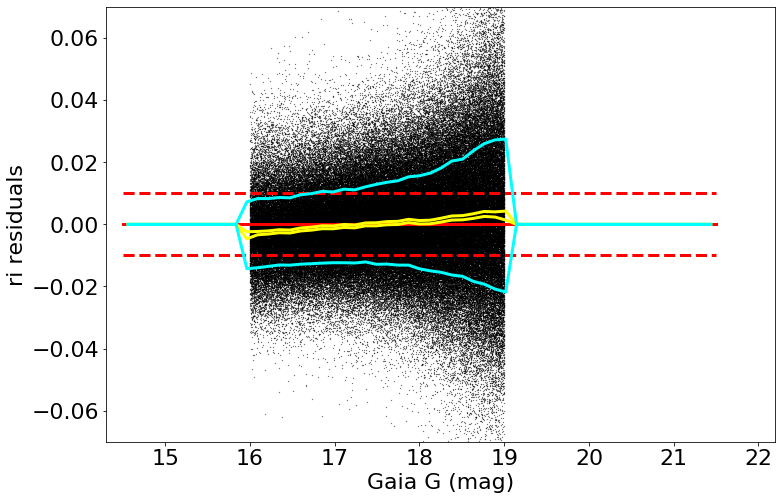

medianAll: -2.0721435545573152e-05 std.dev.All: 0.01450259118690489
N= 217826 min= -0.19547155914306752 max= 0.296774383544926
median: 1.9188690183982726e-05 std.dev: 0.0019391191105517442
saved plot as: colorResidGaiaColors_ri_Gmag_Hess.png


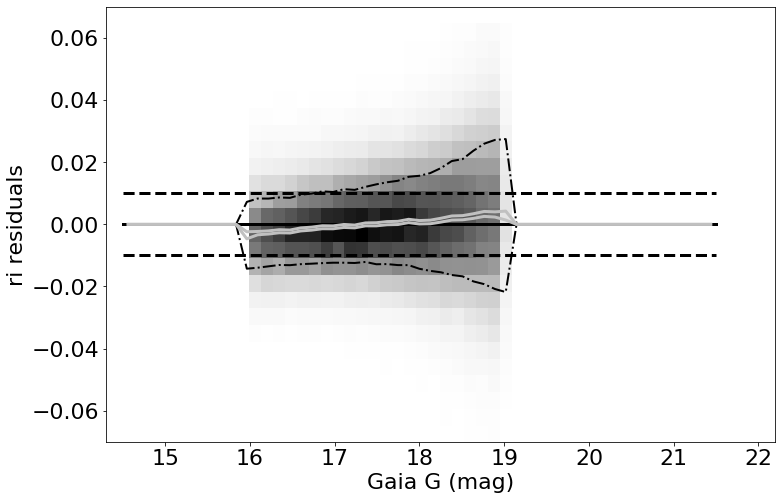

made plot colorResidGaiaColors_ri_Gmag_Hess.png
------------------------------------------------------------------
=========== WORKING ON: rz ===================
 stats for RA binning medians:
medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.002593775939941187 std.dev: 0.00278136993350414
saved plot as: colorResidGaiaColors_rz_RA.png


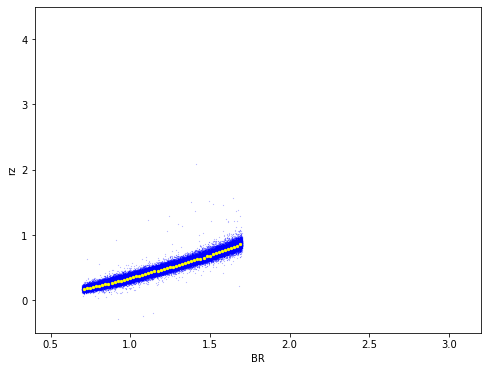

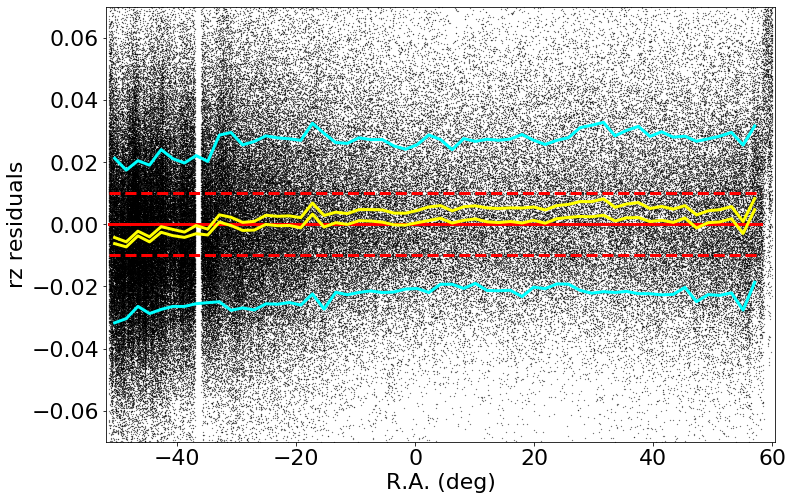

medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.0028885269165016547 std.dev: 0.0027684738799512425
saved plot as: colorResidGaiaColors_rz_RA_Hess.png


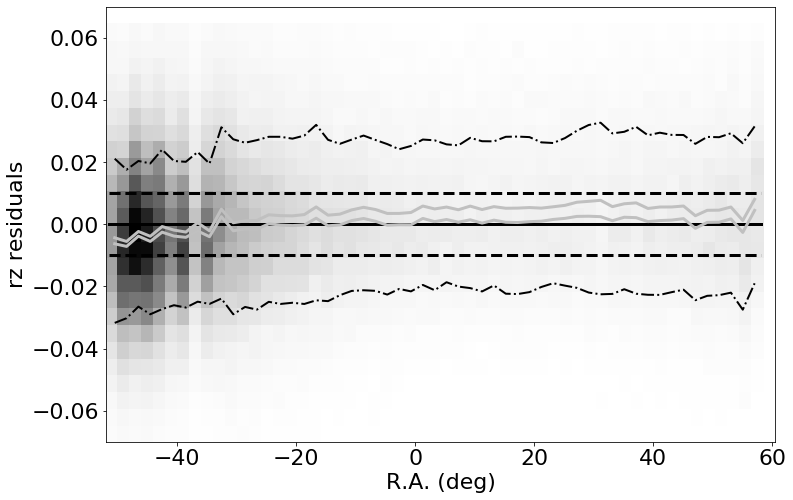

made plot colorResidGaiaColors_rz_RA_Hess.png
-----------
 stats for Dec binning medians:
medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.00025729675292804344 std.dev: 0.0014130920190515107
saved plot as: colorResidGaiaColors_rz_Dec.png


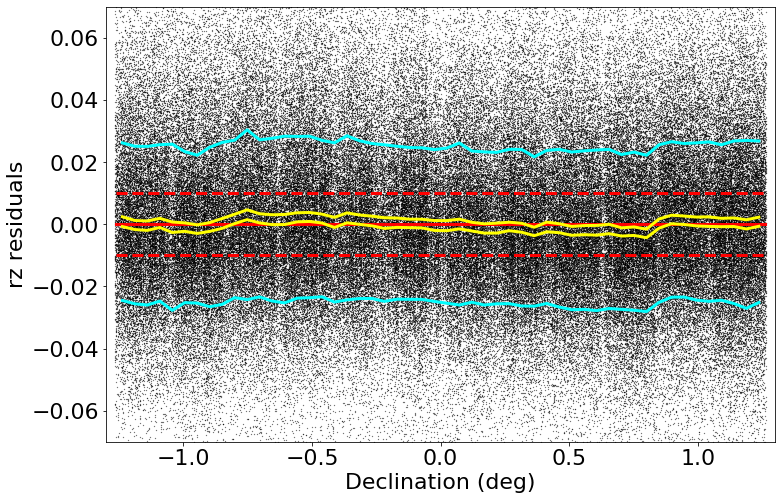

medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.00015320129394266746 std.dev: 0.0015037579993263208
saved plot as: colorResidGaiaColors_rz_Dec_Hess.png


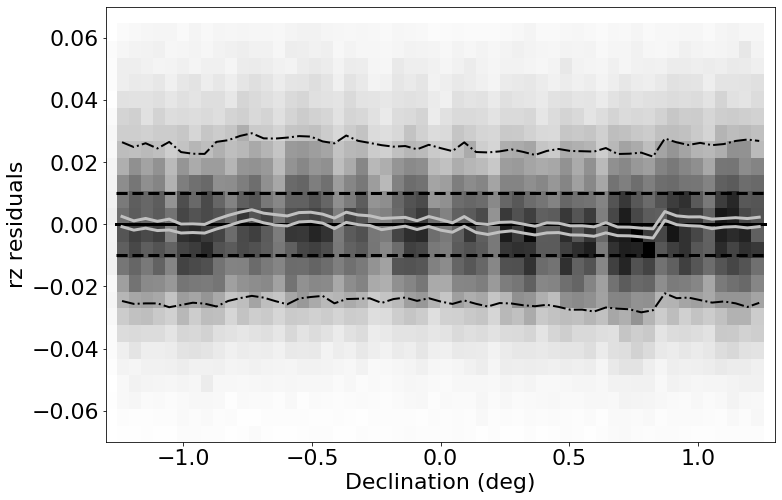

made plot colorResidGaiaColors_rz_Dec_Hess.png
-----------
 stats for SDSS r binning medians:
medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: -0.0005596328735347211 std.dev: 0.014182685036011047
saved plot as: colorResidGaiaColors_rz_rmag.png


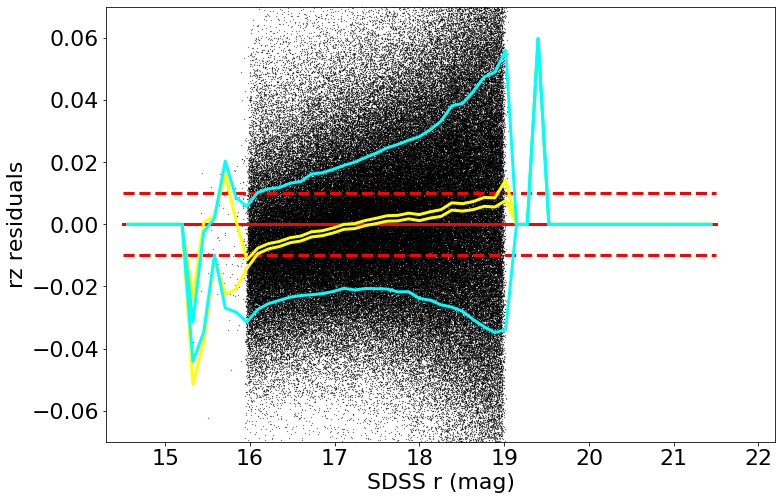

medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: -0.0005596328735347211 std.dev: 0.014182685036011047
saved plot as: colorResidGaiaColors_rz_rmag_Hess.png


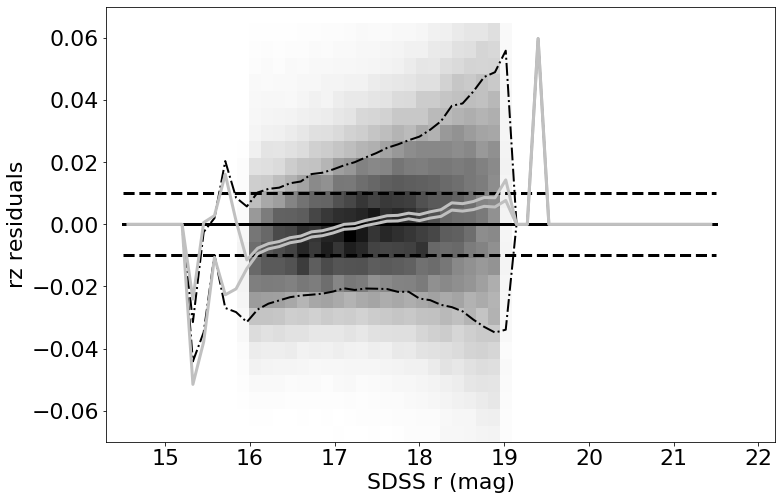

made plot colorResidGaiaColors_rz_rmag_Hess.png
------------------------------------------------------------------
-----------
 stats for SDSS r binning medians:
medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.001042289733887869 std.dev: 0.005090447607534571
saved plot as: colorResidGaiaColors_rz_Gmag.png


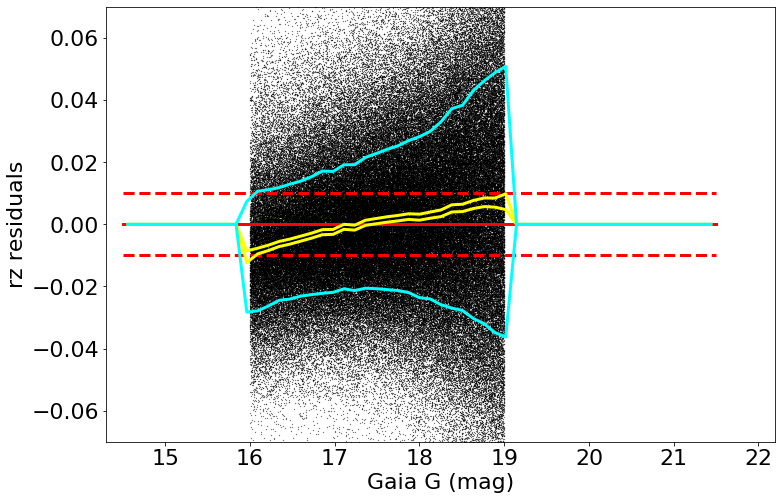

medianAll: -7.324218742887911e-07 std.dev.All: 0.02536983429336424
N= 217811 min= -0.25013491210937366 max= 0.29930627746581895
median: 0.001042289733887869 std.dev: 0.005090447607534571
saved plot as: colorResidGaiaColors_rz_Gmag_Hess.png


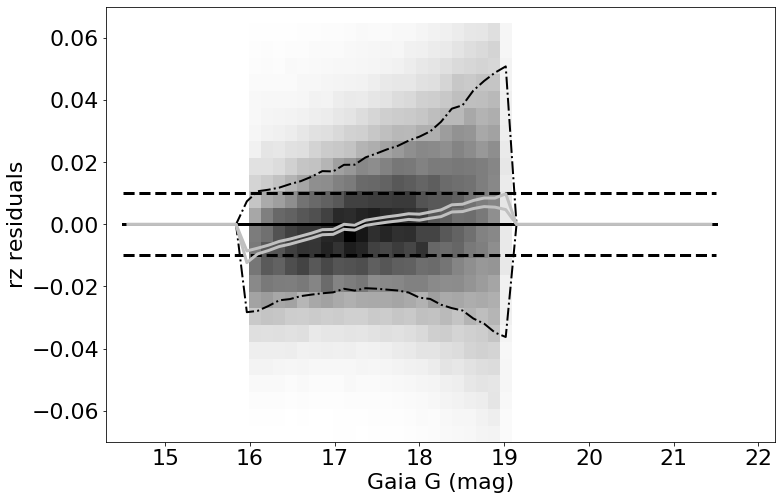

made plot colorResidGaiaColors_rz_Gmag_Hess.png
------------------------------------------------------------------


In [41]:
for color in ('gr', 'ri', 'rz'):
    keywords["Ystr"] = color 
    doOneColorGaiaBR(matchesRecalib, keywords)

<a id='dataReading'></a>

### Correct v4.3 for offsets in the ugriz bands relative to v2.6

In [4]:
ZIdataDir = "/Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data"
sdssNewCat = ZIdataDir + "/" + "stripe82calibStars_v4.2temp_noheader_final.dat"
sdssNew = Table.read(sdssNewCat, format='ascii', names=colnamesSDSS)
np.size(sdssNew)

991472

In [5]:
sdssOut = sdssNew[sdssNew['ra']<1000] 
print(np.size(sdssOut))

991472


In [6]:
## apply offset corrections 
offset = {}
offset['u'] =  0.003 
offset['g'] =  0.017 
offset['r'] =  0.000 
offset['i'] = -0.011 
offset['z'] = -0.018 
for mtype in ('_mMed', '_mMean'):
    for band in ('u', 'g', 'r', 'i', 'z'):
        mstr = band + mtype
        sdssOut[mstr] = sdssOut[mstr] - offset[band]

In [7]:
SSCindexRoot = 'CALIBSTARS_'
outFile = ZIdataDir + "/" + "stripe82calibStars_v4.3_noheader_final.dat"
newSSC = open(outFile,'w')
df = sdssOut
Ngood = 0
for i in range(0, np.size(df)):
    Ngood += 1
    NoldCat = df['calib_fla'][i]
    strNo = f'{Ngood:07}'
    SSCindex = SSCindexRoot + strNo 
    SSCrow = zit.getSSCentry(df, i, aux='')
    zit.SSCentryToOutFileRow(SSCrow, SSCindex, newSSC) 
newSSC.close()
print(Ngood, 'rows in file', outFile)

991472 rows in file /Users/ivezic/Work/Science/CalibrationV2/SDSS_SSC/Data/stripe82calibStars_v4.3_noheader_final.dat


In [ ]:
# execute this in /Data dir
# instead of v4.4, call it v4.2 so that readers don't wonder about v4.2 and v4.3 
# cat header_v4.2.txt stripe82calibStars_v4.3_noheader_final.dat > stripe82calibStars_v4.2.dat
# also
# cat header_v4.1.txt stripe82calibStars_v4.1_noheader_final.dat > stripe82calibStars_v4.1.dat